# Churn Prediction

---

Author- David H.

####  Introduction

We aim to accomplist the following for this study:

1. Identify and visualize which factors contribute to customer churn:

2. Build a prediction model that will perform the following:

3. Classify if a customer is going to churn or not

Preferably and based on model performance, choose a model that will attach a probability to the churn to make it easier for customer service to target low hanging fruits in their efforts to prevent churn

#### Import the required libraries

In [191]:
import os
import glob

import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline 
import plotly.graph_objs as go
import plotly.figure_factory as ff
from plotly import tools
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)

import warnings
warnings.filterwarnings('ignore')


# Matplotlib
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import matplotlib.patches as patches
from matplotlib.colors import ListedColormap
from matplotlib.colorbar import ColorbarBase

# Scipy
from scipy import interpolate
from scipy import spatial
from scipy import stats
from scipy.cluster import hierarchy
# Others
import numpy as np
import pandas as pd
import datetime as dt
import seaborn as sns
import pickle
from math import modf

from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.pipeline import Pipeline
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import train_test_split
from sklearn.ensemble import BaggingClassifier
from collections import Counter

from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, GradientBoostingClassifier, ExtraTreesClassifier, VotingClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV, cross_val_score, StratifiedKFold, learning_curve
from sklearn.metrics import confusion_matrix #for confusion matrix
from sklearn.model_selection import cross_val_predict
from sklearn.ensemble import VotingClassifier
from sklearn.metrics import precision_score, recall_score, confusion_matrix, classification_report, accuracy_score, f1_score
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)

from sklearn import metrics
import xgboost as xgb
from sklearn.linear_model import SGDClassifier


sns.set(style='white', context='notebook', palette='deep')
from sklearn.model_selection import train_test_split, KFold, cross_validate

#Models
import warnings
warnings.filterwarnings("ignore")


from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

# Display all columns
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

from sklearn.preprocessing import MinMaxScaler

from sklearn.model_selection import StratifiedShuffleSplit, KFold, GridSearchCV, RandomizedSearchCV
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.pipeline import Pipeline
from sklearn.metrics import accuracy_score, classification_report, precision_recall_curve, precision_recall_fscore_support, roc_auc_score
from sklearn.inspection import plot_partial_dependence

from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier, AdaBoostClassifier, GradientBoostingClassifier
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB, BernoulliNB
from sklearn.neighbors import KNeighborsClassifier
from xgboost import XGBClassifier  
from sklearn.exceptions import ConvergenceWarning

pd.options.display.float_format = '{:.5f}'.format
import numpy as np
import matplotlib.pyplot as plt
plt.style.context('seaborn-talk')
plt.style.use('fivethirtyeight')
params = {'legend.fontsize': '16',
          'figure.figsize': (15, 5),
         'axes.labelsize': '20',
         'axes.titlesize':'30',
         'xtick.labelsize':'18',
         'ytick.labelsize':'18'}
plt.rcParams.update(params)

plt.rcParams['text.color'] = '#A04000'
plt.rcParams['xtick.color'] = '#283747'
plt.rcParams['ytick.color'] = '#808000'
plt.rcParams['axes.labelcolor'] = '#283747'

# Seaborn style (figures)
sns.set(context='notebook', style='whitegrid')
sns.set_style('ticks', {'xtick.direction':'in', 'ytick.direction':'in'})
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
import pandas as pd
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

from sklearn import metrics

from sklearn import model_selection
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import average_precision_score

In [192]:
observation_window1 = pd.read_csv('new_data/features_201506.csv')
observation_window2 = pd.read_csv('new_data/features_201512.csv')
outcome_window = pd.read_csv('new_data/features_201606.csv')

In [193]:
print('Shape of Observation Window 1 : ', observation_window1.shape)
print('Shape of Observation Window 2 : ', observation_window2.shape)
print('Shape of Outcome Window 1 : ', outcome_window.shape)

Shape of Observation Window 1 :  (269521, 88)
Shape of Observation Window 2 :  (265875, 88)
Shape of Outcome Window 1 :  (261846, 88)


In [194]:
features = pd.concat([observation_window1, observation_window2], axis=0, ignore_index=True)

In [195]:
features = features.drop_duplicates()

In [196]:
features = features[features['acc_balance']>1500]
features = features[features['acc_tenure']>6]
features = features.reset_index(drop = True)
features.drop(['churn'], axis = 1, inplace = True)
print('Shape of Features : ', features.shape)

Shape of Features :  (257411, 87)


In [197]:
outcome_window = outcome_window[['new_id', 'churn']]
df = pd.merge(features, outcome_window, on = 'new_id')

new_id                       0.00000
group_no                     0.00000
postcode                     0.00000
channel                      0.00000
gender                       0.00000
age                          0.00000
num_accounts                 0.00000
acc_tenure                   0.00000
acc_balance                  0.00000
num_options                  0.00000
stmt_pref                    0.00000
annualrpt_pref               0.00000
promotional_pref             0.00000
returned_mail_count          0.00000
rb_flag                      0.00000
block_flag                   0.00000
has_email                    0.00000
has_work_tel                 0.00000
has_home_tel                 0.00000
has_mobile                   0.00000
num_contacts                 0.00000
num_accounts_change_amount   0.00000
acc_balance_change_amount    0.00000
num_options_change_amount    0.00000
num_contacts_change_amount   0.00000
num_accounts_change_ratio    0.00000
acc_balance_change_ratio     0.00000
n

Text(0.5, 1.0, 'Percentage of Missing Values')

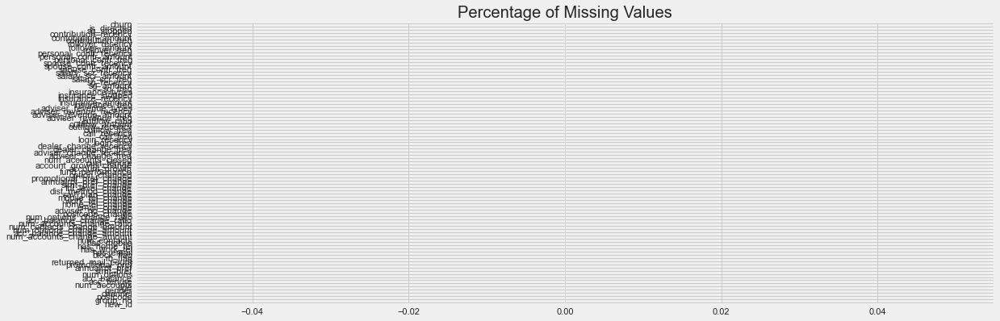

In [198]:
plt.style.use('fivethirtyeight')
display(df.isna().sum()/len(df)*100)
(df.isna().sum()/len(df)*100).plot(kind = 'barh', figsize = (17,6));
plt.title('Percentage of Missing Values')
plt.show()

0   86.14847
1   13.85153
Name: churn, dtype: float64

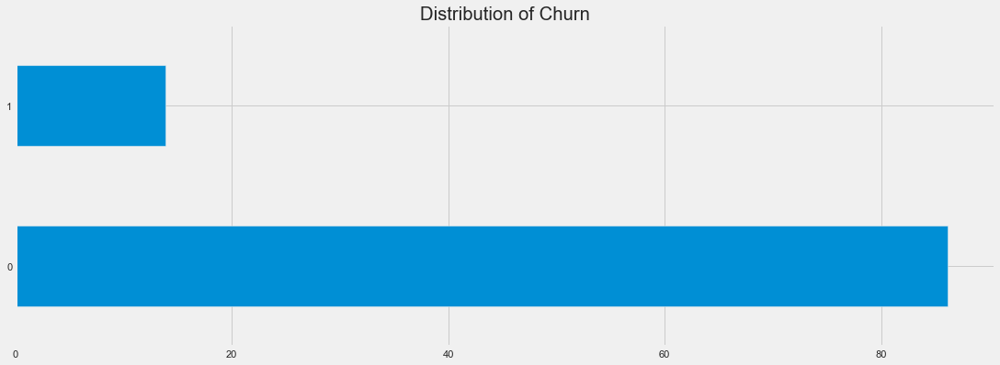

In [199]:
display(df['churn'].value_counts()/len(df)*100)
(df['churn'].value_counts()/len(df)*100).plot(kind = 'barh', figsize = (17,6));
plt.title('Distribution of Churn')
plt.show();

### Data Is Imbalanced

In [200]:
print("Shape of Combined Dataframe : ", df.shape)

Shape of Combined Dataframe :  (238277, 88)


## Feature Engineering

#### Dropping Duplicates

In [201]:
finalDF = df.copy()
finalDF = finalDF.drop_duplicates()
print("Shape of Combined Dataframe : ", finalDF.shape)

Shape of Combined Dataframe :  (238277, 88)


In [202]:
finalDF.drop_duplicates(subset='new_id', keep='last', inplace=True, ignore_index=False)
print("Shape of Combined Dataframe : ", finalDF.shape)

Shape of Combined Dataframe :  (124363, 88)


0   85.90980
1   14.09020
Name: churn, dtype: float64

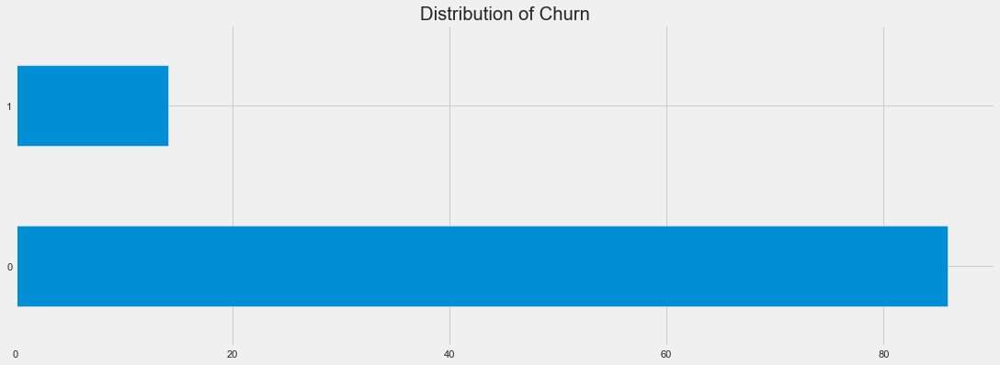

In [203]:
display(finalDF['churn'].value_counts()/len(finalDF)*100)
(finalDF['churn'].value_counts()/len(finalDF)*100).plot(kind = 'barh', figsize = (17,6));
plt.title('Distribution of Churn')
plt.show();

In [204]:
def summarize_categoricals(df, show_levels=False):
    """
        Display uniqueness in each column
    """
    data = [[df[c].unique(), len(df[c].unique()), df[c].isnull().sum()] for c in df.columns]
    df_temp = pd.DataFrame(data, index=df.columns,
                           columns=['Levels', 'No. of Levels', 'No. of Missing Values'])
    return df_temp.iloc[:, 0 if show_levels else 1:]


def find_categorical(df, cutoff=10):
    """
        Function to find categorical columns in the dataframe.
    """
    cat_cols = []
    for col in df.columns:
        if len(df[col].unique()) <= cutoff:
            cat_cols.append(col)
    return cat_cols


def to_categorical(columns, df):
    """
        Converts the columns passed in `columns` to categorical datatype
    """
    for col in columns:
        df[col] = df[col].astype('category')
    return df

In [205]:
finalDF.drop(['new_id'], axis = 1, inplace = True)
finalDF.drop(['postcode'], axis = 1, inplace = True)
finalDF.drop(['group_no'], axis = 1, inplace = True)

In [206]:
finalDF['churn'] = finalDF['churn'].astype(object)
finalDF['age'] = finalDF['age'].astype(float)
finalDF['num_accounts'] = finalDF['num_accounts'].astype(float)
finalDF['acc_tenure'] = finalDF['acc_tenure'].astype(float)
finalDF['acc_balance'] = finalDF['acc_balance'].astype(float)
finalDF['num_options'] = finalDF['num_options'].astype(float)
finalDF['acc_balance_change_amount'] = finalDF['acc_balance_change_amount'].astype(float)
finalDF['num_options_change_amount'] = finalDF['num_options_change_amount'].astype(float)
finalDF['acc_balance_change_ratio'] = finalDF['acc_balance_change_ratio'].astype(float)
finalDF['num_accounts_change_ratio'] = finalDF['num_accounts_change_ratio'].astype(float)
finalDF['num_options_change_ratio'] = finalDF['num_options_change_ratio'].astype(float)
finalDF['fund_performance'] = finalDF['fund_performance'].astype(float)
finalDF['account_growth'] = finalDF['account_growth'].astype(float)
finalDF['account_growth_change'] = finalDF['account_growth_change'].astype(float)
finalDF['cust_tenure'] = finalDF['cust_tenure'].astype(float)
finalDF['dealer_change_recency'] = finalDF['dealer_change_recency'].astype(float)
finalDF['login_freq'] = finalDF['login_freq'].astype(float)
finalDF['login_recency'] = finalDF['login_recency'].astype(float)
finalDF['call_freq'] = finalDF['call_freq'].astype(float)
finalDF['call_recency'] = finalDF['call_recency'].astype(float)
finalDF['outflow_freq'] = finalDF['outflow_freq'].astype(float)
finalDF['outflow_recency'] = finalDF['outflow_recency'].astype(float)
finalDF['outflow_amount'] = finalDF['outflow_amount'].astype(float)
finalDF['outflow_ratio'] = finalDF['outflow_ratio'].astype(float)
finalDF['adviser_revenue_freq'] = finalDF['adviser_revenue_freq'].astype(float)
finalDF['adviser_revenue_amount'] = finalDF['adviser_revenue_amount'].astype(float)
finalDF['sg_amount'] = finalDF['sg_amount'].astype(float)
finalDF['salary_scr_amount'] = finalDF['salary_scr_amount'].astype(float)
finalDF['spouse_contr_amount'] = finalDF['spouse_contr_amount'].astype(float)
finalDF['personal_contr_amount'] = finalDF['personal_contr_amount'].astype(float)
finalDF['rollover_amount'] = finalDF['rollover_amount'].astype(float)
finalDF['contribution_amount'] = finalDF['contribution_amount'].astype(float)                                                  

In [207]:
categoricals = find_categorical(finalDF, cutoff=12)

In [208]:
summarize_categoricals(finalDF[categoricals], show_levels=True)

,Levels,No. of Levels,No. of Missing Values
channel,"[Other Advisers, CBA Third Party, Count Financ...",6,0
gender,"[F, M]",2,0
num_accounts,"[1.0, 2.0, 5.0, 3.0, 7.0, 6.0, 4.0, 8.0, 10.0,...",11,0
stmt_pref,"[E, M, N]",3,0
annualrpt_pref,"[N, E, M]",3,0
promotional_pref,"[E, M, N]",3,0
returned_mail_count,"[0, 1, 2]",3,0
rb_flag,[0],1,0
block_flag,"[0, 1]",2,0
has_email,"[1, 0]",2,0


In [209]:
numericals = list(set(finalDF.columns.tolist()) - set(categoricals)) + list(set(categoricals) - set(finalDF.columns.tolist()))

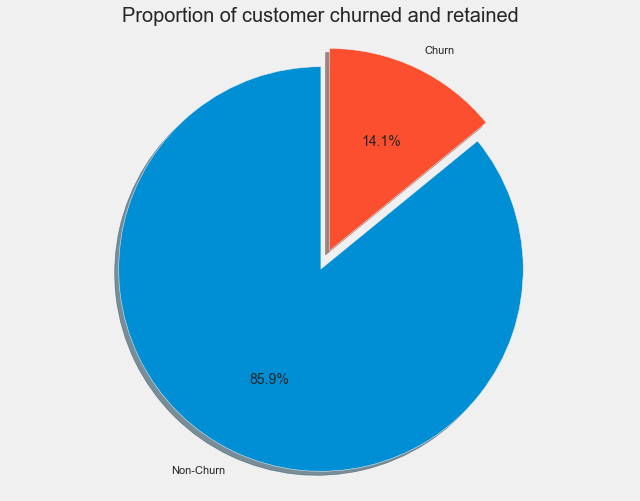

In [210]:
labels = 'Non-Churn', 'Churn'
sizes = [finalDF.churn[finalDF['churn']==0].count(), finalDF.churn[finalDF['churn']==1].count()]
explode = (0, 0.1)
fig1, ax1 = plt.subplots(figsize=(10, 8))
ax1.pie(sizes, explode=explode, labels=labels, autopct='%1.1f%%',
        shadow=True, startangle=90)
ax1.axis('equal')
plt.title("Proportion of customer churned and retained", size = 20)
plt.show();

In [211]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
finalDF.head()

,channel,gender,age,num_accounts,acc_tenure,acc_balance,num_options,stmt_pref,annualrpt_pref,promotional_pref,returned_mail_count,rb_flag,block_flag,has_email,has_work_tel,has_home_tel,has_mobile,num_contacts,num_accounts_change_amount,acc_balance_change_amount,num_options_change_amount,num_contacts_change_amount,num_accounts_change_ratio,acc_balance_change_ratio,num_options_change_ratio,postcode_change,adviser_no_change,email_change,home_tel_change,work_tel_change,mobile_tel_change,sav_plan_change,dist_method_change,fni_level_change,stmt_pref_change,annualrpt_pref_change,promotional_pref_change,option_changed,fund_performance,account_growth,account_growth_change,cust_tenure,num_accounts_closed,adviser_change_freq,adviser_change_recency,dealer_change_freq,dealer_change_recency,login_freq,login_recency,call_freq,call_recency,outflow_freq,outflow_recency,outflow_amount,outflow_ratio,adviser_revenue_freq,adviser_revenue_amount,adviser_revenue_recency,adviser_revenue_types,insurance_freq,insurance_amount,insurance_recency,insurance_stopped,insurance_types,sg_freq,sg_amount,sg_recency,salary_scr_freq,salary_scr_amount,salary_scr_recency,spouse_contr_freq,spouse_contr_amount,spouse_contr_recency,personal_contr_freq,personal_contr_amount,personal_contr_recency,rollover_freq,rollover_amount,rollover_recency,contribution_freq,contribution_amount,contribution_recency,sg_stopped,is_directed,churn
1,Other Advisers,F,60.91000,1.00000,10.49000,70473.16000,1.00000,E,N,E,0,0,0,1,0,1,1,3,0,2017.76000,0.00000,0,0.00000,0.02900,0.00000,same,same,same,same,same,same,same,same,same,same,same,same,0,2.70000,76.53000,-0.52000,15.88000,0,0,540,0,540.00000,0.00000,540.00000,0.00000,540.00000,0.00000,540.00000,0.00000,0.00000,12.00000,426.53000,0,1,0,0.00000,18,0,0,0,0.00000,18,0,0.00000,18,0,0.00000,18,0,0.00000,18,0,0.00000,18,0,0.00000,18,0,0,0
3,CBA Third Party,M,60.13000,1.00000,13.53000,64836.76000,8.00000,M,N,M,0,0,0,0,0,1,0,1,0,-23300.18000,0.00000,0,0.00000,-0.26400,0.00000,same,same,same,same,same,same,same,same,same,same,same,same,0,4.70000,94.54000,-1.08000,15.85000,0,0,540,0,540.00000,0.00000,540.00000,0.00000,540.00000,3.00000,29.00000,27000.00000,0.29400,12.00000,467.65000,0,1,0,0.00000,18,0,0,0,0.00000,18,0,0.00000,18,0,0.00000,18,0,0.00000,18,0,0.00000,18,0,0.00000,18,0,0,0
5,Other Advisers,F,50.41000,1.00000,12.73000,79554.82000,4.00000,E,N,E,1,0,0,1,0,1,1,3,0,1593.00000,0.00000,0,0.00000,0.02000,0.00000,same,same,same,same,same,same,same,same,same,same,same,same,0,2.32000,95.29000,0.39000,15.84000,0,0,540,0,540.00000,0.00000,540.00000,0.00000,540.00000,0.00000,540.00000,0.00000,0.00000,12.00000,487.81000,0,1,0,0.00000,18,0,0,0,0.00000,18,0,0.00000,18,0,0.00000,18,0,0.00000,18,0,0.00000,18,0,0.00000,18,0,0,0
7,Other Advisers,M,59.17000,2.00000,10.76000,42806.25000,2.00000,M,N,N,0,0,0,0,0,1,0,1,0,1122.73000,0.00000,0,0.00000,0.02600,0.00000,same,same,same,same,same,same,same,same,same,same,same,same,0,1.80000,0.00000,0.00000,15.82000,0,0,540,0,540.00000,0.00000,540.00000,0.00000,540.00000,1.00000,337.00000,-5000.00000,-0.13225,12.00000,728.18000,0,3,0,0.00000,0,0,2,12,7966.25000,0,0,0.00000,18,0,0.00000,18,0,0.00000,18,0,0.00000,18,0,0.00000,18,0,0,0
9,Count Financial,M,55.13000,1.00000,13.16000,9558.62000,1.00000,M,N,M,0,0,0,0,0,0,1,1,0,261.54000,0.00000,0,0.00000,0.02700,0.00000,same,same,same,same,same,same,same,same,same,same,same,same,0,2.70000,76.53000,-0.52000,23.37000,0,0,540,0,540.00000,0.00000,540.00000,0.00000,540.00000,0.00000,540.00000,0.00000,0.00000,12.00000,57.88000,0,1,0,0.00000,18,0,0,0,0.00000,18,0,0.00000,18,0,0.00000,18,0,0.00000,18,0,0.00000,18,0,0.00000,18,0,0,0


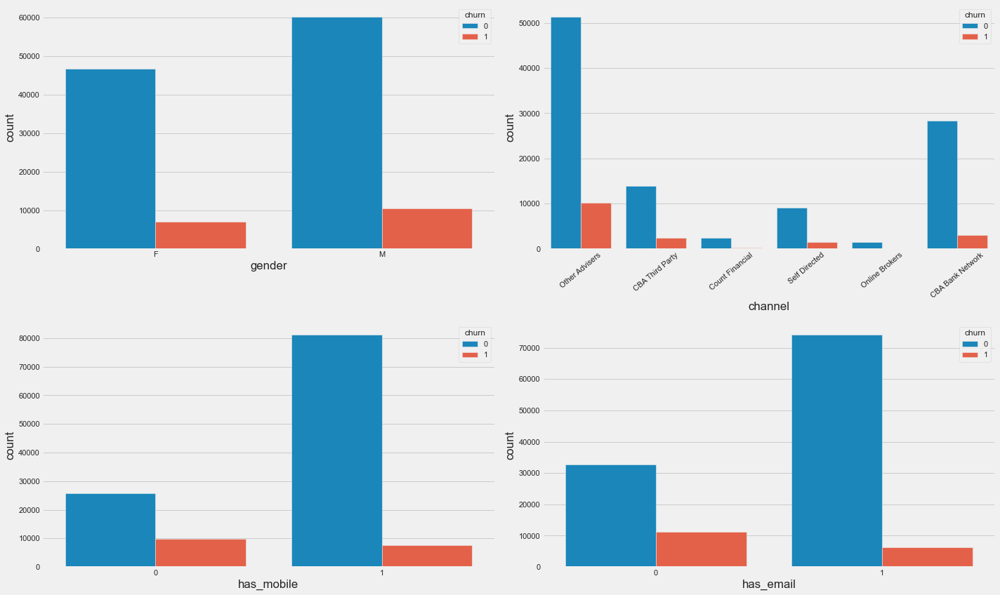

In [212]:
# Relations based on the categorical data attributes
fig, axarr = plt.subplots(2, 2, figsize=(20, 12))
sns.countplot(x='gender', hue = 'churn',data = finalDF, ax=axarr[0][0])
sns.countplot(x='channel', hue = 'churn',data = finalDF, ax=axarr[0][1])
sns.countplot(x='has_mobile', hue = 'churn',data = finalDF, ax=axarr[1][0])
axarr[0][1].set_xticklabels(df['channel'].unique().tolist(), rotation=40)
sns.countplot(x='has_email', hue = 'churn',data = finalDF, ax=axarr[1][1])
plt.tight_layout()
plt.show();

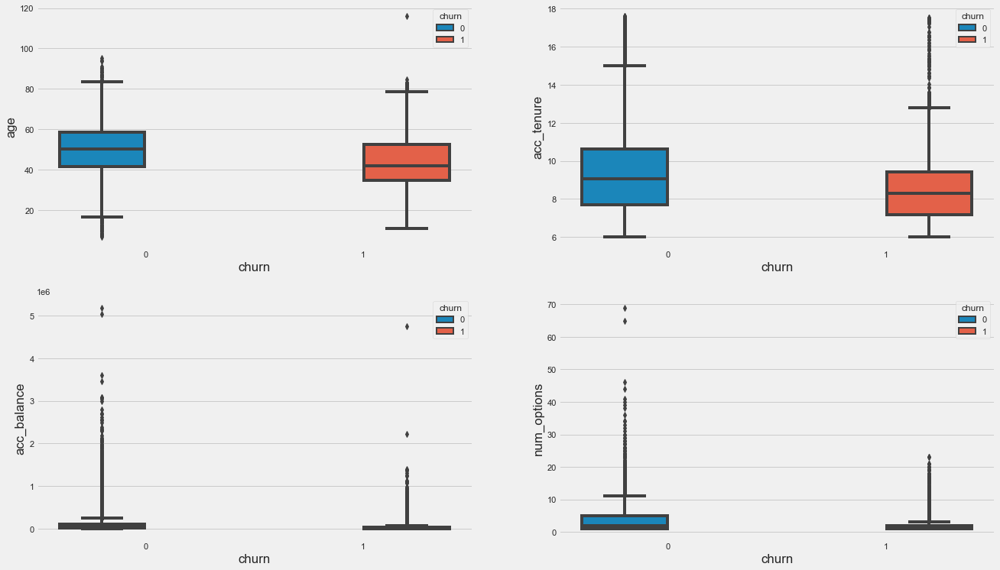

In [213]:
# Relations based on the continuous data attributes
fig, axarr = plt.subplots(2, 2, figsize=(20, 12))
sns.boxplot(y='age',x = 'churn', hue = 'churn',data = finalDF, ax=axarr[0][0])
sns.boxplot(y='acc_tenure',x = 'churn', hue = 'churn',data = finalDF , ax=axarr[0][1])
sns.boxplot(y='acc_balance',x = 'churn', hue = 'churn',data = finalDF, ax=axarr[1][0])
sns.boxplot(y='num_options',x = 'churn', hue = 'churn',data = finalDF, ax=axarr[1][1])
plt.show();

<Figure size 1080x360 with 0 Axes>

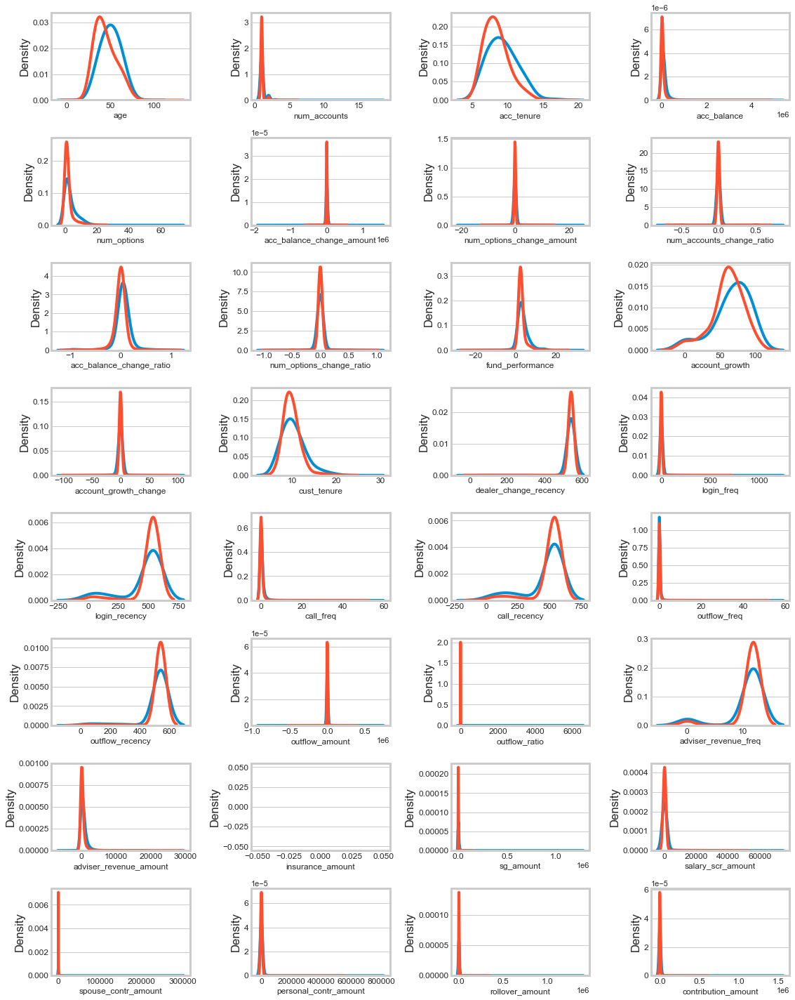

In [214]:
var = finalDF.select_dtypes(include=['float64', 'int']).columns.tolist()

i = 0
t0 = finalDF.loc[finalDF['churn'] == 0]
t1 = finalDF.loc[finalDF['churn'] == 1]

sns.set_style('whitegrid')
plt.figure()
fig, ax = plt.subplots(8,4,figsize=(16,20))

for feature in var:
    i += 1
    plt.subplot(8,4,i)
    sns.kdeplot(t0[feature], bw=0.5,label="Class = 0")
    sns.kdeplot(t1[feature], bw=0.5,label="Class = 1")
    plt.xlabel(feature, fontsize=12)
    locs, labels = plt.xticks()
    plt.tick_params(axis='both', which='major', labelsize=12)
plt.tight_layout()
plt.show();

### Correlation between Quantitative variables

In [215]:
numericals = list(set(finalDF.columns.tolist()) - set(categoricals)) + list(set(categoricals) - set(finalDF.columns.tolist()))

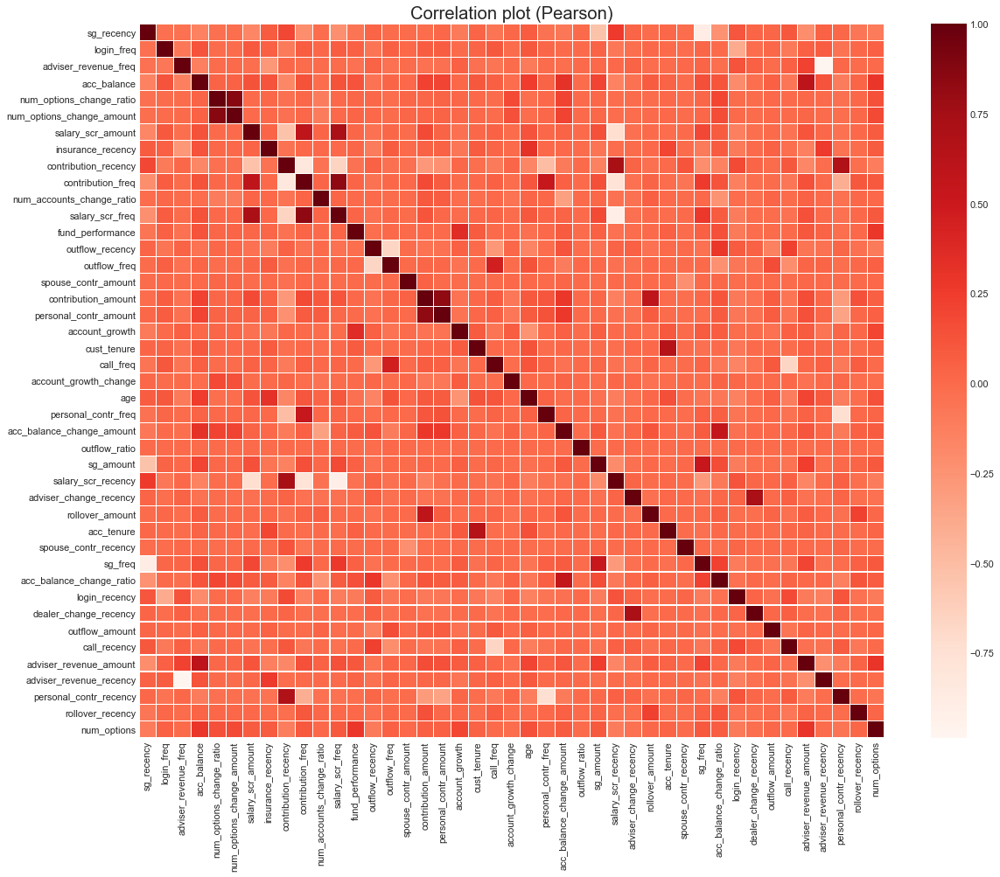

In [216]:
plt.figure(figsize = (17,14))
plt.title('Correlation plot (Pearson)')
corr = finalDF[numericals].corr()
sns.heatmap(corr, xticklabels=corr.columns, yticklabels=corr.columns,linewidths=.1,cmap="Reds")
plt.show();

### There is high correlation among some features. 

In [217]:
def magnify():
    return [dict(selector="th",
                 props=[("font-size", "7pt")]),
            dict(selector="td",
                 props=[('padding', "0em 0em")]),
            dict(selector="th:hover",
                 props=[("font-size", "12pt")]),
            dict(selector="tr:hover td:hover",
                 props=[('max-width', '200px'),
                        ('font-size', '12pt')])
]

corr.style.background_gradient(axis=1)\
    .set_properties(**{'max-width': '80px', 'font-size': '10pt'})\
    .set_caption("Hover to magify")\
    .set_precision(2)\
    .set_table_styles(magnify())

,sg_recency,login_freq,adviser_revenue_freq,acc_balance,num_options_change_ratio,num_options_change_amount,salary_scr_amount,insurance_recency,contribution_recency,contribution_freq,num_accounts_change_ratio,salary_scr_freq,fund_performance,outflow_recency,outflow_freq,spouse_contr_amount,contribution_amount,personal_contr_amount,account_growth,cust_tenure,call_freq,account_growth_change,age,personal_contr_freq,acc_balance_change_amount,outflow_ratio,sg_amount,salary_scr_recency,adviser_change_recency,rollover_amount,acc_tenure,spouse_contr_recency,sg_freq,acc_balance_change_ratio,login_recency,dealer_change_recency,outflow_amount,call_recency,adviser_revenue_amount,adviser_revenue_recency,personal_contr_recency,rollover_recency,num_options
sg_recency,1.00,-0.03,-0.04,-0.14,-0.03,-0.02,-0.17,0.08,0.19,-0.22,-0.02,-0.22,-0.06,0.04,-0.00,-0.00,-0.01,0.02,-0.09,0.03,-0.06,0.02,0.07,-0.05,-0.08,0.00,-0.54,0.26,0.04,-0.01,0.02,-0.01,-0.88,-0.24,0.11,0.03,0.03,0.11,-0.21,0.05,0.02,-0.07,-0.10
login_freq,-0.03,1.00,-0.07,0.13,-0.00,-0.00,0.09,0.06,-0.09,0.07,0.02,0.07,0.06,-0.06,0.06,0.01,0.08,0.07,0.00,0.04,0.10,-0.01,0.10,0.03,0.01,-0.00,0.04,-0.08,-0.02,0.01,0.00,-0.01,0.03,-0.00,-0.39,-0.02,0.02,-0.08,0.05,0.07,-0.06,0.02,0.06
adviser_revenue_freq,-0.04,-0.07,1.00,-0.13,-0.00,0.00,-0.02,-0.27,0.02,-0.01,-0.01,-0.01,-0.04,0.05,-0.04,-0.00,-0.03,-0.03,0.06,-0.03,-0.06,-0.00,-0.09,-0.00,-0.02,0.00,0.01,0.01,0.04,-0.01,-0.01,0.01,0.04,-0.02,0.13,0.05,-0.01,0.05,0.22,-0.99,0.02,-0.00,0.01
acc_balance,-0.14,0.13,-0.13,1.00,0.04,0.05,0.13,0.13,-0.18,0.14,-0.01,0.13,0.13,-0.05,0.04,0.01,0.22,0.20,0.02,0.10,0.06,-0.01,0.25,0.05,0.32,-0.00,0.21,-0.15,-0.05,0.08,0.04,-0.00,0.15,0.12,-0.20,-0.02,0.05,-0.06,0.60,0.13,-0.11,0.03,0.29
num_options_change_ratio,-0.03,-0.00,-0.00,0.04,1.00,0.86,0.00,0.01,-0.03,0.02,-0.11,0.01,0.03,0.02,-0.02,0.02,0.03,0.04,0.02,0.01,-0.01,0.18,-0.02,0.01,0.21,-0.00,0.02,-0.01,-0.00,-0.01,0.01,-0.01,0.03,0.20,-0.01,-0.00,0.01,0.00,0.01,0.00,-0.03,0.02,0.14
num_options_change_amount,-0.02,-0.00,0.00,0.05,0.86,1.00,0.00,0.01,-0.03,0.02,-0.10,0.01,0.03,0.01,-0.01,0.03,0.04,0.04,0.02,0.01,-0.01,0.14,-0.01,0.01,0.21,-0.00,0.02,-0.01,-0.01,0.00,0.01,-0.01,0.02,0.17,-0.00,-0.01,0.01,0.01,0.03,-0.00,-0.02,0.02,0.18
salary_scr_amount,-0.17,0.09,-0.02,0.13,0.00,0.00,1.00,0.03,-0.53,0.59,0.04,0.71,0.02,-0.03,0.03,-0.00,0.17,0.04,-0.03,0.02,0.05,-0.01,0.13,0.02,0.04,-0.00,0.14,-0.73,-0.03,0.00,-0.01,0.00,0.19,0.09,-0.12,-0.02,-0.00,-0.05,0.12,0.02,-0.04,0.01,0.08
insurance_recency,0.08,0.06,-0.27,0.13,0.01,0.01,0.03,1.00,-0.04,0.01,0.01,0.01,0.02,-0.11,0.08,0.00,0.05,0.05,-0.07,0.09,0.03,0.00,0.32,0.01,0.01,-0.00,-0.06,-0.01,-0.01,0.01,0.20,-0.01,-0.09,0.08,-0.09,0.01,0.05,-0.02,-0.12,0.26,-0.05,-0.01,0.09
contribution_recency,0.19,-0.09,0.02,-0.18,-0.03,-0.03,-0.53,-0.04,1.00,-0.82,-0.05,-0.66,-0.04,0.05,-0.03,-0.03,-0.27,-0.23,0.02,-0.02,-0.09,0.03,-0.16,-0.50,-0.09,0.00,-0.13,0.73,0.04,-0.03,0.00,0.12,-0.21,-0.15,0.17,0.03,-0.00,0.10,-0.18,-0.01,0.68,-0.02,-0.11
contribution_freq,-0.22,0.07,-0.01,0.14,0.02,0.02,0.59,0.01,-0.82,1.00,0.04,0.84,0.03,-0.04,0.02,0.01,0.17,0.09,-0.00,0.01,0.06,-0.01,0.11,0.54,0.06,-0.00,0.15,-0.76,-0.03,0.04,-0.01,-0.06,0.26,0.12,-0.13,-0.02,-0.00,-0.07,0.15,0.00,-0.41,0.10,0.10


In [218]:
def remove_collinear_features(x, threshold = 0.99):
    '''
    Objective:
        Remove collinear features in a dataframe with a correlation coefficient
        greater than the threshold. Removing collinear features can help a model 
        to generalize and improves the interpretability of the model.

    Inputs: 
        x: features dataframe
        threshold: features with correlations greater than this value are removed

    Output: 
        dataframe that contains only the non-highly-collinear features
    '''

    # Calculate the correlation matrix
    corr_matrix = x.corr()
    iters = range(len(corr_matrix.columns) - 1)
    drop_cols = []

    # Iterate through the correlation matrix and compare correlations
    for i in iters:
        for j in range(i+1):
            item = corr_matrix.iloc[j:(j+1), (i+1):(i+2)]
            col = item.columns
            row = item.index
            val = abs(item.values)

            # If correlation exceeds the threshold
            if val >= threshold:
                # Print the correlated features and the correlation value
                print(col.values[0], "|", row.values[0], "|", round(val[0][0], 2))
                drop_cols.append(col.values[0])

    # Drop one of each pair of correlated columns
    drops = set(drop_cols)
    x = x.drop(columns=drops)

    return x

In [219]:
finalDF = remove_collinear_features(finalDF, threshold = 0.9)

num_accounts_change_ratio | num_accounts_change_amount | 0.97
adviser_change_recency | adviser_change_freq | 0.91
dealer_change_recency | dealer_change_freq | 0.94
adviser_revenue_recency | adviser_revenue_freq | 0.99
insurance_types | insurance_recency | 0.91
salary_scr_recency | salary_scr_freq | 0.9


In [220]:
print('Dimensions of the Training set:',finalDF.shape)

Dimensions of the Training set: (124363, 79)


In [221]:
final_data = finalDF.copy()

#### Pre-processing

In [222]:
# One-hot encoding
def one_hot_encoding(df, cols):
    """
    @param df pandas DataFrame
    @param cols a list of columns to encode
    @return a DataFrame with one-hot encoding
    """
    for each in cols:
        dummies = pd.get_dummies(df[each], prefix=each, drop_first=False)
        df = pd.concat([df, dummies], axis=1)
        df = df.drop(each, 1)
    return df

# Function to min-max normalize
def normalize(df, cols):
    """
    @param df pandas DataFrame
    @param cols a list of columns to encode
    @return a DataFrame with normalized specified features
    """
    result = df.copy() # do not touch the original df
    for feature_name in cols:
        max_value = df[feature_name].max()
        min_value = df[feature_name].min()
        if max_value > min_value:
            result[feature_name] = (df[feature_name] - min_value) / (max_value - min_value)
    return result

In [223]:
categoricals.remove('insurance_amount')
categoricals.remove('insurance_types')
categoricals.remove('churn')

In [224]:
#categoricals.remove('channel')

In [225]:
#categoricals.remove('num_accounts_change_ratio')

In [226]:
# get the intial set of encoded features and encode them
finalDF = one_hot_encoding(finalDF, categoricals)

In [227]:
print('Dimensions of the Training set:',finalDF.shape)

Dimensions of the Training set: (124363, 194)


In [228]:
finalDF.head()

,age,acc_tenure,acc_balance,num_options,acc_balance_change_amount,num_options_change_amount,acc_balance_change_ratio,num_options_change_ratio,fund_performance,account_growth,account_growth_change,cust_tenure,login_freq,login_recency,call_freq,call_recency,outflow_freq,outflow_recency,outflow_amount,outflow_ratio,adviser_revenue_freq,adviser_revenue_amount,insurance_amount,insurance_recency,sg_freq,sg_amount,sg_recency,salary_scr_freq,salary_scr_amount,spouse_contr_amount,spouse_contr_recency,personal_contr_freq,personal_contr_amount,personal_contr_recency,rollover_amount,rollover_recency,contribution_freq,contribution_amount,contribution_recency,churn,channel_CBA Bank Network,channel_CBA Third Party,channel_Count Financial,channel_Online Brokers,channel_Other Advisers,channel_Self Directed,gender_F,gender_M,num_accounts_1.0,num_accounts_2.0,num_accounts_3.0,num_accounts_4.0,num_accounts_5.0,num_accounts_6.0,num_accounts_7.0,num_accounts_8.0,num_accounts_9.0,num_accounts_10.0,num_accounts_18.0,stmt_pref_E,stmt_pref_M,stmt_pref_N,annualrpt_pref_E,annualrpt_pref_M,annualrpt_pref_N,promotional_pref_E,promotional_pref_M,promotional_pref_N,returned_mail_count_0,returned_mail_count_1,returned_mail_count_2,rb_flag_0,block_flag_0,block_flag_1,has_email_0,has_email_1,has_work_tel_0,has_work_tel_1,has_home_tel_0,has_home_tel_1,has_mobile_0,has_mobile_1,num_contacts_0,num_contacts_1,num_contacts_2,num_contacts_3,num_contacts_4,num_accounts_change_amount_-4,num_accounts_change_amount_-3,num_accounts_change_amount_-2,num_accounts_change_amount_-1,num_accounts_change_amount_0,num_accounts_change_amount_1,num_accounts_change_amount_2,num_accounts_change_amount_3,num_accounts_change_amount_4,num_contacts_change_amount_-3,num_contacts_change_amount_-2,num_contacts_change_amount_-1,num_contacts_change_amount_0,num_contacts_change_amount_1,num_contacts_change_amount_2,num_contacts_change_amount_3,num_contacts_change_amount_4,postcode_change_added,postcode_change_changed,postcode_change_removed,postcode_change_same,adviser_no_change_added,adviser_no_change_changed,adviser_no_change_removed,adviser_no_change_same,email_change_added,email_change_changed,email_change_removed,email_change_same,home_tel_change_added,home_tel_change_changed,home_tel_change_removed,home_tel_change_same,work_tel_change_added,work_tel_change_changed,work_tel_change_removed,work_tel_change_same,mobile_tel_change_added,mobile_tel_change_changed,mobile_tel_change_removed,mobile_tel_change_same,sav_plan_change_added,sav_plan_change_changed,sav_plan_change_same,dist_method_change_added,dist_method_change_same,fni_level_change_down,fni_level_change_same,fni_level_change_up,stmt_pref_change_down,stmt_pref_change_same,stmt_pref_change_up,annualrpt_pref_change_down,annualrpt_pref_change_same,annualrpt_pref_change_up,promotional_pref_change_down,promotional_pref_change_same,promotional_pref_change_up,option_changed_0,option_changed_1,num_accounts_closed_0,num_accounts_closed_1,num_accounts_closed_2,num_accounts_closed_3,num_accounts_closed_4,adviser_change_freq_0,adviser_change_freq_1,adviser_change_freq_2,adviser_change_freq_3,adviser_change_freq_4,dealer_change_freq_0,dealer_change_freq_1,dealer_change_freq_2,dealer_change_freq_3,adviser_revenue_types_0,adviser_revenue_types_1,adviser_revenue_types_2,adviser_revenue_types_3,adviser_revenue_types_4,adviser_revenue_types_5,adviser_revenue_types_6,insurance_freq_0,insurance_stopped_0,insurance_stopped_1,spouse_contr_freq_0,spouse_contr_freq_1,spouse_contr_freq_2,spouse_contr_freq_3,spouse_contr_freq_4,spouse_contr_freq_5,spouse_contr_freq_6,spouse_contr_freq_8,spouse_contr_freq_9,spouse_contr_freq_10,spouse_contr_freq_11,spouse_contr_freq_12,rollover_freq_0,rollover_freq_1,rollover_freq_2,rollover_freq_3,rollover_freq_4,rollover_freq_5,rollover_freq_6,sg_stopped_0,sg_stopped_1,is_directed_0,is_directed_1
1,60.91000,10.49000,70473.16000,1.00000,2017.76000,0.00000,0.02900,0.00000,2.70000,76.53000,-0.52000,15.88000,0.00000,540.00000,0.0

### Splitting into features and labels dataframe

In [229]:
finalDF = finalDF.dropna()
finalDF.reset_index(inplace = True, drop = True)

In [230]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
numeric_cols = list(finalDF.dtypes[finalDF.dtypes != 'object'].index)
finalDF.loc[:,numeric_cols] = scaler.fit_transform(finalDF.loc[:,numeric_cols])

In [231]:
finalDF.head()

,age,acc_tenure,acc_balance,num_options,acc_balance_change_amount,num_options_change_amount,acc_balance_change_ratio,num_options_change_ratio,fund_performance,account_growth,account_growth_change,cust_tenure,login_freq,login_recency,call_freq,call_recency,outflow_freq,outflow_recency,outflow_amount,outflow_ratio,adviser_revenue_freq,adviser_revenue_amount,insurance_amount,insurance_recency,sg_freq,sg_amount,sg_recency,salary_scr_freq,salary_scr_amount,spouse_contr_amount,spouse_contr_recency,personal_contr_freq,personal_contr_amount,personal_contr_recency,rollover_amount,rollover_recency,contribution_freq,contribution_amount,contribution_recency,churn,channel_CBA Bank Network,channel_CBA Third Party,channel_Count Financial,channel_Online Brokers,channel_Other Advisers,channel_Self Directed,gender_F,gender_M,num_accounts_1.0,num_accounts_2.0,num_accounts_3.0,num_accounts_4.0,num_accounts_5.0,num_accounts_6.0,num_accounts_7.0,num_accounts_8.0,num_accounts_9.0,num_accounts_10.0,num_accounts_18.0,stmt_pref_E,stmt_pref_M,stmt_pref_N,annualrpt_pref_E,annualrpt_pref_M,annualrpt_pref_N,promotional_pref_E,promotional_pref_M,promotional_pref_N,returned_mail_count_0,returned_mail_count_1,returned_mail_count_2,rb_flag_0,block_flag_0,block_flag_1,has_email_0,has_email_1,has_work_tel_0,has_work_tel_1,has_home_tel_0,has_home_tel_1,has_mobile_0,has_mobile_1,num_contacts_0,num_contacts_1,num_contacts_2,num_contacts_3,num_contacts_4,num_accounts_change_amount_-4,num_accounts_change_amount_-3,num_accounts_change_amount_-2,num_accounts_change_amount_-1,num_accounts_change_amount_0,num_accounts_change_amount_1,num_accounts_change_amount_2,num_accounts_change_amount_3,num_accounts_change_amount_4,num_contacts_change_amount_-3,num_contacts_change_amount_-2,num_contacts_change_amount_-1,num_contacts_change_amount_0,num_contacts_change_amount_1,num_contacts_change_amount_2,num_contacts_change_amount_3,num_contacts_change_amount_4,postcode_change_added,postcode_change_changed,postcode_change_removed,postcode_change_same,adviser_no_change_added,adviser_no_change_changed,adviser_no_change_removed,adviser_no_change_same,email_change_added,email_change_changed,email_change_removed,email_change_same,home_tel_change_added,home_tel_change_changed,home_tel_change_removed,home_tel_change_same,work_tel_change_added,work_tel_change_changed,work_tel_change_removed,work_tel_change_same,mobile_tel_change_added,mobile_tel_change_changed,mobile_tel_change_removed,mobile_tel_change_same,sav_plan_change_added,sav_plan_change_changed,sav_plan_change_same,dist_method_change_added,dist_method_change_same,fni_level_change_down,fni_level_change_same,fni_level_change_up,stmt_pref_change_down,stmt_pref_change_same,stmt_pref_change_up,annualrpt_pref_change_down,annualrpt_pref_change_same,annualrpt_pref_change_up,promotional_pref_change_down,promotional_pref_change_same,promotional_pref_change_up,option_changed_0,option_changed_1,num_accounts_closed_0,num_accounts_closed_1,num_accounts_closed_2,num_accounts_closed_3,num_accounts_closed_4,adviser_change_freq_0,adviser_change_freq_1,adviser_change_freq_2,adviser_change_freq_3,adviser_change_freq_4,dealer_change_freq_0,dealer_change_freq_1,dealer_change_freq_2,dealer_change_freq_3,adviser_revenue_types_0,adviser_revenue_types_1,adviser_revenue_types_2,adviser_revenue_types_3,adviser_revenue_types_4,adviser_revenue_types_5,adviser_revenue_types_6,insurance_freq_0,insurance_stopped_0,insurance_stopped_1,spouse_contr_freq_0,spouse_contr_freq_1,spouse_contr_freq_2,spouse_contr_freq_3,spouse_contr_freq_4,spouse_contr_freq_5,spouse_contr_freq_6,spouse_contr_freq_8,spouse_contr_freq_9,spouse_contr_freq_10,spouse_contr_freq_11,spouse_contr_freq_12,rollover_freq_0,rollover_freq_1,rollover_freq_2,rollover_freq_3,rollover_freq_4,rollover_freq_5,rollover_freq_6,sg_stopped_0,sg_stopped_1,is_directed_0,is_directed_1
0,0.99800,0.65495,-0.11125,-0.63747,-0.05104,-0.01927,-0.06287,-0.00402,-0.28898,0.43689,-0.01200,2.24087,-0.14422,0.42873,-0.29408

In [232]:
finalDF['churn'] = finalDF['churn'].astype('object')
x = finalDF.drop(['churn'], axis = 1)
y = finalDF['churn']

categorical_columns = list(x.select_dtypes(include='category').columns)
numeric_columns = list(x.select_dtypes(exclude='category').columns)

In [233]:
from sklearn.model_selection import train_test_split

data_splits = train_test_split(x, y, test_size=0.2, random_state=0,
                               shuffle=True)
x_train, x_test, y_train, y_test = data_splits

In [234]:
print('Shape of Training Features : ', x_train.shape)
print('Shape of Testing Features : ', x_test.shape)

print('Shape of Training Labels : ', y_train.shape)
print('Shape of Testing Labels : ', y_test.shape)

Shape of Training Features :  (99490, 193)
Shape of Testing Features :  (24873, 193)
Shape of Training Labels :  (99490,)
Shape of Testing Labels :  (24873,)


### Split into train and test

In [235]:
X_train, X_test, Y_train, Y_test = train_test_split(x, y, test_size=0.2, shuffle=True)
print('Train data shape: {}'.format(X_train.shape))
print('Test data shape: {}'.format(X_test.shape))

Train data shape: (99490, 193)
Test data shape: (24873, 193)


## Our Modelling Approach

<img src = "https://scikit-learn.org/stable/_images/grid_search_workflow.png">

## Model Evaluation  <a id='model-eval'></a>

 In this step we will first define which evaluation metrics we will use to evaluate our model. The most important evaluation metric for this problem domain is **sensitivity, specificity, Precision, F1-measure, Geometric mean and mathew correlation coefficient and finally ROC AUC curve**
 
 
A confusion matrix is a table that is often used to describe the performance of a classification model (or "classifier") on a set of test data for which the true values are known. The confusion matrix itself is relatively simple to understand, but the related terminology can be confusing.

Example confusion matrix for a binary classifier

<img src = 'https://www.dataschool.io/content/images/2015/01/confusion_matrix_simple2.png'>

What can we learn from this matrix?

- There are two possible predicted classes: "yes" and "no". If we were predicting the presence of a disease, for example, "yes" would mean they have the disease, and "no" would mean they don't have the disease.
- The classifier made a total of 165 predictions (e.g., 165 patients were being tested for the presence of that disease).
- Out of those 165 cases, the classifier predicted "yes" 110 times, and "no" 55 times.
- In reality, 105 patients in the sample have the disease, and 60 patients do not.

Let's now define the most basic terms, which are whole numbers (not rates):

**true positives (TP):** These are cases in which we predicted yes (they have the disease), and they do have the disease.

**true negatives (TN):** We predicted no, and they don't have the disease.

**false positives (FP):** We predicted yes, but they don't actually have the disease. (Also known as a "Type I error.")

**false negatives (FN):** We predicted no, but they actually do have the disease. (Also known as a "Type II error.")

I've added these terms to the confusion matrix, and also added the row and column totals:


This is a list of rates that are often computed from a confusion matrix for a binary classifier:

**Accuracy:** Overall, how often is the classifier correct?
(TP+TN)/total = (100+50)/165 = 0.91

**Misclassification Rate:** Overall, how often is it wrong?
(FP+FN)/total = (10+5)/165 = 0.09
equivalent to 1 minus Accuracy
also known as "Error Rate"

**True Positive Rate:** When it's actually yes, how often does it predict yes?
TP/actual yes = 100/105 = 0.95
also known as "Sensitivity" or "Recall"

**False Positive Rate:** When it's actually no, how often does it predict yes?
FP/actual no = 10/60 = 0.17

**True Negative Rate:** When it's actually no, how often does it predict no?
TN/actual no = 50/60 = 0.83
equivalent to 1 minus False Positive Rate
also known as "Specificity"

**Precision:** When it predicts yes, how often is it correct?
TP/predicted yes = 100/110 = 0.91

**Prevalence:** How often does the yes condition actually occur in our sample?
actual yes/total = 105/165 = 0.64
A couple other terms are also worth mentioning:

**Null Error Rate:** This is how often you would be wrong if you always predicted the majority class. (In our example, the null error rate would be 60/165=0.36 because if you always predicted yes, you would only be wrong for the 60 "no" cases.) 

This can be a useful baseline metric to compare your classifier against. However, the best classifier for a particular application will sometimes have a higher error rate than the null error rate, as demonstrated by the Accuracy Paradox.


**Cohen's Kappa:** This is essentially a measure of how well the classifier performed as compared to how well it would have performed simply by chance. In other words, a model will have a high Kappa score if there is a big difference between the accuracy and the null error rate. (More details about Cohen's Kappa.)

**F Score:** This is a weighted average of the true positive rate (recall) and precision. (More details about the F Score.)

**ROC Curve:** This is a commonly used graph that summarizes the performance of a classifier over all possible thresholds. It is generated by plotting the True Positive Rate (y-axis) against the False Positive Rate (x-axis) as you vary the threshold for assigning observations to a given class. (More details about ROC Curves.)



### Sensitivity vs Specificity

![](https://i.ibb.co/d43FVfJ/Sensitivity-and-specificity-svg.png)

### Mathew Correlation coefficient (MCC)

The Matthews correlation coefficient (MCC), instead, is a more reliable statistical rate which produces a high score only if the prediction obtained good results in all of the four confusion matrix categories (true positives, false negatives, true negatives, and false positives), proportionally both to the size of positive elements and the size of negative elements in the dataset.

![](https://i.ibb.co/mH6MmG4/mcc.jpg)

### Log Loss
Logarithmic loss  measures the performance of a classification model where the prediction input is a probability value between 0 and 1. The goal of our machine learning models is to minimize this value. A perfect model would have a log loss of 0. Log loss increases as the predicted probability diverges from the actual label. So predicting a probability of .012 when the actual observation label is 1 would be bad and result in a high log loss.

The graph below shows the range of possible log loss values given a true observation (isDog = 1). As the predicted probability approaches 1, log loss slowly decreases. As the predicted probability decreases, however, the log loss increases rapidly. Log loss penalizes both types of errors, but especially those predications that are confident and wrong!

![](https://i.ibb.co/6BdDczW/log-loss.jpg)

### F1 Score

 F1 Score is the weighted average of Precision and Recall. Therefore, this score takes both false positives and false negatives into account. Intuitively it is not as easy to understand as accuracy, but F1 is usually more useful than accuracy, especially if you have an uneven class distribution. Accuracy works best if false positives and false negatives have similar cost. If the cost of false positives and false negatives are very different, it’s better to look at both Precision and Recall. In our case, F1 score is 0.701.

**F1 Score = 2*(Recall * Precision) / (Recall + Precision)**


<img src = 'https://www.researchgate.net/publication/325567208/figure/tbl4/AS:668664739151911@1536433505975/Classification-performance-metrics-based-on-the-confusion-matrix.png'>

# Comparison Table of ML based Models - Train Test Split

In [236]:
from sklearn.metrics import cohen_kappa_score
y = y.astype(int)
X_train, X_test, y_train, y_test = train_test_split(x,y, test_size=0.20, shuffle=True)
X_train.replace([np.inf, -np.inf], np.nan, inplace=True)
X_test.replace([np.inf, -np.inf], np.nan, inplace=True)
X_train = X_train.fillna(method='ffill')
X_test = X_test.fillna(method='ffill')

### Applying Undersampling on training data

In [237]:
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler

X_train, y_train = RandomUnderSampler().fit_resample(X_train, y_train)
Y_train = y_train.copy()

In [238]:
print('Train data shape: {}'.format(X_train.shape))
print('Test data shape: {}'.format(X_test.shape))

Train data shape: (28062, 193)
Test data shape: (24873, 193)


In [239]:
y_train.value_counts()

0    14031
1    14031
Name: churn, dtype: int64

In [240]:
train_accuracy = []
test_accuracy = []
precision = []
recall = []
f1 = []
cohen_kappa = []
models = ["Naive Bayes","Logistic Regression","Decision Tree","RandomForest", "AdaBoost", "ExtraTrees","GradientBoosting","XGboost"]
roc = []
mathew = []
random_state = 2
classifiers = []
classifiers.append(BernoulliNB())
classifiers.append(LogisticRegression())
classifiers.append(DecisionTreeClassifier())
classifiers.append(RandomForestClassifier(random_state=random_state, max_depth = 10, max_features = 'sqrt', n_estimators=  300))
classifiers.append(AdaBoostClassifier(DecisionTreeClassifier(random_state=random_state),random_state=random_state,learning_rate=0.5))
classifiers.append(ExtraTreesClassifier(random_state=random_state, criterion ='entropy', max_features = 'sqrt', min_samples_leaf = 20, min_samples_split = 15))
classifiers.append(GradientBoostingClassifier(random_state=random_state, learning_rate = 0.2, max_depth = 10, n_estimators = 200))
classifiers.append(XGBClassifier(random_state = random_state))



for classifier,model in zip(classifiers, models):
    print('='*len(model))
    print(model)
    print('='*len(model))
    classifier.fit(X_train, y_train)
    trainprediction = classifier.predict(X_train)
    prediction = classifier.predict(X_test)
    trainaccuracy = accuracy_score(y_train, trainprediction)
    testaccuracy = accuracy_score(y_test, prediction)
    train_accuracy.append(trainaccuracy)
    test_accuracy.append(testaccuracy)
    precision.append(precision_score(y_test, prediction, average='macro'))
    recall.append(recall_score(y_test, prediction, average='macro'))
    cohen_kappa.append(cohen_kappa_score(y_test, prediction))
    f1.append(f1_score(y_test, prediction, average='macro'))
    roc.append(metrics.roc_auc_score(y_test, prediction))

    mathew.append(metrics.matthews_corrcoef(y_test, prediction))

    print('\n clasification report:\n', classification_report(y_test,prediction))
    print('\n confussion matrix:\n',confusion_matrix(y_test, prediction))
    print('\n')
    
scoreDF = pd.DataFrame({'Model' : models})
scoreDF['Train Accuracy'] = train_accuracy
scoreDF['Test Accuracy'] = test_accuracy
scoreDF['Precision'] =  precision
scoreDF['Recall'] =  recall
scoreDF['F1 Score'] = f1 
scoreDF['AUC Score'] = roc 
scoreDF['Matthew Correlation Coefficient'] = mathew
scoreDF['Cohen Kappa Score'] = cohen_kappa


scoreDF.set_index("Model")

Naive Bayes


BernoulliNB()


 clasification report:
               precision    recall  f1-score   support

           0       0.95      0.74      0.83     21381
           1       0.32      0.74      0.45      3492

    accuracy                           0.74     24873
   macro avg       0.63      0.74      0.64     24873
weighted avg       0.86      0.74      0.78     24873


 confussion matrix:
 [[15885  5496]
 [  913  2579]]


Logistic Regression


LogisticRegression()


 clasification report:
               precision    recall  f1-score   support

           0       0.95      0.81      0.88     21381
           1       0.39      0.72      0.51      3492

    accuracy                           0.80     24873
   macro avg       0.67      0.77      0.69     24873
weighted avg       0.87      0.80      0.82     24873


 confussion matrix:
 [[17404  3977]
 [  962  2530]]


Decision Tree


DecisionTreeClassifier()


 clasification report:
               precision    recall  f1-score   support

           0       0.94      0.70      0.81     21381
           1       0.29      0.73      0.41      3492

    accuracy                           0.71     24873
   macro avg       0.61      0.72      0.61     24873
weighted avg       0.85      0.71      0.75     24873


 confussion matrix:
 [[15050  6331]
 [  936  2556]]


RandomForest


RandomForestClassifier(max_depth=10, max_features='sqrt', n_estimators=300,
                       random_state=2)


 clasification report:
               precision    recall  f1-score   support

           0       0.95      0.89      0.92     21381
           1       0.50      0.69      0.58      3492

    accuracy                           0.86     24873
   macro avg       0.72      0.79      0.75     24873
weighted avg       0.88      0.86      0.87     24873


 confussion matrix:
 [[18967  2414]
 [ 1080  2412]]


AdaBoost


AdaBoostClassifier(base_estimator=DecisionTreeClassifier(random_state=2),
                   learning_rate=0.5, random_state=2)


 clasification report:
               precision    recall  f1-score   support

           0       0.94      0.70      0.81     21381
           1       0.29      0.74      0.41      3492

    accuracy                           0.71     24873
   macro avg       0.62      0.72      0.61     24873
weighted avg       0.85      0.71      0.75     24873


 confussion matrix:
 [[15031  6350]
 [  923  2569]]


ExtraTrees


ExtraTreesClassifier(criterion='entropy', max_features='sqrt',
                     min_samples_leaf=20, min_samples_split=15, random_state=2)


 clasification report:
               precision    recall  f1-score   support

           0       0.94      0.89      0.91     21381
           1       0.49      0.67      0.57      3492

    accuracy                           0.86     24873
   macro avg       0.72      0.78      0.74     24873
weighted avg       0.88      0.86      0.87     24873


 confussion matrix:
 [[18976  2405]
 [ 1144  2348]]


GradientBoosting


GradientBoostingClassifier(learning_rate=0.2, max_depth=10, n_estimators=200,
                           random_state=2)


 clasification report:
               precision    recall  f1-score   support

           0       0.95      0.87      0.91     21381
           1       0.48      0.72      0.58      3492

    accuracy                           0.85     24873
   macro avg       0.72      0.80      0.74     24873
weighted avg       0.88      0.85      0.86     24873


 confussion matrix:
 [[18683  2698]
 [  986  2506]]


XGboost
[23:09:25] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=6,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=12, num_parallel_tree=1, random_state=2,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)


 clasification report:
               precision    recall  f1-score   support

           0       0.95      0.87      0.91     21381
           1       0.48      0.73      0.58      3492

    accuracy                           0.85     24873
   macro avg       0.72      0.80      0.75     24873
weighted avg       0.89      0.85      0.86     24873


 confussion matrix:
 [[18675  2706]
 [  959  2533]]




,Train Accuracy,Test Accuracy,Precision,Recall,F1 Score,AUC Score,Matthew Correlation Coefficient,Cohen Kappa Score
Model,,,,,,,,
Naive Bayes,0.74057,0.74233,0.63251,0.74075,0.63903,0.74075,0.35723,0.31083
Logistic Regression,0.77336,0.80143,0.66822,0.76925,0.69089,0.76925,0.42564,0.39561
Decision Tree,1.00000,0.70784,0.61453,0.71793,0.60924,0.71793,0.31597,0.26475
RandomForest,0.81356,0.85953,0.72296,0.78891,0.74780,0.78891,0.50760,0.49820
AdaBoost,1.00000,0.70759,0.61509,0.71934,0.60959,0.71934,0.31777,0.26585
ExtraTrees,0.78416,0.85732,0.71857,0.77996,0.74202,0.77996,0.49473,0.48643
GradientBoosting,0.99993,0.85189,0.71571,0.79573,0.74331,0.79573,0.50514,0.49079
XGboost,0.88198,0.85265,0.71732,0.79941,0.74544,0.79941,0.51017,0.49518


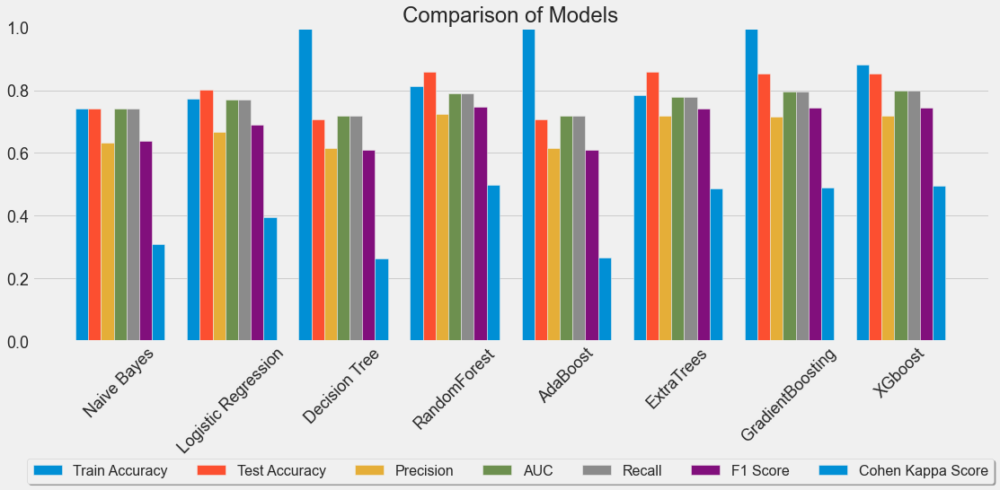

In [241]:
plt.style.use('fivethirtyeight')
params = {'legend.fontsize': '16',
          'figure.figsize': (15, 5),
         'axes.labelsize': '20',
         'axes.titlesize':'30',
         'xtick.labelsize':'18',
         'ytick.labelsize':'18'}
plt.rcParams.update(params)

def subcategorybar(X, vals, width=0.8):
    cols = ['Train Accuracy', 'Test Accuracy', 'Precision', 'AUC Score','Recall','F1 Score', 'Cohen Kappa Score']
    n = len(vals)
    _X = np.arange(len(X))
    for i in range(n):
        plt.bar(_X - width/2. + i/float(n)*width, vals[i], width=width/float(n), align="edge")   
        
        
    plt.xticks(_X, X)
    
plt.figure(figsize = (17,6))
subcategorybar(models, [scoreDF['Train Accuracy'], scoreDF['Test Accuracy'], scoreDF['Precision'], scoreDF['AUC Score'], scoreDF['Recall'], scoreDF['F1 Score'], scoreDF['Cohen Kappa Score']])
plt.ylim(0, 1.0)
cols = ['Train Accuracy', 'Test Accuracy', 'Precision', 'AUC','Recall','F1 Score', 'Cohen Kappa Score']
#plt.legend(cols)

plt.legend(cols, loc='upper center', bbox_to_anchor=(0.5, -0.35),
          fancybox=True, shadow=True, ncol=7)


plt.xlabel('Model', fontsize = 20)
plt.xticks(rotation = 45)

plt.title("Comparison of Models", fontsize = 24)
plt.show();


In [242]:
scoreDF = scoreDF.set_index("Model")

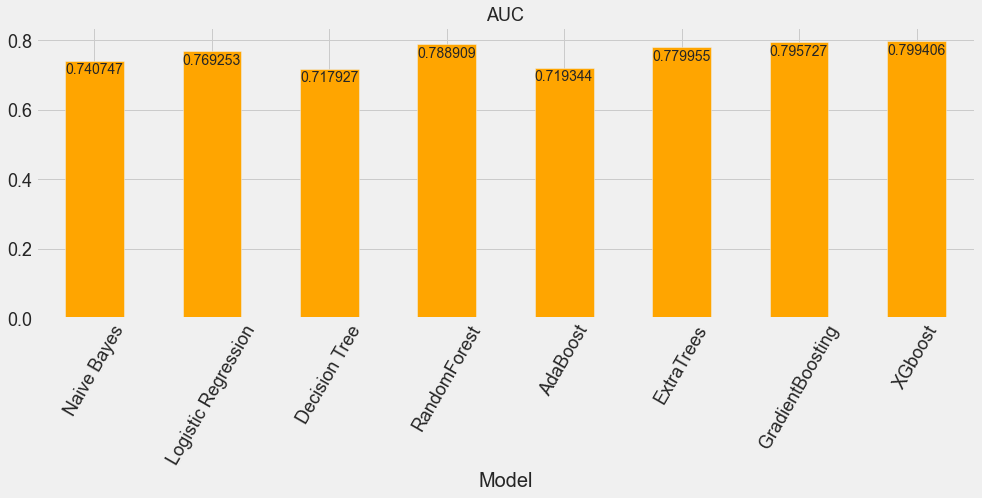

In [243]:
ax = scoreDF['AUC Score'].round(6).plot(kind = 'bar', color = 'orange');

for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() * 1., p.get_height() * 0.95))
plt.title('AUC', fontsize = 18)
plt.xticks(rotation = 60)
plt.show();

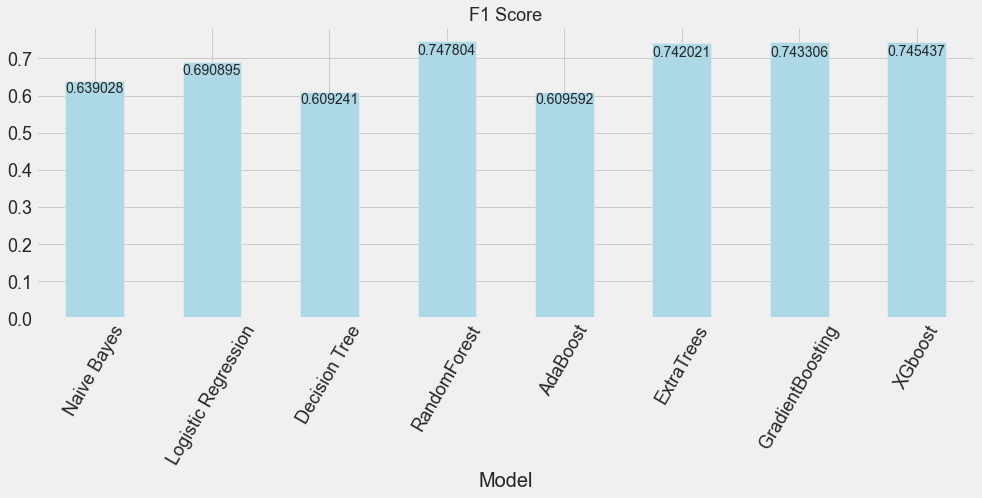

In [244]:
ax = scoreDF['F1 Score'].round(6).plot(kind = 'bar', color = 'lightblue');

for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() * 1., p.get_height() * 0.95))
plt.title('F1 Score', fontsize = 18)
plt.xticks(rotation = 60)
plt.show();

# Ensemble on Simple base Models

A voting ensemble (or a “majority voting ensemble“) is an ensemble machine learning model that combines the predictions from multiple other models.

It is a technique that may be used to improve model performance, ideally achieving better performance than any single model used in the ensemble.

A voting ensemble works by combining the predictions from multiple models. It can be used for classification or regression. In the case of regression, this involves calculating the average of the predictions from the models. In the case of classification, the predictions for each label are summed and the label with the majority vote is predicted.

**Hard Voting** - Predict the class with the largest sum of votes from models


**Soft Voting** - Predict the class with the largest summed probability from models.

- In hard voting (also known as majority voting), every individual classifier votes for a class, and the majority wins. In statistical terms, the predicted target label of the ensemble is the mode of the distribution of individually predicted labels.

- In soft voting, every individual classifier provides a probability value that a specific data point belongs to a particular target class. The predictions are weighted by the classifier's importance and summed up. Then the target label with the greatest sum of weighted probabilities wins the vote.

<img src = 'https://www.dropbox.com/s/59cyeldqfv2agc7/Screenshot%20%2832%29.png?dl=1'>

### Weighted Averaging

In [245]:
ensemble = VotingClassifier(estimators=[('Logistic Regression', LogisticRegression(random_state = random_state)),
                                              ('Naive Bayes', GaussianNB()),
                                              ('RF', RandomForestClassifier(random_state=random_state)),
                                              ('KNN', KNeighborsClassifier()),
                                              ('Decision Tree', DecisionTreeClassifier(random_state=random_state))], 
                                               voting='hard').fit(X_train,y_train)


In [246]:
y_train_ensemble = ensemble.predict(X_train)
y_pred_ensemble = ensemble.predict(X_test)

trainaccuracy = accuracy_score(y_train, y_train_ensemble)
testaccuracy = accuracy_score(y_test, y_pred_ensemble)
train_accuracy.append(trainaccuracy)
test_accuracy.append(testaccuracy)
precision.append(precision_score(y_test, y_pred_ensemble, average='macro'))
recall.append(recall_score(y_test, y_pred_ensemble, average='macro'))
cohen_kappa.append(cohen_kappa_score(y_test, y_pred_ensemble))
f1.append(f1_score(y_test, y_pred_ensemble, average='macro'))
roc.append(metrics.roc_auc_score(y_test, y_pred_ensemble))
mathew.append(metrics.matthews_corrcoef(y_test, y_pred_ensemble))


 Accuracy Score:
 0.807



 clasification report:
               precision    recall  f1-score   support

           0       0.95      0.82      0.88     21381
           1       0.40      0.73      0.51      3492

    accuracy                           0.81     24873
   macro avg       0.67      0.78      0.70     24873
weighted avg       0.87      0.81      0.83     24873


 Cohen Kappa Score:
 0.4069972655837042


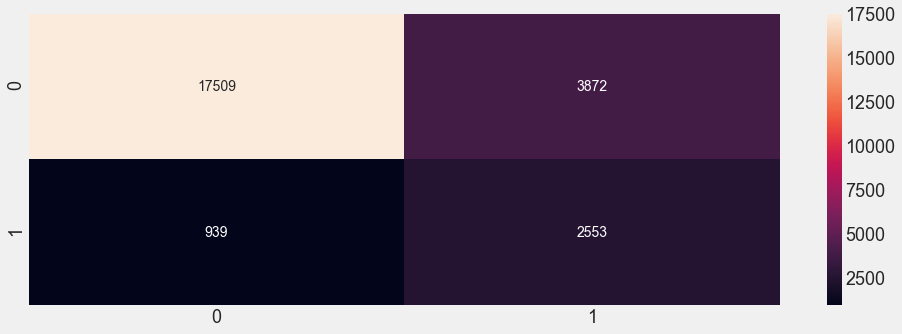

In [247]:
print('\n Accuracy Score:\n', np.round(accuracy_score(y_test, y_pred_ensemble), 3))
sns.heatmap(confusion_matrix(y_test,y_pred_ensemble),annot=True,fmt='2.0f')
print('\n clasification report:\n', classification_report(y_test,y_pred_ensemble))
print('\n Cohen Kappa Score:\n', metrics.cohen_kappa_score(y_test, y_pred_ensemble))

plt.show()

### Max Voting


 Accuracy Score:
 0.722



 clasification report:
               precision    recall  f1-score   support

           0       0.95      0.71      0.82     21381
           1       0.31      0.78      0.44      3492

    accuracy                           0.72     24873
   macro avg       0.63      0.75      0.63     24873
weighted avg       0.86      0.72      0.76     24873


 Cohen Kappa Score:
 0.29984452315656196


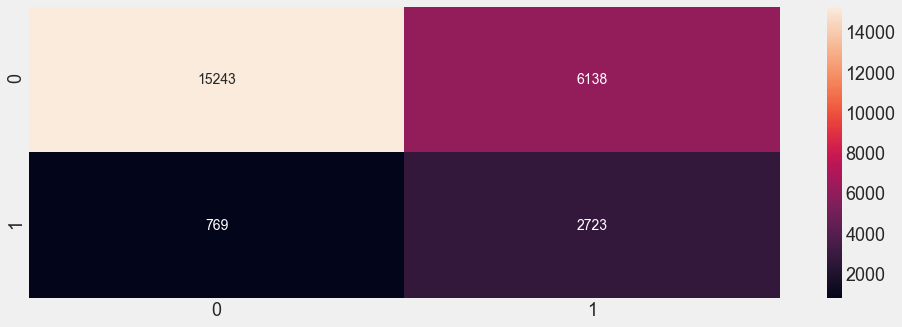

In [248]:
ensemble2 = VotingClassifier(estimators=[('Logistic Regression', LogisticRegression(random_state = random_state)),
                                              ('Naive Bayes', GaussianNB()),
                                              ('RF', RandomForestClassifier(random_state=random_state)),
                                              ('KNN', KNeighborsClassifier()),
                                              ('Decision Tree', DecisionTreeClassifier(random_state=random_state))], 
                                               voting='soft').fit(X_train,y_train)

y_train_ensemble2 = ensemble2.predict(X_train)
y_pred_ensemble2 = ensemble2.predict(X_test)

trainaccuracy = accuracy_score(y_train, y_train_ensemble2)
testaccuracy = accuracy_score(y_test, y_pred_ensemble2)
train_accuracy.append(trainaccuracy)
test_accuracy.append(testaccuracy)
precision.append(precision_score(y_test, y_pred_ensemble2, average='macro'))
recall.append(recall_score(y_test, y_pred_ensemble2, average='macro'))
cohen_kappa.append(cohen_kappa_score(y_test, y_pred_ensemble2))
f1.append(f1_score(y_test, y_pred_ensemble2, average='macro'))
roc.append(metrics.roc_auc_score(y_test, y_pred_ensemble2))
mathew.append(metrics.matthews_corrcoef(y_test, y_pred_ensemble2))

print('\n Accuracy Score:\n', np.round(accuracy_score(y_test, y_pred_ensemble2), 3))
sns.heatmap(confusion_matrix(y_test,y_pred_ensemble2),annot=True,fmt='2.0f')
print('\n clasification report:\n', classification_report(y_test,y_pred_ensemble2))
print('\n Cohen Kappa Score:\n', metrics.cohen_kappa_score(y_test, y_pred_ensemble2))
plt.show()

In [249]:
models.append('Stack Ensemble (Hard Voting)')
models.append('Stack Ensemble (Soft Voting)')
scoreDF = pd.DataFrame({'Model' : models})
scoreDF['Train Accuracy'] = train_accuracy
scoreDF['Test Accuracy'] = test_accuracy
scoreDF['Precision'] =  precision
scoreDF['Recall'] =  recall
scoreDF['F1 Score'] = f1 
scoreDF['AUC Score'] = roc 
scoreDF['Matthew Correlation Coefficient'] = mathew
scoreDF['Cohen Kappa Score'] = cohen_kappa

scoreDF = scoreDF.set_index("Model")


In [250]:
scoreDF

,Train Accuracy,Test Accuracy,Precision,Recall,F1 Score,AUC Score,Matthew Correlation Coefficient,Cohen Kappa Score
Model,,,,,,,,
Naive Bayes,0.74057,0.74233,0.63251,0.74075,0.63903,0.74075,0.35723,0.31083
Logistic Regression,0.77336,0.80143,0.66822,0.76925,0.69089,0.76925,0.42564,0.39561
Decision Tree,1.00000,0.70784,0.61453,0.71793,0.60924,0.71793,0.31597,0.26475
RandomForest,0.81356,0.85953,0.72296,0.78891,0.74780,0.78891,0.50760,0.49820
AdaBoost,1.00000,0.70759,0.61509,0.71934,0.60959,0.71934,0.31777,0.26585
ExtraTrees,0.78416,0.85732,0.71857,0.77996,0.74202,0.77996,0.49473,0.48643
GradientBoosting,0.99993,0.85189,0.71571,0.79573,0.74331,0.79573,0.50514,0.49079
XGboost,0.88198,0.85265,0.71732,0.79941,0.74544,0.79941,0.51017,0.49518
Stack Ensemble (Hard Voting),0.93946,0.80658,0.67323,0.77500,0.69704,0.77500,0.43652,0.40700


In [251]:
scoredf = scoreDF.copy()

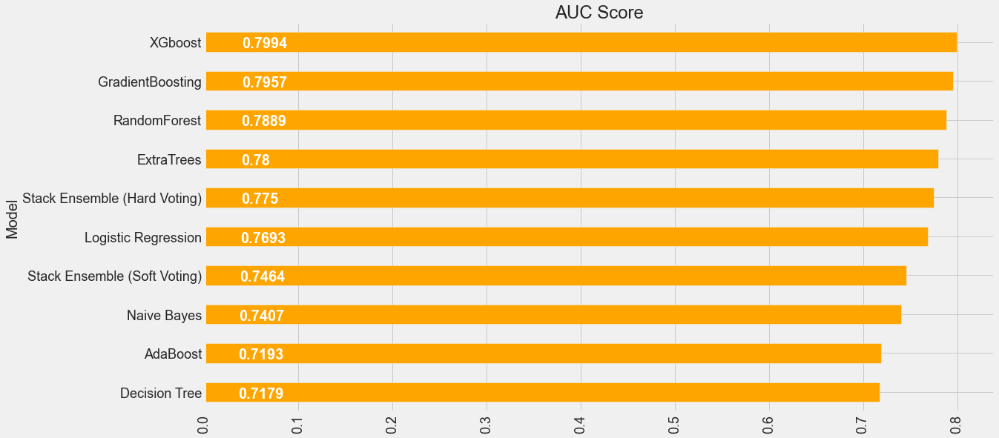

In [252]:
ax = scoreDF['AUC Score'].sort_values().round(6).plot(kind = 'barh', color = 'orange', figsize = (17,9));
# create a list to collect the plt.patches data
totals = []

# find the values and append to list
for i in ax.patches:
    totals.append(i.get_width())

# set individual bar lables using above list
total = sum(totals)
# set individual bar lables using above list
for i in ax.patches:
    # get_width pulls left or right; get_y pushes up or down
    ax.text(i.get_width()*0.05, i.get_y()+0.1, \
            str(round((i.get_width()), 4)), fontsize=20,
color='white', fontweight = 'bold')
    
plt.title('AUC Score', fontsize = 24)
plt.xticks(rotation = 90)
plt.show();



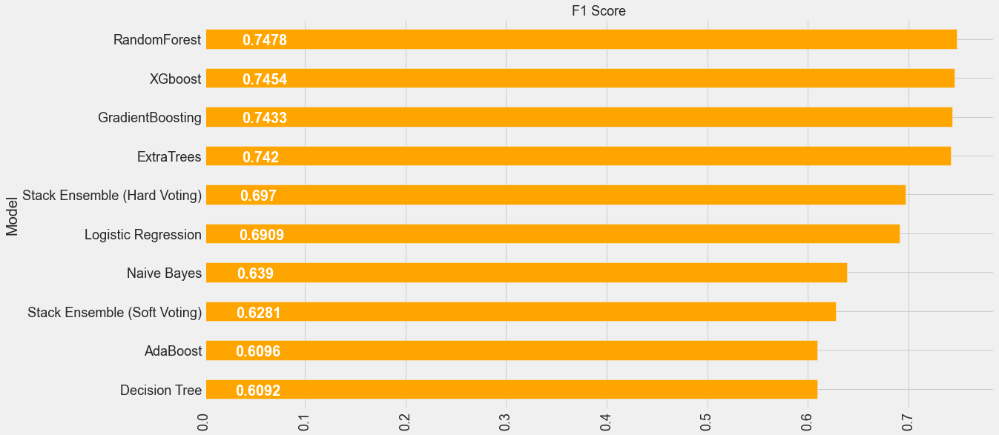

In [253]:
ax = scoreDF['F1 Score'].sort_values().round(6).plot(kind = 'barh', color = 'orange', figsize = (17,9));
# create a list to collect the plt.patches data
totals = []

# find the values and append to list
for i in ax.patches:
    totals.append(i.get_width())

# set individual bar lables using above list
total = sum(totals)
# set individual bar lables using above list
for i in ax.patches:
    # get_width pulls left or right; get_y pushes up or down
    ax.text(i.get_width()*0.05, i.get_y()+0.1, \
            str(round((i.get_width()), 4)), fontsize=20,
color='white', fontweight = 'bold')
    
plt.title('F1 Score', fontsize = 18)
plt.xticks(rotation = 90)
plt.show();



In [254]:
# Create copy of previous results

train_accuracy_ =  train_accuracy
test_accuracy_ = test_accuracy
precision_ = precision
recall_ = recall
f1_ = f1
cohen_kappa_ = cohen_kappa
models_ = models
roc_ = roc
mathew_ = mathew

# Feature Selection - Random Forest Variable Importance

In [62]:
# instantiate the classifier with n_estimators = 100
clf = RandomForestClassifier(n_estimators=500, max_depth = 15, random_state=0)
# fit the classifier to the training set
clf.fit(X_train, y_train)

# predict on the test set
y_pred = clf.predict(X_test)
# visualize feature importance

RandomForestClassifier(max_depth=15, n_estimators=500, random_state=0)

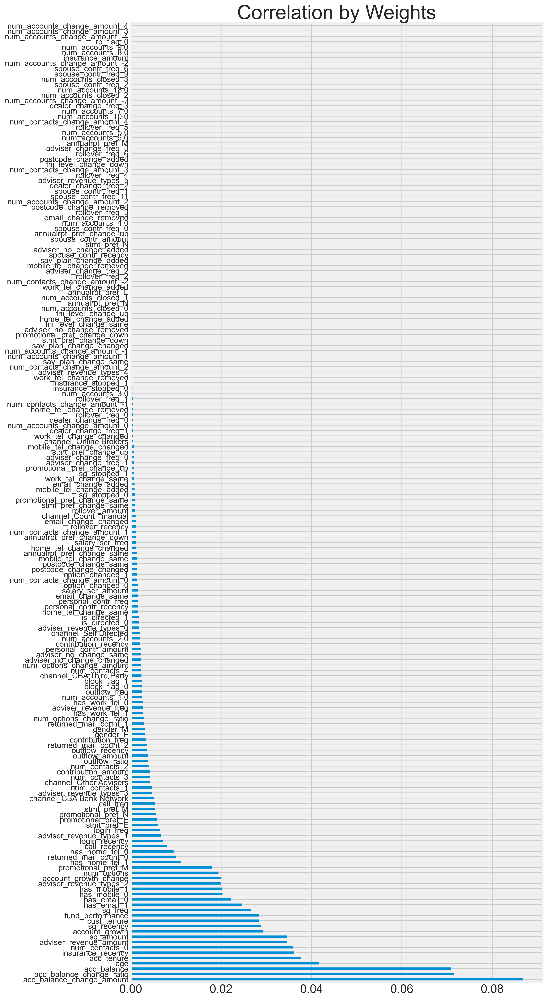

In [63]:
plt.figure(num=None, figsize=(10,25), dpi=320, facecolor='w', edgecolor='k')

feat_importances = pd.Series(clf.feature_importances_, index= X_train.columns)
feat_importances.nlargest(180).plot(kind='barh')
plt.title('Correlation by Weights')
plt.yticks(fontsize = 12)
plt.show();

Naive Bayes

 clasification report:
               precision    recall  f1-score   support

           0       0.94      0.75      0.84     21258
           1       0.33      0.73      0.46      3615

    accuracy                           0.75     24873
   macro avg       0.64      0.74      0.65     24873
weighted avg       0.85      0.75      0.78     24873


 confussion matrix:
 [[16000  5258]
 [  979  2636]]


Logistic Regression

 clasification report:
               precision    recall  f1-score   support

           0       0.95      0.82      0.88     21258
           1       0.41      0.72      0.52      3615

    accuracy                           0.81     24873
   macro avg       0.68      0.77      0.70     24873
weighted avg       0.87      0.81      0.83     24873


 confussion matrix:
 [[17433  3825]
 [ 1005  2610]]


Decision Tree

 clasification report:
               precision    recall  f1-score   support

           0       0.94      0.70      0.80     21258
      

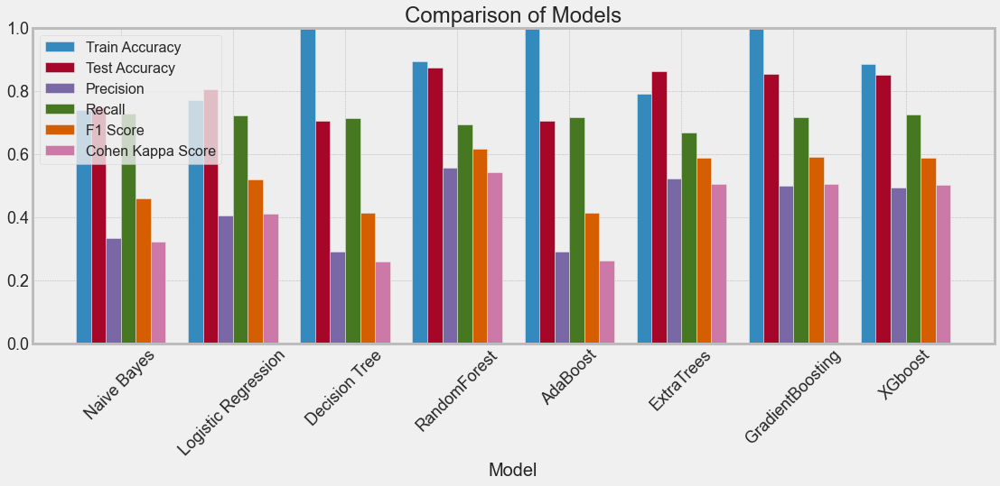

In [64]:
features_to_select = feat_importances.nlargest(100).index.tolist()

X_train = X_train[features_to_select]
X_test = X_test[features_to_select]

train_accuracy = []
test_accuracy = []
precision = []
recall = []
f1 = []
cohen_kappa = []
models = ["Naive Bayes","Logistic Regression","Decision Tree","RandomForest", "AdaBoost", "ExtraTrees","GradientBoosting","XGboost"]
roc = []
mathew = []
random_state = 2
classifiers = []
classifiers.append(BernoulliNB())
classifiers.append(LogisticRegression())
classifiers.append(DecisionTreeClassifier())
classifiers.append(RandomForestClassifier(random_state=random_state, max_depth = 15, max_features = 'auto', n_estimators=  500))
classifiers.append(AdaBoostClassifier(DecisionTreeClassifier(random_state=random_state),random_state=random_state,learning_rate=0.5))
classifiers.append(ExtraTreesClassifier(random_state=random_state, criterion ='gini', max_features = 'auto', min_samples_leaf = 20, min_samples_split = 15))
classifiers.append(GradientBoostingClassifier(random_state=random_state, learning_rate = 0.01, max_depth = 15, n_estimators = 500))
classifiers.append(XGBClassifier(random_state = random_state))



for classifier,model in zip(classifiers, models):
    print('='*len(model))
    print(model)
    print('='*len(model))
    classifier.fit(X_train, y_train)
    trainprediction = classifier.predict(X_train)
    prediction = classifier.predict(X_test)
    trainaccuracy = accuracy_score(y_train, trainprediction)
    testaccuracy = accuracy_score(y_test, prediction)
    train_accuracy.append(trainaccuracy)
    test_accuracy.append(testaccuracy)
    precision.append(precision_score(y_test, prediction))
    recall.append(recall_score(y_test, prediction))
    cohen_kappa.append(cohen_kappa_score(y_test, prediction))
    f1.append(f1_score(y_test, prediction))
    roc.append(metrics.roc_auc_score(y_test, prediction))

    mathew.append(metrics.matthews_corrcoef(y_test, prediction))

    print('\n clasification report:\n', classification_report(y_test,prediction))
    print('\n confussion matrix:\n',confusion_matrix(y_test, prediction))
    print('\n')
    
scoreDF = pd.DataFrame({'Model' : models})
scoreDF['Train Accuracy'] = train_accuracy
scoreDF['Test Accuracy'] = test_accuracy
scoreDF['Precision'] =  precision
scoreDF['Recall'] =  recall
scoreDF['F1 Score'] = f1 
scoreDF['AUC Score'] = roc 
scoreDF['Matthew Correlation Coefficient'] = mathew
scoreDF['Cohen Kappa Score'] = cohen_kappa


scoreDF.set_index("Model")

plt.style.use('bmh')
params = {'legend.fontsize': '16',
          'figure.figsize': (15, 5),
         'axes.labelsize': '20',
         'axes.titlesize':'30',
         'xtick.labelsize':'18',
         'ytick.labelsize':'18'}
plt.rcParams.update(params)

def subcategorybar(X, vals, width=0.8):
    cols = ['Train Accuracy', 'Test Accuracy', 'Precision', 'Recall','F1 Score', 'Cohen Kappa Score']
    n = len(vals)
    _X = np.arange(len(X))
    for i in range(n):
        plt.bar(_X - width/2. + i/float(n)*width, vals[i], width=width/float(n), align="edge")   
        
        
    plt.xticks(_X, X)
    
plt.figure(figsize = (17,6))
subcategorybar(models, [scoreDF['Train Accuracy'], scoreDF['Test Accuracy'], scoreDF['Precision'], scoreDF['Recall'], scoreDF['F1 Score'], scoreDF['Cohen Kappa Score']])
plt.ylim(0, 1.0)
cols = ['Train Accuracy', 'Test Accuracy', 'Precision', 'Recall','F1 Score', 'Cohen Kappa Score']
plt.legend(cols)
plt.xlabel('Model', fontsize = 20)
plt.xticks(rotation = 45)

plt.title("Comparison of Models", fontsize = 24)
plt.show();

# Feature Selection Method - Recursive Feature Elimination


In [65]:
from sklearn.feature_selection import RFE
from sklearn.metrics import cohen_kappa_score
X_train, X_test, y_train, y_test = train_test_split(x,y, test_size=0.20, shuffle=True)
X_train.replace([np.inf, -np.inf], np.nan, inplace=True)
X_test.replace([np.inf, -np.inf], np.nan, inplace=True)
X_train = X_train.fillna(method='ffill')
X_test = X_test.fillna(method='bfill')

### Applying SMOTE on training data

from imblearn.over_sampling import SMOTE
X_train, y_train = SMOTE('minority').fit_resample(X_train, y_train)
Y_train = y_train.copy()

print('Train data shape: {}'.format(X_train.shape))
print('Test data shape: {}'.format(X_test.shape))

rfe_selector = RFE(estimator=GradientBoostingClassifier(), n_features_to_select=100, step=10, verbose=3)
rfe_selector.fit(X_train, y_train)

Train data shape: (171080, 193)
Test data shape: (24873, 193)
Fitting estimator with 193 features.
Fitting estimator with 183 features.
Fitting estimator with 173 features.
Fitting estimator with 163 features.
Fitting estimator with 153 features.
Fitting estimator with 143 features.
Fitting estimator with 133 features.
Fitting estimator with 123 features.
Fitting estimator with 113 features.
Fitting estimator with 103 features.


RFE(estimator=GradientBoostingClassifier(), n_features_to_select=100, step=10,
    verbose=3)

In [66]:
rfe_support = rfe_selector.get_support()
rfe_feature = X_train.loc[:,rfe_support].columns.tolist()
print(str(len(rfe_feature)), 'selected features')

100 selected features


In [67]:
X_train = X_train[rfe_feature]
X_test = X_test[rfe_feature]

In [68]:
train_accuracy = []
test_accuracy = []
precision = []
recall = []
f1 = []
cohen_kappa = []
models = ["Naive Bayes","Logistic Regression","Decision Tree","RandomForest", "AdaBoost", "ExtraTrees","GradientBoosting","XGboost"]
roc = []
mathew = []
random_state = 2
classifiers = []
classifiers.append(BernoulliNB())
classifiers.append(LogisticRegression())
classifiers.append(DecisionTreeClassifier())
classifiers.append(RandomForestClassifier(random_state=random_state, max_depth = 15, max_features = 'auto', n_estimators=  500))
classifiers.append(AdaBoostClassifier(DecisionTreeClassifier(random_state=random_state),random_state=random_state,learning_rate=0.5))
classifiers.append(ExtraTreesClassifier(random_state=random_state, criterion ='gini', max_features = 'auto', min_samples_leaf = 20, min_samples_split = 15))
classifiers.append(GradientBoostingClassifier(random_state=random_state, learning_rate = 0.01, max_depth = 15, n_estimators = 500))
classifiers.append(XGBClassifier(random_state = random_state))



for classifier,model in zip(classifiers, models):
    print('='*len(model))
    print(model)
    print('='*len(model))
    classifier.fit(X_train, y_train)
    trainprediction = classifier.predict(X_train)
    prediction = classifier.predict(X_test)
    trainaccuracy = accuracy_score(y_train, trainprediction)
    testaccuracy = accuracy_score(y_test, prediction)
    train_accuracy.append(trainaccuracy)
    test_accuracy.append(testaccuracy)
    precision.append(precision_score(y_test, prediction))
    recall.append(recall_score(y_test, prediction))
    cohen_kappa.append(cohen_kappa_score(y_test, prediction))
    f1.append(f1_score(y_test, prediction))
    roc.append(metrics.roc_auc_score(y_test, prediction))

    mathew.append(metrics.matthews_corrcoef(y_test, prediction))

    print('\n clasification report:\n', classification_report(y_test,prediction))
    print('\n confussion matrix:\n',confusion_matrix(y_test, prediction))
    print('\n')
    
scoreDF = pd.DataFrame({'Model' : models})
scoreDF['Train Accuracy'] = train_accuracy
scoreDF['Test Accuracy'] = test_accuracy
scoreDF['Precision'] =  precision
scoreDF['Recall'] =  recall
scoreDF['F1 Score'] = f1 
scoreDF['AUC Score'] = roc 
scoreDF['Matthew Correlation Coefficient'] = mathew
scoreDF['Cohen Kappa Score'] = cohen_kappa


scoreDF.set_index("Model")

Naive Bayes


BernoulliNB()


 clasification report:
               precision    recall  f1-score   support

           0       0.94      0.75      0.83     21300
           1       0.33      0.73      0.45      3573

    accuracy                           0.75     24873
   macro avg       0.63      0.74      0.64     24873
weighted avg       0.85      0.75      0.78     24873


 confussion matrix:
 [[15957  5343]
 [  977  2596]]


Logistic Regression


LogisticRegression()


 clasification report:
               precision    recall  f1-score   support

           0       0.95      0.81      0.87     21300
           1       0.39      0.72      0.51      3573

    accuracy                           0.80     24873
   macro avg       0.67      0.77      0.69     24873
weighted avg       0.87      0.80      0.82     24873


 confussion matrix:
 [[17259  4041]
 [ 1000  2573]]


Decision Tree


DecisionTreeClassifier()


 clasification report:
               precision    recall  f1-score   support

           0       0.92      0.88      0.90     21300
           1       0.44      0.57      0.49      3573

    accuracy                           0.83     24873
   macro avg       0.68      0.72      0.70     24873
weighted avg       0.85      0.83      0.84     24873


 confussion matrix:
 [[18708  2592]
 [ 1547  2026]]


RandomForest


RandomForestClassifier(max_depth=15, n_estimators=500, random_state=2)


 clasification report:
               precision    recall  f1-score   support

           0       0.94      0.94      0.94     21300
           1       0.64      0.64      0.64      3573

    accuracy                           0.90     24873
   macro avg       0.79      0.79      0.79     24873
weighted avg       0.90      0.90      0.90     24873


 confussion matrix:
 [[19986  1314]
 [ 1287  2286]]


AdaBoost


AdaBoostClassifier(base_estimator=DecisionTreeClassifier(random_state=2),
                   learning_rate=0.5, random_state=2)


 clasification report:
               precision    recall  f1-score   support

           0       0.92      0.88      0.90     21300
           1       0.43      0.57      0.49      3573

    accuracy                           0.83     24873
   macro avg       0.68      0.72      0.70     24873
weighted avg       0.85      0.83      0.84     24873


 confussion matrix:
 [[18656  2644]
 [ 1541  2032]]


ExtraTrees


ExtraTreesClassifier(min_samples_leaf=20, min_samples_split=15, random_state=2)


 clasification report:
               precision    recall  f1-score   support

           0       0.94      0.91      0.92     21300
           1       0.55      0.65      0.60      3573

    accuracy                           0.87     24873
   macro avg       0.74      0.78      0.76     24873
weighted avg       0.88      0.87      0.88     24873


 confussion matrix:
 [[19377  1923]
 [ 1238  2335]]


GradientBoosting


GradientBoostingClassifier(learning_rate=0.01, max_depth=15, n_estimators=500,
                           random_state=2)


 clasification report:
               precision    recall  f1-score   support

           0       0.94      0.96      0.95     21300
           1       0.72      0.61      0.66      3573

    accuracy                           0.91     24873
   macro avg       0.83      0.78      0.80     24873
weighted avg       0.90      0.91      0.91     24873


 confussion matrix:
 [[20470   830]
 [ 1410  2163]]


XGboost
[00:50:58] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=6,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=12, num_parallel_tree=1, random_state=2,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)


 clasification report:
               precision    recall  f1-score   support

           0       0.94      0.96      0.95     21300
           1       0.72      0.61      0.66      3573

    accuracy                           0.91     24873
   macro avg       0.83      0.79      0.80     24873
weighted avg       0.91      0.91      0.91     24873


 confussion matrix:
 [[20452   848]
 [ 1394  2179]]




,Train Accuracy,Test Accuracy,Precision,Recall,F1 Score,AUC Score,Matthew Correlation Coefficient,Cohen Kappa Score
Model,,,,,,,,
Naive Bayes,0.74886,0.74591,0.32699,0.72656,0.45101,0.73786,0.35792,0.31536
Logistic Regression,0.77858,0.79733,0.38902,0.72012,0.50515,0.76520,0.42106,0.39168
Decision Tree,1.00000,0.83359,0.43872,0.56703,0.49469,0.72267,0.40170,0.39702
RandomForest,0.92672,0.89543,0.63500,0.63980,0.63739,0.78905,0.57630,0.57630
AdaBoost,1.00000,0.83175,0.43456,0.56871,0.49267,0.72229,0.39909,0.39397
ExtraTrees,0.86136,0.87291,0.54838,0.65351,0.59635,0.78162,0.52444,0.52162
GradientBoosting,0.98504,0.90994,0.72269,0.60537,0.65885,0.78320,0.61060,0.60744
XGboost,0.94955,0.90986,0.71985,0.60985,0.66030,0.78502,0.61153,0.60875


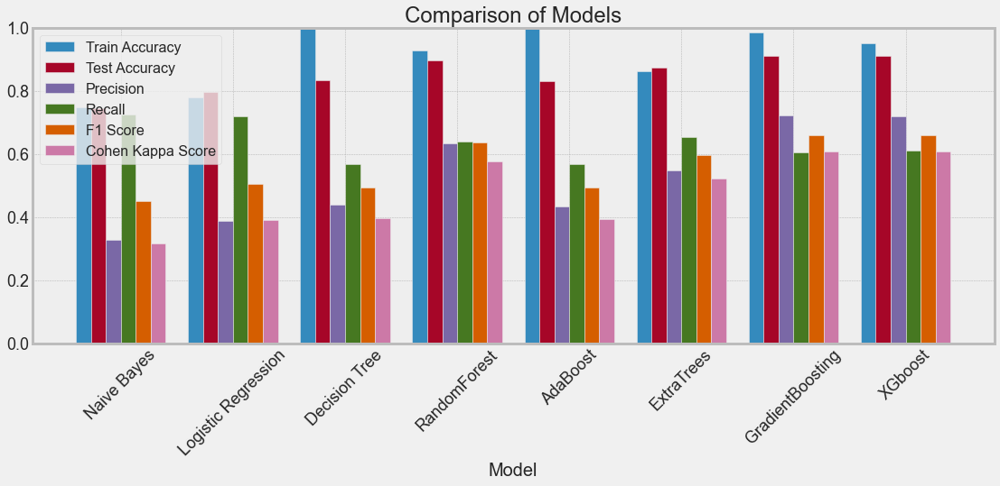

In [69]:
plt.style.use('bmh')
params = {'legend.fontsize': '16',
          'figure.figsize': (15, 5),
         'axes.labelsize': '20',
         'axes.titlesize':'30',
         'xtick.labelsize':'18',
         'ytick.labelsize':'18'}
plt.rcParams.update(params)

def subcategorybar(X, vals, width=0.8):
    cols = ['Train Accuracy', 'Test Accuracy', 'Precision', 'Recall','F1 Score', 'Cohen Kappa Score']
    n = len(vals)
    _X = np.arange(len(X))
    for i in range(n):
        plt.bar(_X - width/2. + i/float(n)*width, vals[i], width=width/float(n), align="edge")   
        
        
    plt.xticks(_X, X)
    
plt.figure(figsize = (17,6))
subcategorybar(models, [scoreDF['Train Accuracy'], scoreDF['Test Accuracy'], scoreDF['Precision'], scoreDF['Recall'], scoreDF['F1 Score'], scoreDF['Cohen Kappa Score']])
plt.ylim(0, 1.0)
cols = ['Train Accuracy', 'Test Accuracy', 'Precision', 'Recall','F1 Score', 'Cohen Kappa Score']
plt.legend(cols)
plt.xlabel('Model', fontsize = 20)
plt.xticks(rotation = 45)

plt.title("Comparison of Models", fontsize = 24)
plt.show();

# Ensemble on Simple base Models

### Simple Averaging

In [255]:
random_state = 123
LR = LogisticRegression(random_state = random_state, n_jobs=-1)
NB = BernoulliNB()
KNN = KNeighborsClassifier(n_jobs=-1)
DT = DecisionTreeClassifier(random_state=random_state)
RF = RandomForestClassifier(random_state=random_state)
BG = BaggingClassifier()
XGB = XGBClassifier()
ADA = AdaBoostClassifier()
GBM = GradientBoostingClassifier()
ET = ExtraTreesClassifier()


LR.fit(X_train, y_train)
NB.fit(X_train, y_train)
RF.fit(X_train, y_train)
KNN.fit(X_train, y_train)
DT.fit(X_train, y_train)
BG.fit(X_train, y_train)
XGB.fit(X_train, y_train)
ADA.fit(X_train, y_train)
GBM.fit(X_train, y_train)
ET.fit(X_train, y_train)

LogisticRegression(n_jobs=-1, random_state=123)

BernoulliNB()

RandomForestClassifier(random_state=123)

KNeighborsClassifier(n_jobs=-1)

DecisionTreeClassifier(random_state=123)

BaggingClassifier()

[23:11:22] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=6,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=12, num_parallel_tree=1, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

AdaBoostClassifier()

GradientBoostingClassifier()

ExtraTreesClassifier()

In [71]:
LR_pred = LR.predict(X_test)
NB_pred = NB.predict(X_test)
RF_pred = RF.predict(X_test)
KNN_pred = KNN.predict(X_test)
DT_pred = DT.predict(X_test)
BG_pred = BG.predict(X_test)
ADA_pred = BG.predict(X_test)
XGB_pred = BG.predict(X_test)
ET_pred = BG.predict(X_test)
GBM_pred = BG.predict(X_test)

In [72]:
averaged_preds = (LR_pred + NB_pred + RF_pred + KNN_pred + DT_pred + BG_pred + ADA_pred +XGB_pred + ET_pred + GBM_pred)//10
acc = accuracy_score(y_test, averaged_preds)
print('\n Accuracy Score:\n', np.round(acc, 3))
                            
print('\n clasification report:\n', classification_report(y_test,averaged_preds))
print('\n confussion matrix:\n', metrics.confusion_matrix(y_test, averaged_preds))
print('\n Cohen Kappa Score:\n', metrics.cohen_kappa_score(y_test, averaged_preds))

print('\n')


 Accuracy Score:
 0.905

 clasification report:
               precision    recall  f1-score   support

           0       0.92      0.98      0.95     21300
           1       0.79      0.47      0.59      3573

    accuracy                           0.91     24873
   macro avg       0.85      0.72      0.77     24873
weighted avg       0.90      0.91      0.89     24873


 confussion matrix:
 [[20848   452]
 [ 1900  1673]]

 Cohen Kappa Score:
 0.5376893819418551




### Weighted Averaging

In [73]:
ensemble = VotingClassifier(estimators=[('Logistic Regression', LogisticRegression(random_state = random_state)),
                                              ('Naive Bayes', GaussianNB()),
                                              ('RF', RandomForestClassifier(random_state=random_state)),
                                              ('KNN', KNeighborsClassifier()),
                                              ('Decision Tree', DecisionTreeClassifier(random_state=random_state)),
                                       ('Bagging Classifier', BaggingClassifier(random_state = random_state)),
                                              ('GBM', GradientBoostingClassifier()),
                                              ('ADA', AdaBoostClassifier(random_state=random_state)),
                                              ('ET', ExtraTreesClassifier()),
                                              ('XGB', XGBClassifier(random_state=random_state))
                                       
                                       
                                       
                                       ], 
                                               voting='hard').fit(X_train,y_train)

y_pred_ensemble = ensemble.predict(X_test)


[01:04:48] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.



 Accuracy Score:
 0.903



 clasification report:
               precision    recall  f1-score   support

           0       0.94      0.95      0.94     21300
           1       0.67      0.63      0.65      3573

    accuracy                           0.90     24873
   macro avg       0.80      0.79      0.80     24873
weighted avg       0.90      0.90      0.90     24873


 Cohen Kappa Score:
 0.5934717219745201


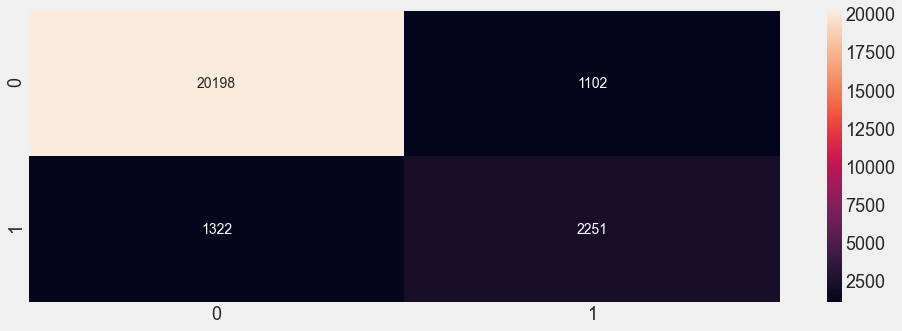

In [74]:
y_train_ensemble = ensemble.predict(X_train)
y_pred_ensemble = ensemble.predict(X_test)

trainaccuracy = accuracy_score(y_train, y_train_ensemble)
testaccuracy = accuracy_score(y_test, y_pred_ensemble)
train_accuracy.append(trainaccuracy)
test_accuracy.append(testaccuracy)
precision.append(precision_score(y_test, y_pred_ensemble, average='macro'))
recall.append(recall_score(y_test, y_pred_ensemble, average='macro'))
cohen_kappa.append(cohen_kappa_score(y_test, y_pred_ensemble))
f1.append(f1_score(y_test, y_pred_ensemble, average='macro'))
roc.append(metrics.roc_auc_score(y_test, y_pred_ensemble))
mathew.append(metrics.matthews_corrcoef(y_test, y_pred_ensemble))

print('\n Accuracy Score:\n', np.round(accuracy_score(y_test, y_pred_ensemble), 3))
sns.heatmap(confusion_matrix(y_test,y_pred_ensemble),annot=True,fmt='2.0f')
print('\n clasification report:\n', classification_report(y_test,y_pred_ensemble))
print('\n Cohen Kappa Score:\n', metrics.cohen_kappa_score(y_test, y_pred_ensemble))

plt.show()

### Max Voting

[01:47:56] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.

 Accuracy Score:
 0.898



 clasification report:
               precision    recall  f1-score   support

           0       0.94      0.94      0.94     21300
           1       0.65      0.65      0.65      3573

    accuracy                           0.90     24873
   macro avg       0.79      0.79      0.79     24873
weighted avg       0.90      0.90      0.90     24873


 Cohen Kappa Score:
 0.5864697851239656


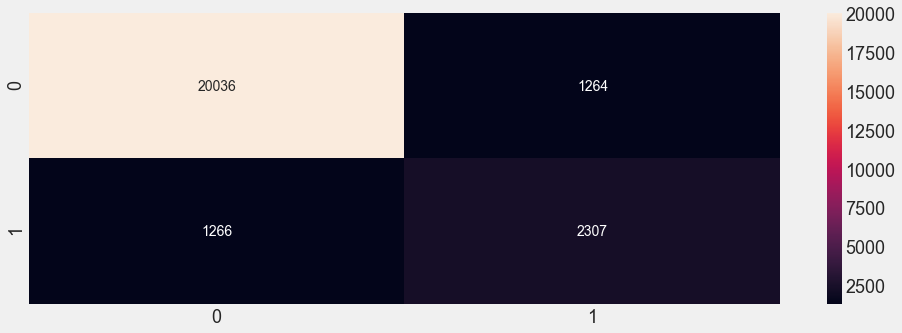

In [82]:
ensemble = VotingClassifier(estimators=[('Logistic Regression', LogisticRegression(random_state = random_state)),
                                              ('Naive Bayes', GaussianNB()),
                                              ('RF', RandomForestClassifier(random_state=random_state)),
                                              ('KNN', KNeighborsClassifier()),
                                              ('Decision Tree', DecisionTreeClassifier(random_state=random_state)),
                                       ('Bagging Classifier', BaggingClassifier(random_state = random_state)),
                                              ('GBM', GradientBoostingClassifier()),
                                              ('ADA', AdaBoostClassifier(random_state=random_state)),
                                              ('ET', ExtraTreesClassifier()),
                                              ('XGB', XGBClassifier(random_state=random_state))
                                       
                                       
                                       
                                       ], 
                                               voting='soft').fit(X_train,y_train)

y_pred_ensemble = ensemble.predict(X_test)

y_train_ensemble = ensemble.predict(X_train)
y_pred_ensemble = ensemble.predict(X_test)

trainaccuracy = accuracy_score(y_train, y_train_ensemble)
testaccuracy = accuracy_score(y_test, y_pred_ensemble)
train_accuracy.append(trainaccuracy)
test_accuracy.append(testaccuracy)
precision.append(precision_score(y_test, y_pred_ensemble, average='macro'))
recall.append(recall_score(y_test, y_pred_ensemble, average='macro'))
cohen_kappa.append(cohen_kappa_score(y_test, y_pred_ensemble))
f1.append(f1_score(y_test, y_pred_ensemble, average='macro'))
roc.append(metrics.roc_auc_score(y_test, y_pred_ensemble))
mathew.append(metrics.matthews_corrcoef(y_test, y_pred_ensemble))


print('\n Accuracy Score:\n', np.round(accuracy_score(y_test, y_pred_ensemble), 3))
sns.heatmap(confusion_matrix(y_test,y_pred_ensemble),annot=True,fmt='2.0f')
print('\n clasification report:\n', classification_report(y_test,y_pred_ensemble))
print('\n Cohen Kappa Score:\n', metrics.cohen_kappa_score(y_test, y_pred_ensemble))
plt.show()

In [89]:
models = ['Naive Bayes', 'Logistic Regression', 'Decision Tree',
           'RandomForest', 'AdaBoost', 'ExtraTrees', 'GradientBoosting', 
           'XGboost', 'Stack Ensemble (Hard Voting)', 'Stack Ensemble (Soft Voting)']

In [93]:
train_accuracy

[0.7488601823708206,
 0.778583119008651,
 1.0,
 0.926724339490297,
 1.0,
 0.8613572597615151,
 0.9850362403553893,
 0.9495499181669395,
 0.9819499649286884,
 0.9905190554126725,
 0.9901098901098901]

In [94]:
scoreDF = pd.DataFrame({'Model' : models})
scoreDF['Train Accuracy'] = train_accuracy[:10]
scoreDF['Test Accuracy'] = test_accuracy[:10]
scoreDF['Precision'] =  precision[:10]
scoreDF['Recall'] =  recall[:10]
scoreDF['F1 Score'] = f1[:10]
scoreDF['AUC Score'] = roc[:10]
scoreDF['Matthew Correlation Coefficient'] = mathew[:10]
scoreDF['Cohen Kappa Score'] = cohen_kappa[:10]

scoreDF = scoreDF.set_index("Model")


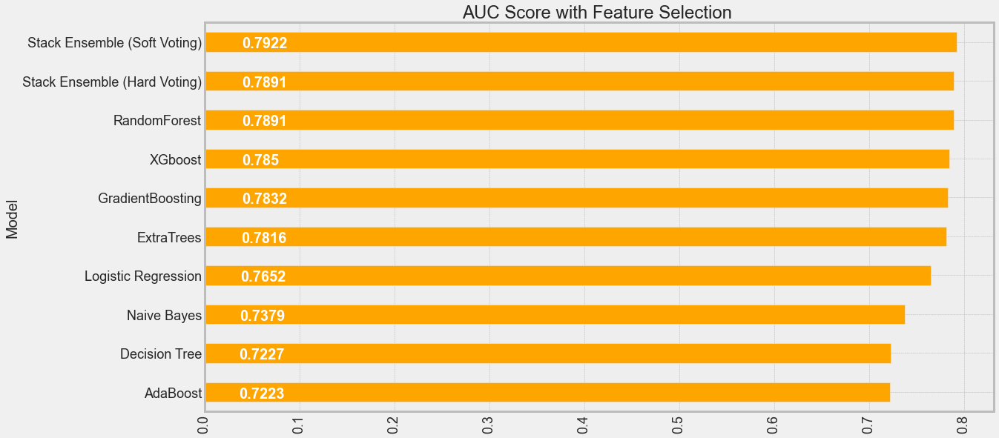

In [95]:
ax = scoreDF['AUC Score'].sort_values().round(6).plot(kind = 'barh', color = 'orange', figsize = (17,9));
# create a list to collect the plt.patches data
totals = []

# find the values and append to list
for i in ax.patches:
    totals.append(i.get_width())

# set individual bar lables using above list
total = sum(totals)
# set individual bar lables using above list
for i in ax.patches:
    # get_width pulls left or right; get_y pushes up or down
    ax.text(i.get_width()*0.05, i.get_y()+0.1, \
            str(round((i.get_width()), 4)), fontsize=20,
color='white', fontweight = 'bold')
    
plt.title('AUC Score with Feature Selection ', fontsize = 24)
plt.xticks(rotation = 90)
plt.show();



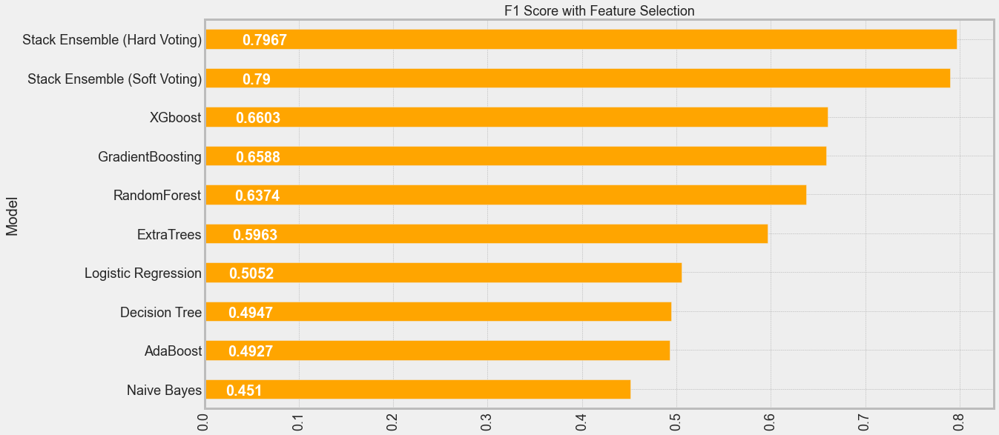

In [96]:
ax = scoreDF['F1 Score'].sort_values().round(6).plot(kind = 'barh', color = 'orange', figsize = (17,9));
# create a list to collect the plt.patches data
totals = []

# find the values and append to list
for i in ax.patches:
    totals.append(i.get_width())

# set individual bar lables using above list
total = sum(totals)
# set individual bar lables using above list
for i in ax.patches:
    # get_width pulls left or right; get_y pushes up or down
    ax.text(i.get_width()*0.05, i.get_y()+0.1, \
            str(round((i.get_width()), 4)), fontsize=20,
color='white', fontweight = 'bold')
    
plt.title('F1 Score with Feature Selection', fontsize = 18)
plt.xticks(rotation = 90)
plt.show();



## Deep Learning based Ensembles

In [256]:
import scipy
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPooling2D,AveragePooling2D
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.callbacks import LearningRateScheduler,ReduceLROnPlateau
from tensorflow.keras.optimizers import Adam # I believe this is better optimizer for our case
from tensorflow.keras.preprocessing.image import ImageDataGenerator # to augmenting our images for increasing accuracy
from tensorflow.keras.utils import plot_model

In [257]:
scaler = MinMaxScaler(feature_range=(0, 1))
X_train = scaler.fit_transform(X_train)
X_test  = scaler.transform(X_test)

In [259]:
X_train = pd.DataFrame(X_train)
X_test = pd.DataFrame(X_test)

In [260]:
def model_ANN1(input_shape=X_train.shape[1], num_classes=2):   
    model = Sequential()

    model.add(Dense(128, activation='tanh', input_dim=X_train.shape[1]))
    model.add(Dropout(0.2))
    model.add(Dense(64, activation='relu'))
    model.add(Dropout(0.2))
    model.add(Dense(32, activation='relu'))
    model.add(Dropout(0.2))
    model.add(Dense(16, activation='relu'))
    model.add(Dropout(0.2))
    model.add(Dense(8, activation='relu'))
    model.add(Dropout(0.2))
    # Lets add softmax activated neurons as much as number of classes
    model.add(Dense(1, activation = "sigmoid"))
    # Compile the model with loss and metrics
    model.compile(optimizer =  Adam(learning_rate = 0.00001, decay = 1e-5) , loss = "binary_crossentropy", metrics=["accuracy"])
    
    return model

In [261]:
def model_ANN2(input_shape=X_train.shape[1], num_classes=2):   
    model = Sequential()
    model.add(Dense(128, activation='tanh',  input_dim=X_train.shape[1]))
    model.add(Dropout(0.4))
    model.add(Dense(32, activation='relu'))
    model.add(Dropout(0.4))
    model.add(Dense(16, activation='relu'))
    model.add(Dropout(0.4))
    model.add(Dense(8, activation='relu'))
    model.add(Dropout(0.4))
    model.add(Dense(4, activation='relu'))
    model.add(Dropout(0.4))

    # Lets add softmax activated neurons as much as number of classes
    model.add(Dense(1, activation = "sigmoid"))
    # Compile the model with loss and metrics
    model.compile(optimizer =  Adam(learning_rate = 0.00001, decay = 1e-5) , loss = "binary_crossentropy", metrics=["accuracy"])
    
    return model

In [262]:
ANN_model1 = model_ANN1(input_shape=X_train.shape[1], num_classes=2)
ANN_model2 = model_ANN2(input_shape=X_train.shape[1], num_classes=2)

Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


In [263]:
ANN_model1.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 128)               24832     
_________________________________________________________________
dropout (Dropout)            (None, 128)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 64)                8256      
_________________________________________________________________
dropout_1 (Dropout)          (None, 64)                0         
_________________________________________________________________
dense_2 (Dense)              (None, 32)                2080      
_________________________________________________________________
dropout_2 (Dropout)          (None, 32)                0         
_________________________________________________________________
dense_3 (Dense)              (None, 16)                5

In [264]:
ANN_model2.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_6 (Dense)              (None, 128)               24832     
_________________________________________________________________
dropout_5 (Dropout)          (None, 128)               0         
_________________________________________________________________
dense_7 (Dense)              (None, 32)                4128      
_________________________________________________________________
dropout_6 (Dropout)          (None, 32)                0         
_________________________________________________________________
dense_8 (Dense)              (None, 16)                528       
_________________________________________________________________
dropout_7 (Dropout)          (None, 16)                0         
_________________________________________________________________
dense_9 (Dense)              (None, 8)                

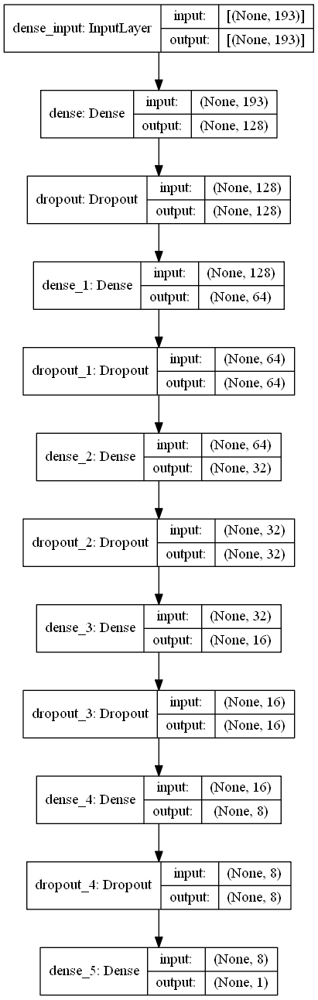

In [265]:
dot_img_file = 'model_1.png'
plot_model(ANN_model1, to_file=dot_img_file, show_shapes=True)

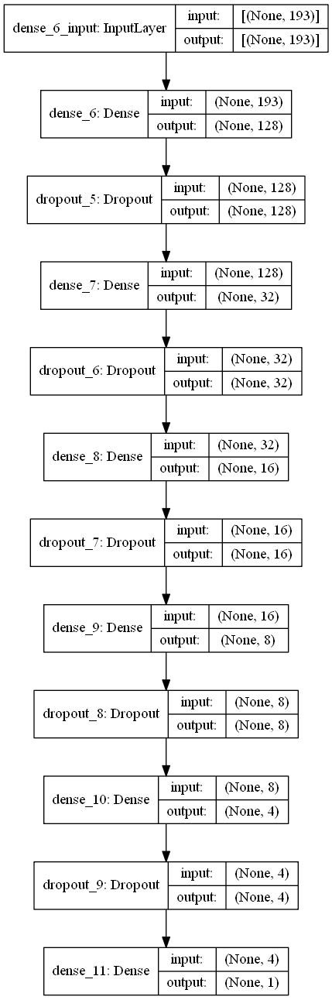

In [266]:
dot_img_file = 'model_2.png'
plot_model(ANN_model2, to_file=dot_img_file, show_shapes=True)

In [267]:
model = []
model.append(ANN_model1)
model.append(ANN_model2)

In [268]:
# Start multiple model training with the batch size
# Use Reduce LR on Plateau for reducing Learning Rate if there is no decrease at loss for 3 epochs
models = []
for i in range(len(model)):
    model[i].fit(X_train,y_train, batch_size=512,
                                        epochs = 100,
                                        validation_data = (X_test,y_test), 
                                        callbacks=[ReduceLROnPlateau(monitor='loss', patience=3, factor=0.1)], 
                                        verbose=2)
    models.append(model[i])

Train on 28062 samples, validate on 24873 samples
Epoch 1/100
28062/28062 - 1s - loss: 0.7087 - acc: 0.5031 - val_loss: 0.6403 - val_acc: 0.7842
Epoch 2/100
28062/28062 - 0s - loss: 0.7016 - acc: 0.5124 - val_loss: 0.6426 - val_acc: 0.7935
Epoch 3/100
28062/28062 - 0s - loss: 0.6946 - acc: 0.5258 - val_loss: 0.6448 - val_acc: 0.7968
Epoch 4/100
28062/28062 - 1s - loss: 0.6881 - acc: 0.5421 - val_loss: 0.6456 - val_acc: 0.7917
Epoch 5/100
28062/28062 - 0s - loss: 0.6842 - acc: 0.5476 - val_loss: 0.6459 - val_acc: 0.7815
Epoch 6/100
28062/28062 - 0s - loss: 0.6787 - acc: 0.5606 - val_loss: 0.6415 - val_acc: 0.7890
Epoch 7/100
28062/28062 - 0s - loss: 0.6753 - acc: 0.5697 - val_loss: 0.6381 - val_acc: 0.7921
Epoch 8/100
28062/28062 - 0s - loss: 0.6692 - acc: 0.5858 - val_loss: 0.6357 - val_acc: 0.7857
Epoch 9/100
28062/28062 - 0s - loss: 0.6678 - acc: 0.5873 - val_loss: 0.6305 - val_acc: 0.7894
Epoch 10/100
28062/28062 - 0s - loss: 0.6625 - acc: 0.5953 - val_loss: 0.6253 - val_acc: 0.7905

Epoch 86/100
28062/28062 - 0s - loss: 0.5610 - acc: 0.7264 - val_loss: 0.5253 - val_acc: 0.8510
Epoch 87/100
28062/28062 - 0s - loss: 0.5635 - acc: 0.7248 - val_loss: 0.5253 - val_acc: 0.8510
Epoch 88/100
28062/28062 - 0s - loss: 0.5581 - acc: 0.7306 - val_loss: 0.5253 - val_acc: 0.8510
Epoch 89/100
28062/28062 - 0s - loss: 0.5599 - acc: 0.7280 - val_loss: 0.5253 - val_acc: 0.8510
Epoch 90/100
28062/28062 - 0s - loss: 0.5630 - acc: 0.7260 - val_loss: 0.5253 - val_acc: 0.8510
Epoch 91/100
28062/28062 - 0s - loss: 0.5585 - acc: 0.7282 - val_loss: 0.5253 - val_acc: 0.8510
Epoch 92/100
28062/28062 - 0s - loss: 0.5612 - acc: 0.7253 - val_loss: 0.5253 - val_acc: 0.8510
Epoch 93/100
28062/28062 - 0s - loss: 0.5609 - acc: 0.7275 - val_loss: 0.5253 - val_acc: 0.8510
Epoch 94/100
28062/28062 - 0s - loss: 0.5592 - acc: 0.7262 - val_loss: 0.5253 - val_acc: 0.8510
Epoch 95/100
28062/28062 - 0s - loss: 0.5576 - acc: 0.7289 - val_loss: 0.5253 - val_acc: 0.8510
Epoch 96/100
28062/28062 - 0s - loss: 0.

Train on 28062 samples, validate on 24873 samples
Epoch 1/100
28062/28062 - 1s - loss: 0.7744 - acc: 0.5006 - val_loss: 0.7575 - val_acc: 0.1454
Epoch 2/100
28062/28062 - 0s - loss: 0.7581 - acc: 0.5041 - val_loss: 0.7427 - val_acc: 0.1581
Epoch 3/100
28062/28062 - 0s - loss: 0.7483 - acc: 0.4996 - val_loss: 0.7322 - val_acc: 0.1755
Epoch 4/100
28062/28062 - 0s - loss: 0.7407 - acc: 0.5023 - val_loss: 0.7250 - val_acc: 0.1894
Epoch 5/100
28062/28062 - 0s - loss: 0.7316 - acc: 0.5063 - val_loss: 0.7187 - val_acc: 0.2122
Epoch 6/100
28062/28062 - 0s - loss: 0.7292 - acc: 0.4949 - val_loss: 0.7139 - val_acc: 0.2327
Epoch 7/100
28062/28062 - 0s - loss: 0.7250 - acc: 0.5026 - val_loss: 0.7100 - val_acc: 0.2598
Epoch 8/100
28062/28062 - 0s - loss: 0.7184 - acc: 0.5042 - val_loss: 0.7072 - val_acc: 0.2774
Epoch 9/100
28062/28062 - 0s - loss: 0.7161 - acc: 0.5032 - val_loss: 0.7043 - val_acc: 0.3107
Epoch 10/100
28062/28062 - 0s - loss: 0.7135 - acc: 0.5025 - val_loss: 0.7025 - val_acc: 0.3333

Epoch 86/100
28062/28062 - 0s - loss: 0.6611 - acc: 0.5939 - val_loss: 0.6807 - val_acc: 0.8310
Epoch 87/100
28062/28062 - 0s - loss: 0.6620 - acc: 0.5914 - val_loss: 0.6807 - val_acc: 0.8310
Epoch 88/100
28062/28062 - 0s - loss: 0.6599 - acc: 0.5928 - val_loss: 0.6807 - val_acc: 0.8310
Epoch 89/100
28062/28062 - 0s - loss: 0.6609 - acc: 0.5899 - val_loss: 0.6807 - val_acc: 0.8310
Epoch 90/100
28062/28062 - 0s - loss: 0.6613 - acc: 0.5931 - val_loss: 0.6807 - val_acc: 0.8310
Epoch 91/100
28062/28062 - 0s - loss: 0.6596 - acc: 0.5961 - val_loss: 0.6807 - val_acc: 0.8310
Epoch 92/100
28062/28062 - 0s - loss: 0.6618 - acc: 0.5951 - val_loss: 0.6807 - val_acc: 0.8310
Epoch 93/100
28062/28062 - 0s - loss: 0.6597 - acc: 0.5954 - val_loss: 0.6807 - val_acc: 0.8310
Epoch 94/100
28062/28062 - 0s - loss: 0.6603 - acc: 0.5911 - val_loss: 0.6807 - val_acc: 0.8310
Epoch 95/100
28062/28062 - 0s - loss: 0.6605 - acc: 0.5906 - val_loss: 0.6807 - val_acc: 0.8310
Epoch 96/100
28062/28062 - 0s - loss: 0.

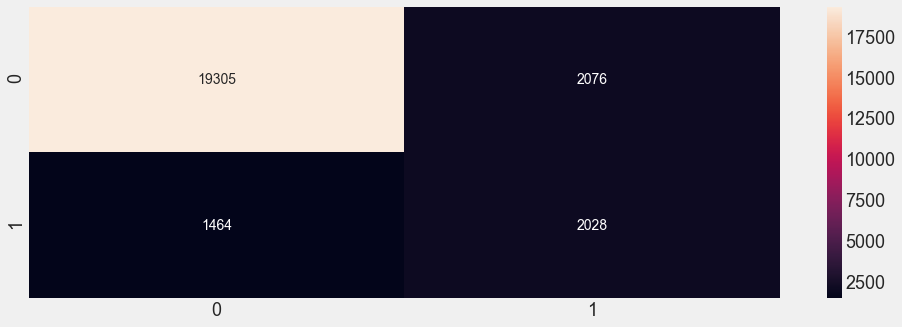

In [269]:
ANN1_preds = (model[0].predict(X_test) > 0.5).astype("int32")
ANN2_preds = (model[1].predict(X_test) > 0.5).astype("int32")
preds = pd.DataFrame({"ANN1" : ANN1_preds.ravel(), "ANN2" : ANN2_preds.ravel()})
ANN_ensemble_predicted = preds.mode(axis=1)
final_preds = ANN_ensemble_predicted.iloc[:, 0].astype("int32")

from sklearn import metrics
CM=metrics.confusion_matrix(y_test,final_preds)
sns.heatmap(CM,annot=True,fmt='2.0f')

TN = CM[0][0]
FN = CM[1][0]
TP = CM[1][1]
FP = CM[0][1]
specificity = TN/(TN+FP)
loss_log = metrics.log_loss(y_test, final_preds)
acc= accuracy_score(y_test, final_preds)
roc=metrics.roc_auc_score(y_test, final_preds)
prec = metrics.precision_score(y_test, final_preds)
rec = metrics.recall_score(y_test, final_preds)
f1 = metrics.f1_score(y_test, final_preds)

mathew = metrics.matthews_corrcoef(y_test, final_preds)    
ck = cohen_kappa_score(y_test, final_preds)

ANN1_preds = (model[0].predict(X_train) > 0.5).astype("int32")
ANN2_preds = (model[1].predict(X_train) > 0.5).astype("int32")
preds = pd.DataFrame({"ANN1" : ANN1_preds.ravel(), "ANN2" : ANN2_preds.ravel()})
ANN_ensemble_predicted = preds.mode(axis=1)
final_preds = ANN_ensemble_predicted.iloc[:, 0].astype("int32")



train_acc= accuracy_score(y_train, final_preds)




In [270]:
model_results =pd.DataFrame([['ANN Ensemble Classifier',train_acc, acc, prec,rec, f1,roc,mathew, ck]],
               columns = ['Model', 'Train Accuracy', 'Test Accuracy','Precision', 'Recall', 'F1 Score','AUC Score','Matthew Correlation Coefficient', 'Cohen Kappa Score'])


model_results = model_results.set_index('Model')

model_results.index.name = None

model_results

,Train Accuracy,Test Accuracy,Precision,Recall,F1 Score,AUC Score,Matthew Correlation Coefficient,Cohen Kappa Score
ANN Ensemble Classifier,0.74350,0.85768,0.49415,0.58076,0.53397,0.74183,0.45267,0.45062


In [271]:
scoreDF = pd.concat([scoreDF.iloc[:10,:8], model_results], axis = 0)
scoreDF

,Train Accuracy,Test Accuracy,Precision,Recall,F1 Score,AUC Score,Matthew Correlation Coefficient,Cohen Kappa Score
Naive Bayes,0.74057,0.74233,0.63251,0.74075,0.63903,0.74075,0.35723,0.31083
Logistic Regression,0.77336,0.80143,0.66822,0.76925,0.69089,0.76925,0.42564,0.39561
Decision Tree,1.00000,0.70784,0.61453,0.71793,0.60924,0.71793,0.31597,0.26475
RandomForest,0.81356,0.85953,0.72296,0.78891,0.74780,0.78891,0.50760,0.49820
AdaBoost,1.00000,0.70759,0.61509,0.71934,0.60959,0.71934,0.31777,0.26585
ExtraTrees,0.78416,0.85732,0.71857,0.77996,0.74202,0.77996,0.49473,0.48643
GradientBoosting,0.99993,0.85189,0.71571,0.79573,0.74331,0.79573,0.50514,0.49079
XGboost,0.88198,0.85265,0.71732,0.79941,0.74544,0.79941,0.51017,0.49518
Stack Ensemble (Hard Voting),0.93946,0.80658,0.67323,0.77500,0.69704,0.77500,0.43652,0.40700
Stack Ensemble (Soft Voting),0.95517,0.72231,0.62964,0.74635,0.62808,0.74635,0.35742,0.29984


Text(0.03589635, -0.15, '0.7179')

Text(0.0359672, 0.85, '0.7193')

Text(0.037037350000000004, 1.85, '0.7407')

Text(0.0370915, 2.85, '0.7418')

Text(0.03731765, 3.85, '0.7464')

Text(0.03846265, 4.85, '0.7693')

Text(0.0387501, 5.85, '0.775')

Text(0.03899775, 6.85, '0.78')

Text(0.03944545, 7.85, '0.7889')

Text(0.03978635, 8.85, '0.7957')

Text(0.0399703, 9.85, '0.7994')

Text(0.5, 1.0, 'AUC Score')

(array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]),
 <a list of 10 Text major ticklabel objects>)

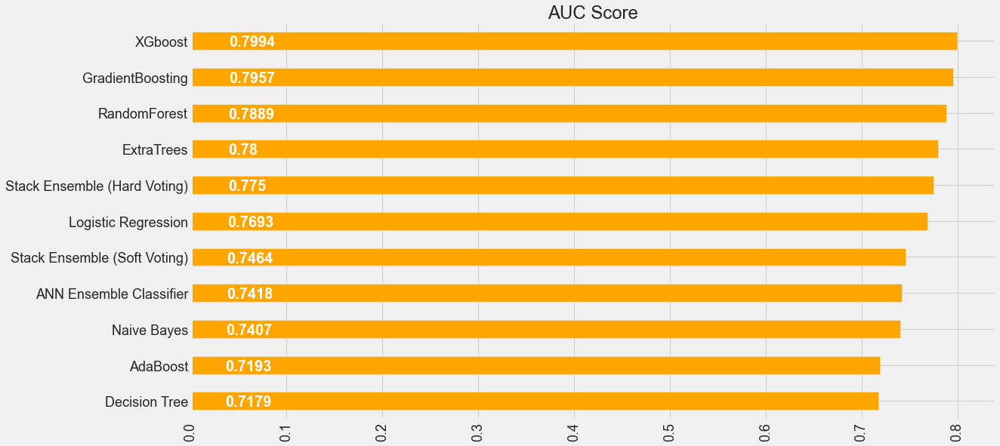

Text(0.026698250000000003, -0.15, '0.534')

Text(0.030462050000000004, 0.85, '0.6092')

Text(0.030479600000000003, 1.85, '0.6096')

Text(0.03140375, 2.85, '0.6281')

Text(0.031951400000000005, 3.85, '0.639')

Text(0.034544750000000006, 4.85, '0.6909')

Text(0.03485205, 5.85, '0.697')

Text(0.037101050000000003, 6.85, '0.742')

Text(0.037165300000000005, 7.85, '0.7433')

Text(0.03727185, 8.85, '0.7454')

Text(0.037390200000000005, 9.85, '0.7478')

Text(0.5, 1.0, 'F1 Score')

(array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8]),
 <a list of 9 Text major ticklabel objects>)

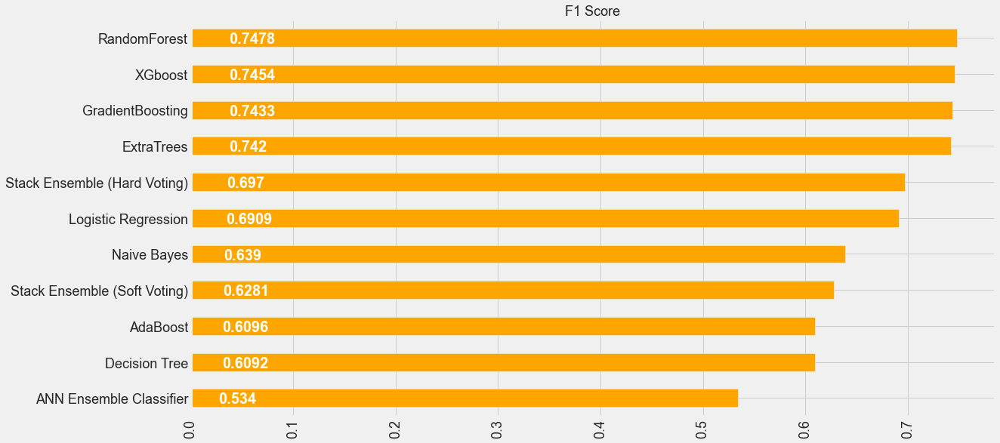

In [272]:
ax = scoreDF['AUC Score'].sort_values().round(6).plot(kind = 'barh', color = 'orange', figsize = (17,9));
# create a list to collect the plt.patches data
totals = []

# find the values and append to list
for i in ax.patches:
    totals.append(i.get_width())

# set individual bar lables using above list
total = sum(totals)
# set individual bar lables using above list
for i in ax.patches:
    # get_width pulls left or right; get_y pushes up or down
    ax.text(i.get_width()*0.05, i.get_y()+0.1, \
            str(round((i.get_width()), 4)), fontsize=20,
color='white', fontweight = 'bold')
    
plt.title('AUC Score', fontsize = 24)
plt.xticks(rotation = 90)
plt.show();



ax = scoreDF['F1 Score'].sort_values().round(6).plot(kind = 'barh', color = 'orange', figsize = (17,9));
# create a list to collect the plt.patches data
totals = []

# find the values and append to list
for i in ax.patches:
    totals.append(i.get_width())

# set individual bar lables using above list
total = sum(totals)
# set individual bar lables using above list
for i in ax.patches:
    # get_width pulls left or right; get_y pushes up or down
    ax.text(i.get_width()*0.05, i.get_y()+0.1, \
            str(round((i.get_width()), 4)), fontsize=20,
color='white', fontweight = 'bold')
    
plt.title('F1 Score', fontsize = 18)
plt.xticks(rotation = 90)
plt.show();



# Create copy of previous results

train_accuracy_ =  train_accuracy
test_accuracy_ = test_accuracy
precision_ = precision
recall_ = recall
f1_ = f1
cohen_kappa_ = cohen_kappa
models_ = models
roc_ = roc
mathew_ = mathew

### ROC AUC Curve

The Receiver Operator Characteristic (ROC) curve is an evaluation metric for binary classification problems. It is a probability curve that plots the TPR against FPR at various threshold values and essentially separates the ‘signal’ from the ‘noise’. The Area Under the Curve (AUC) is the measure of the ability of a classifier to distinguish between classes and is used as a summary of the ROC curve.

The higher the AUC, the better the performance of the model at distinguishing between the positive and negative classes.


When AUC = 1, then the classifier is able to perfectly distinguish between all the Positive and the Negative class points correctly. If, however, the AUC had been 0, then the classifier would be predicting all Negatives as Positives, and all Positives as Negatives.


When 0.5<AUC<1, there is a high chance that the classifier will be able to distinguish the positive class values from the negative class values. This is so because the classifier is able to detect more numbers of True positives and True negatives than False negatives and False positives.


When AUC=0.5, then the classifier is not able to distinguish between Positive and Negative class points. Meaning either the classifier is predicting random class or constant class for all the data points.

So, the higher the AUC value for a classifier, the better its ability to distinguish between positive and negative classes.

In [273]:
def model_ANN1(input_shape=X_train.shape[1], num_classes=2):   
    model = Sequential()

    model.add(Dense(128, activation='tanh', input_dim=X_train.shape[1]))
    model.add(Dropout(0.2))
    model.add(Dense(64, activation='relu'))
    model.add(Dropout(0.2))
    model.add(Dense(32, activation='relu'))
    model.add(Dropout(0.2))
    model.add(Dense(16, activation='relu'))
    model.add(Dropout(0.2))
    model.add(Dense(8, activation='relu'))
    model.add(Dropout(0.2))
    # Lets add softmax activated neurons as much as number of classes
    model.add(Dense(2, activation = "sigmoid"))
    # Compile the model with loss and metrics
    model.compile(optimizer =  Adam(learning_rate = 0.00001, decay = 1e-5) , loss = "categorical_crossentropy", metrics=["accuracy"])
    
    return model

def model_ANN2(input_shape=X_train.shape[1], num_classes=2):   
    model = Sequential()
    model.add(Dense(64, activation='tanh',  input_dim=X_train.shape[1]))
    model.add(Dropout(0.4))
    model.add(Dense(32, activation='relu'))
    model.add(Dropout(0.4))
    model.add(Dense(16, activation='relu'))
    model.add(Dropout(0.4))
    model.add(Dense(8, activation='relu'))
    model.add(Dropout(0.4))
    model.add(Dense(4, activation='relu'))
    model.add(Dropout(0.4))

    # Lets add softmax activated neurons as much as number of classes
    model.add(Dense(2, activation = "sigmoid"))
    # Compile the model with loss and metrics
    model.compile(optimizer =  Adam(learning_rate = 0.00001, decay = 1e-5) , loss = "categorical_crossentropy", metrics=["accuracy"])
    
    return model
import tensorflow as tf
ANN_model1 = model_ANN1(input_shape=X_train.shape[1], num_classes=2)
ANN_model2 = model_ANN2(input_shape=X_train.shape[1], num_classes=2)
model = []
model.append(ANN_model1)
model.append(ANN_model2)
models = []
for i in range(len(model)):
    model[i].fit(X_train,tf.keras.utils.to_categorical(
    y_train, num_classes=2, dtype='float32'
), batch_size=512,
                                        epochs = 100,
                                        validation_data = (X_test,tf.keras.utils.to_categorical(
    y_test, num_classes=2, dtype='float32'
)), 
                                        callbacks=[ReduceLROnPlateau(monitor='loss', patience=3, factor=0.1)], 
                                        verbose=0)
    models.append(model[i])

[<matplotlib.lines.Line2D at 0x2100eb7f898>]

Text(0.5, 0, 'False Positive Rate')

Text(0, 0.5, 'True Positive Rate')

(0.0, 1.0)

(0.0, 1.0)

Text(0.5, 1.0, 'Receiver Operator Characteristic curves')

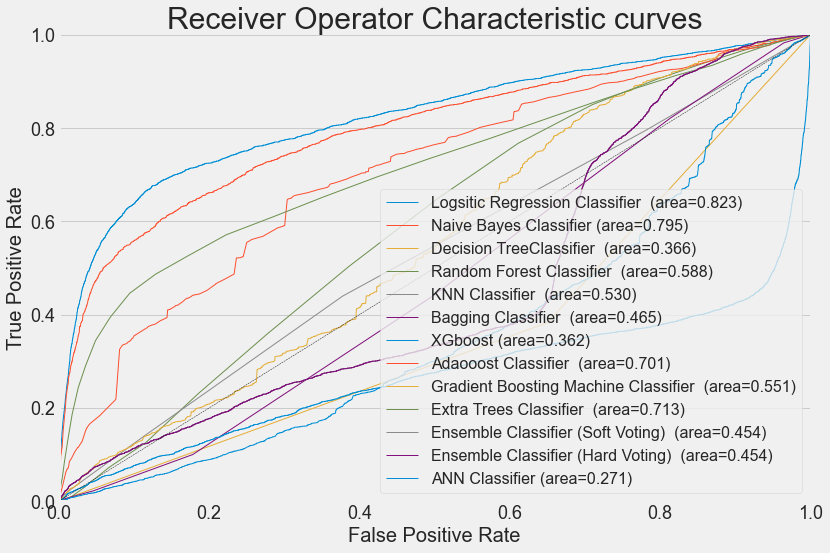

In [274]:
def roc_auc_plot(y_true, y_proba, label=' ', l='-', lw=1.0):
    from sklearn.metrics import roc_curve, roc_auc_score
    fpr, tpr, _ = roc_curve(y_true, y_proba[:,1])
    ax.plot(fpr, tpr, linestyle=l, linewidth=lw,
            label="%s (area=%.3f)"%(label,roc_auc_score(y_true, y_proba[:,1])))

f, ax = plt.subplots(figsize=(12,8))
                                               
                                               
roc_auc_plot(y_test,LR.predict_proba(X_test),label='Logsitic Regression Classifier ',l='-')
roc_auc_plot(y_test,NB.predict_proba(X_test),label='Naive Bayes Classifier',l='-')
roc_auc_plot(y_test,DT.predict_proba(X_test),label='Decision TreeClassifier ',l='-')
roc_auc_plot(y_test,RF.predict_proba(X_test),label='Random Forest Classifier ',l='-')
roc_auc_plot(y_test,KNN.predict_proba(X_test),label='KNN Classifier ',l='-')
                                               
roc_auc_plot(y_test,BG.predict_proba(X_test),label='Bagging Classifier ',l='-')
roc_auc_plot(y_test,XGB.predict_proba(X_test),label='XGboost',l='-')
roc_auc_plot(y_test,ADA.predict_proba(X_test),label='Adaooost Classifier ',l='-')
roc_auc_plot(y_test,GBM.predict_proba(X_test),label='Gradient Boosting Machine Classifier ',l='-')
roc_auc_plot(y_test,ET.predict_proba(X_test),label='Extra Trees Classifier ',l='-')
roc_auc_plot(y_test,ensemble2.predict_proba(X_test),label='Ensemble Classifier (Soft Voting) ',l='-')
roc_auc_plot(y_test,ensemble2.predict_proba(X_test),label='Ensemble Classifier (Hard Voting) ',l='-')
roc_auc_plot(y_test,model[0].predict(X_test),label='ANN Classifier',l='-')



ax.plot([0,1], [0,1], color='k', linewidth=0.5, linestyle='--', 
        )    
ax.legend(loc="lower right")    
ax.set_xlabel('False Positive Rate')
ax.set_ylabel('True Positive Rate')
ax.set_xlim([0, 1])
ax.set_ylim([0, 1])
ax.set_title('Receiver Operator Characteristic curves')
sns.despine()

## Precision Recall curve

Precision-Recall curves summarize the trade-off between the true positive rate and the positive predictive value for a predictive model using different probability thresholds.

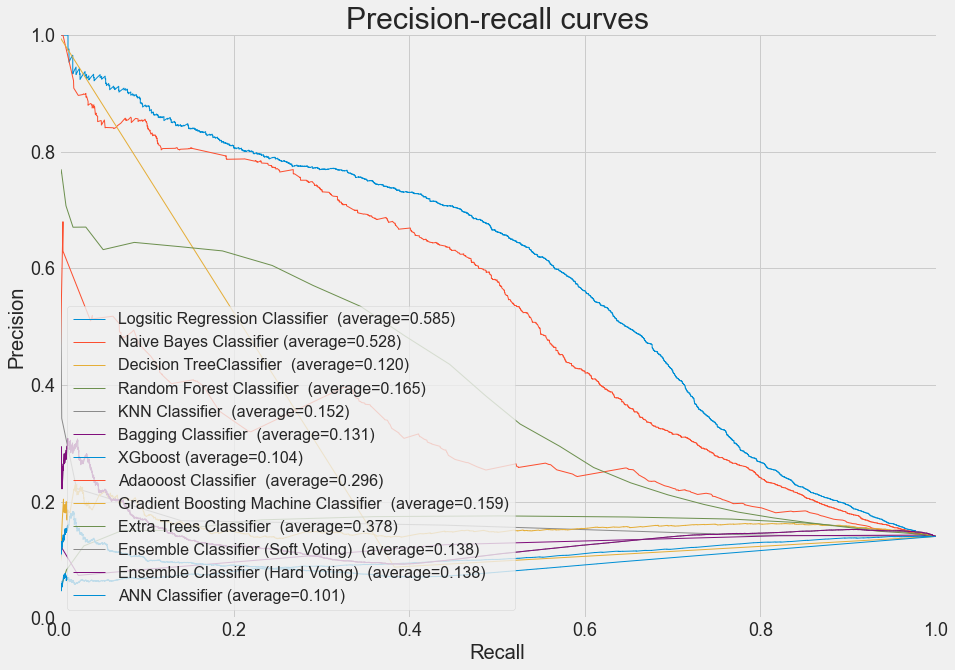

In [275]:
def precision_recall_plot(y_true, y_proba, label=' ', l='-', lw=1.0):
    from sklearn.metrics import precision_recall_curve, average_precision_score
    precision, recall, _ = precision_recall_curve(y_test,
                                                  y_proba[:,1])
    average_precision = average_precision_score(y_test, y_proba[:,1],
                                                     average="micro")
    ax.plot(recall, precision, label='%s (average=%.3f)'%(label,average_precision),
            linestyle=l, linewidth=lw)

f, ax = plt.subplots(figsize=(14,10))
precision_recall_plot(y_test,LR.predict_proba(X_test),label='Logsitic Regression Classifier ',l='-')
precision_recall_plot(y_test,NB.predict_proba(X_test),label='Naive Bayes Classifier',l='-')
precision_recall_plot(y_test,DT.predict_proba(X_test),label='Decision TreeClassifier ',l='-')
precision_recall_plot(y_test,RF.predict_proba(X_test),label='Random Forest Classifier ',l='-')
precision_recall_plot(y_test,KNN.predict_proba(X_test),label='KNN Classifier ',l='-')
                                               
precision_recall_plot(y_test,BG.predict_proba(X_test),label='Bagging Classifier ',l='-')
precision_recall_plot(y_test,XGB.predict_proba(X_test),label='XGboost',l='-')
precision_recall_plot(y_test,ADA.predict_proba(X_test),label='Adaooost Classifier ',l='-')
precision_recall_plot(y_test,GBM.predict_proba(X_test),label='Gradient Boosting Machine Classifier ',l='-')
precision_recall_plot(y_test,ET.predict_proba(X_test),label='Extra Trees Classifier ',l='-')
precision_recall_plot(y_test,ensemble2.predict_proba(X_test),label='Ensemble Classifier (Soft Voting) ',l='-')
precision_recall_plot(y_test,ensemble2.predict_proba(X_test),label='Ensemble Classifier (Hard Voting) ',l='-')
precision_recall_plot(y_test,model[0].predict(X_test),label='ANN Classifier',l='-')



ax.set_xlabel('Recall');
ax.set_ylabel('Precision');
ax.legend(loc="lower left");
ax.grid(True);
ax.set_xlim([0, 1]);
ax.set_ylim([0, 1]);
ax.set_title('Precision-recall curves');
sns.despine();

In [276]:
!pip install scikit-plot

<Figure size 1080x504 with 0 Axes>

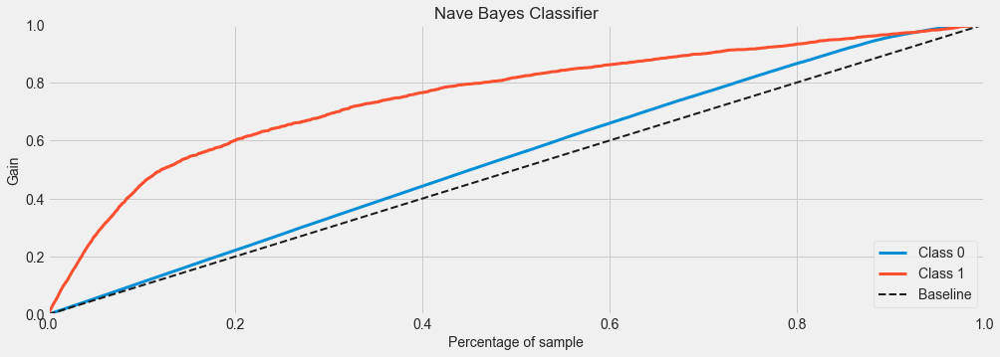

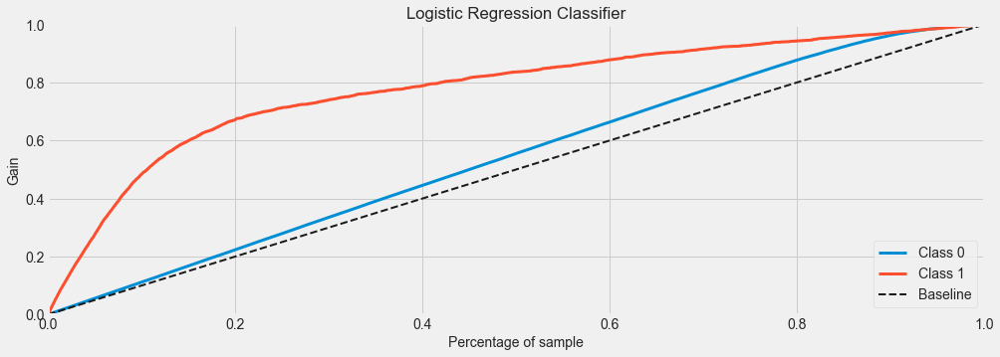

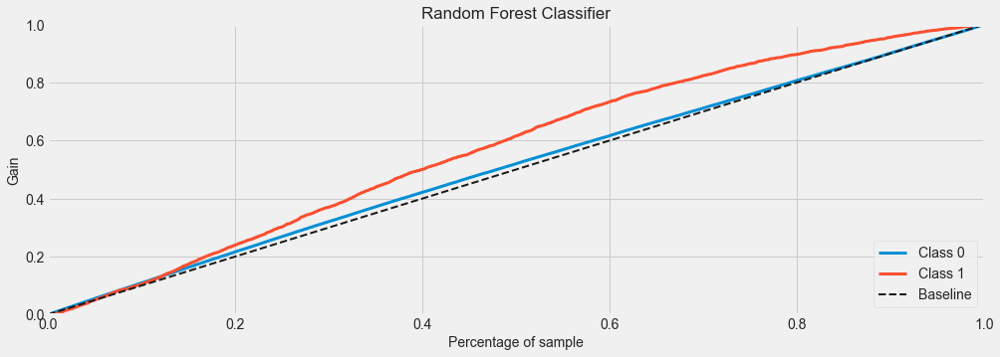

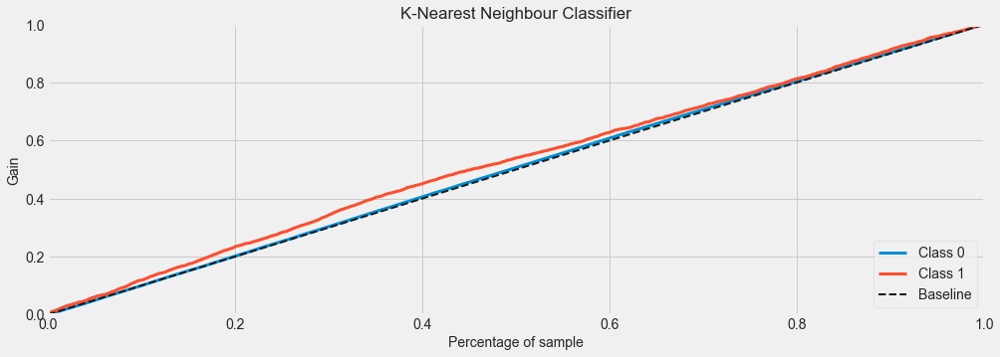

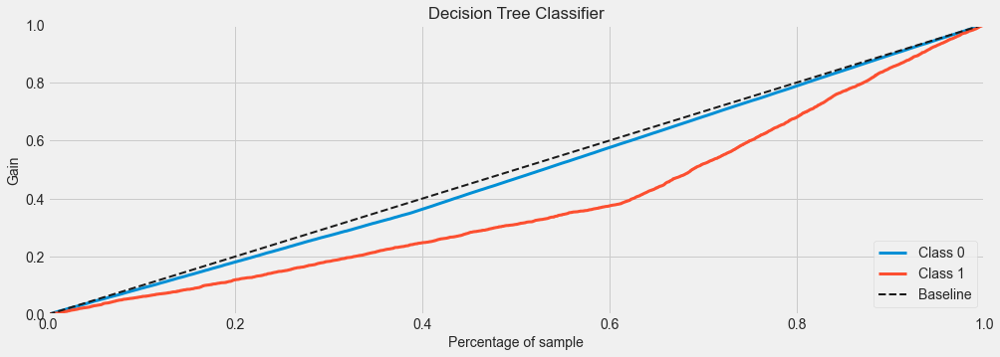

...

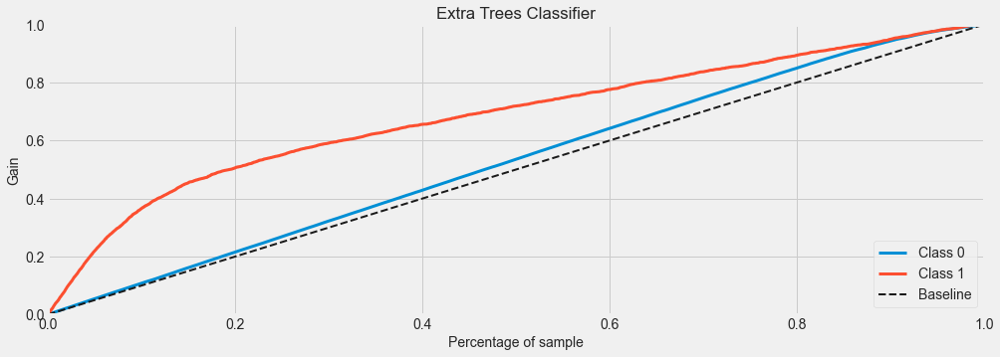

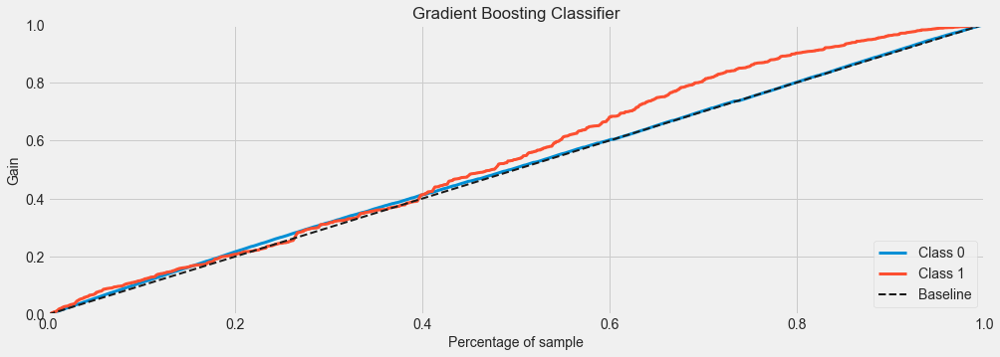

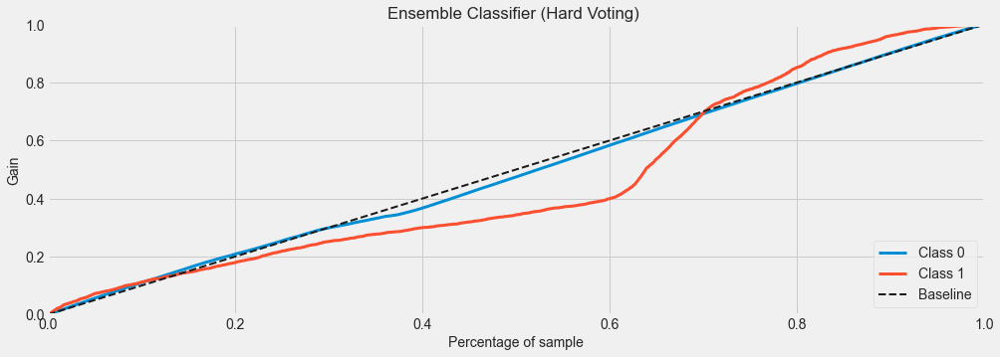

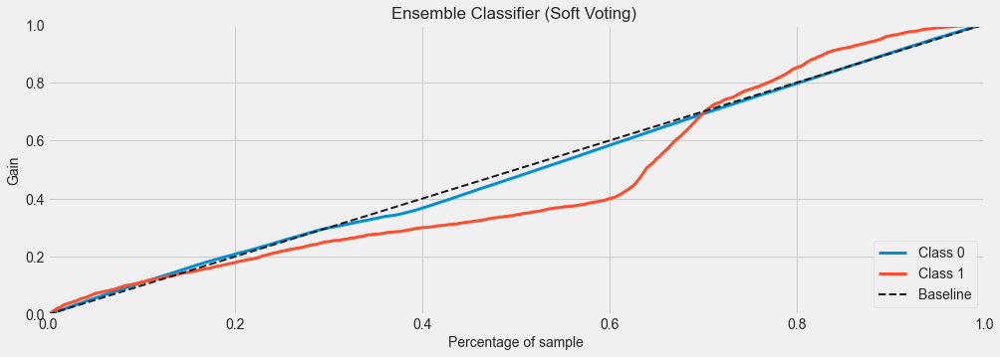

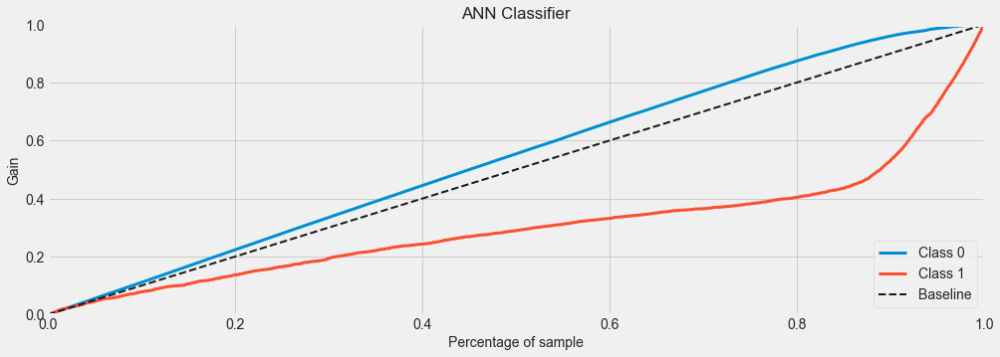

In [277]:
import scikitplot as skplt


plt.figure(figsize=(15,7))
skplt.metrics.plot_cumulative_gain(y_test.values, NB.predict_proba(X_test), title='Nave Bayes Classifier')
plt.show();
skplt.metrics.plot_cumulative_gain(y_test.values, LR.predict_proba(X_test), title='Logistic Regression Classifier')
plt.show();
skplt.metrics.plot_cumulative_gain(y_test.values, RF.predict_proba(X_test), title='Random Forest Classifier')
plt.show();
skplt.metrics.plot_cumulative_gain(y_test.values, KNN.predict_proba(X_test), title='K-Nearest Neighbour Classifier')
plt.show();
skplt.metrics.plot_cumulative_gain(y_test.values, DT.predict_proba(X_test), title='Decision Tree Classifier')
plt.show();
skplt.metrics.plot_cumulative_gain(y_test.values, BG.predict_proba(X_test), title='bagging Classifier')
plt.show();
skplt.metrics.plot_cumulative_gain(y_test.values, ADA.predict_proba(X_test), title='Adaboost Classifier')
plt.show();
skplt.metrics.plot_cumulative_gain(y_test.values, XGB.predict_proba(X_test), title='XGboost Classifier')
plt.show();
skplt.metrics.plot_cumulative_gain(y_test.values, ET.predict_proba(X_test), title='Extra Trees Classifier')
plt.show();
skplt.metrics.plot_cumulative_gain(y_test.values, GBM.predict_proba(X_test), title='Gradient Boosting Classifier')
plt.show();
skplt.metrics.plot_cumulative_gain(y_test.values, ensemble2.predict_proba(X_test), title='Ensemble Classifier (Hard Voting) ')
plt.show();
skplt.metrics.plot_cumulative_gain(y_test.values, ensemble2.predict_proba(X_test), title='Ensemble Classifier (Soft Voting) ')
plt.show();
skplt.metrics.plot_cumulative_gain(y_test.values, models[0].predict_proba(X_test), title='ANN Classifier')
plt.show();

### Casual Discovery

In [53]:
import dowhy
from dowhy import CausalModel

In [59]:
df.head()

,new_id,group_no,postcode,channel,gender,age,num_accounts,acc_tenure,acc_balance,num_options,stmt_pref,annualrpt_pref,promotional_pref,returned_mail_count,rb_flag,block_flag,has_email,has_work_tel,has_home_tel,has_mobile,num_contacts,num_accounts_change_amount,acc_balance_change_amount,num_options_change_amount,num_contacts_change_amount,num_accounts_change_ratio,acc_balance_change_ratio,num_options_change_ratio,postcode_change,adviser_no_change,email_change,home_tel_change,work_tel_change,mobile_tel_change,sav_plan_change,dist_method_change,fni_level_change,stmt_pref_change,annualrpt_pref_change,promotional_pref_change,option_changed,fund_performance,account_growth,account_growth_change,cust_tenure,num_accounts_closed,adviser_change_freq,adviser_change_recency,dealer_change_freq,dealer_change_recency,login_freq,login_recency,call_freq,call_recency,outflow_freq,outflow_recency,outflow_amount,outflow_ratio,adviser_revenue_freq,adviser_revenue_amount,adviser_revenue_recency,adviser_revenue_types,insurance_freq,insurance_amount,insurance_recency,insurance_stopped,insurance_types,sg_freq,sg_amount,sg_recency,salary_scr_freq,salary_scr_amount,salary_scr_recency,spouse_contr_freq,spouse_contr_amount,spouse_contr_recency,personal_contr_freq,personal_contr_amount,personal_contr_recency,rollover_freq,rollover_amount,rollover_recency,contribution_freq,contribution_amount,contribution_recency,sg_stopped,is_directed,churn
0,1107345,10,2640,Other Advisers,F,60.40000,1,9.99000,70760.70000,1,E,N,E,0,0,0,1,0,1,1,3,0,5723.07000,0,0,0.00000,0.08100,0.00000,same,same,same,same,same,same,same,same,same,same,same,same,0,8.70000,78.10000,1.64000,15.37000,0,0,540,0,540,0,540,0,540,0,540,0.00000,0.00000,12,414.83000,0,1,0,0.00000,18,0,0,0,0.00000,18,0,0.00000,18,0,0.00000,18,0,0.00000,18,0,0.00000,18,0,0.00000,18,0,0,0
1,1107345,10,2640,Other Advisers,F,60.91000,1,10.49000,70473.16000,1,E,N,E,0,0,0,1,0,1,1,3,0,2017.76000,0,0,0.00000,0.02900,0.00000,same,same,same,same,same,same,same,same,same,same,same,same,0,2.70000,76.53000,-0.52000,15.88000,0,0,540,0,540,0,540,0,540,0,540,0.00000,0.00000,12,426.53000,0,1,0,0.00000,18,0,0,0,0.00000,18,0,0.00000,18,0,0.00000,18,0,0.00000,18,0,0.00000,18,0,0.00000,18,0,0,0
2,747843,10,3018,CBA Third Party,M,59.63000,1,13.02000,71744.70000,8,M,N,M,0,0,0,0,0,1,0,1,0,-25641.13000,0,0,0.00000,-0.26300,0.00000,same,same,same,same,same,same,same,same,same,same,same,same,0,5.17000,94.35000,-2.06000,15.35000,0,0,540,0,540,0,540,0,540,3,15,30000.00000,0.29486,12,542.37000,0,1,0,0.00000,18,0,0,0,0.00000,18,0,0.00000,18,0,0.00000,18,0,0.00000,18,0,0.00000,18,0,0.00000,18,0,0,0
3,747843,10,3018,CBA Third Party,M,60.13000,1,13.53000,64836.76000,8,M,N,M,0,0,0,0,0,1,0,1,0,-23300.18000,0,0,0.00000,-0.26400,0.00000,same,same,same,same,same,same,same,same,same,same,same,same,0,4.70000,94.54000,-1.08000,15.85000,0,0,540,0,540,0,540,0,540,3,29,27000.00000,0.29400,12,467.65000,0,1,0,0.00000,18,0,0,0,0.00000,18,0,0.00000,18,0,0.00000,18,0,0.00000,18,0,0.00000,18,0,0.00000,18,0,0,0
4,843678,10,5044,Other Advisers,F,49.91000,1,12.23000,81408.55000,4,E,N,E,1,0,0,1,0,1,1,3,0,6276.93000,0,0,0.00000,0.07700,0.00000,same,same,same,same,same,same,same,same,same,same,same,same,0,8.64000,92.95000,-2.68000,15.33000,0,0,540,0,540,0,540,0,540,0,540,0.00000,0.00000,12,479.47000,0,1,0,0.00000,18,0,0,0,0.00000,18,0,0.00000,18,0,0.00000,18,0,0.00000,18,0,0.00000,18,0,0.00000,18,0,0,0


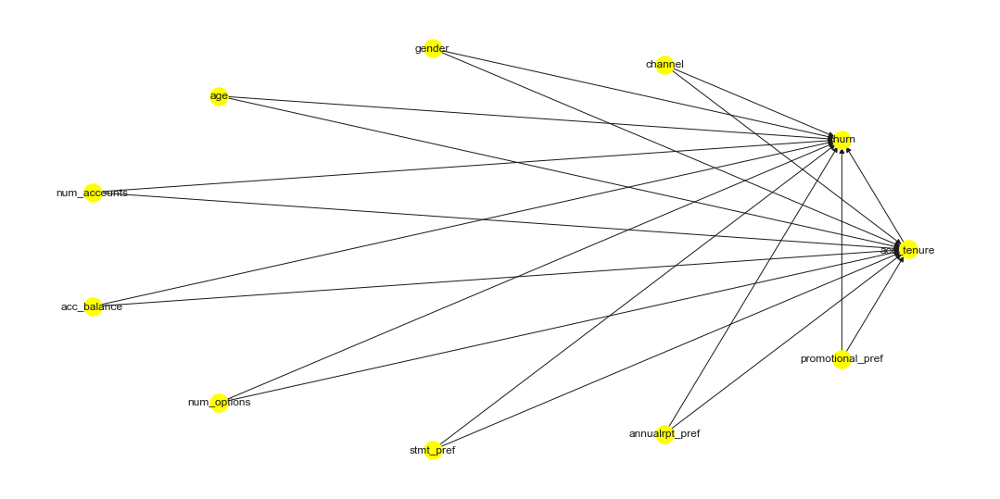

In [72]:
plt.figure(figsize=(17,9))
model= CausalModel(
        data=df,
        treatment=["acc_tenure"],
        outcome=["churn"],
        common_causes=df.columns.tolist()[3:13])
model.view_model()
plt.show();

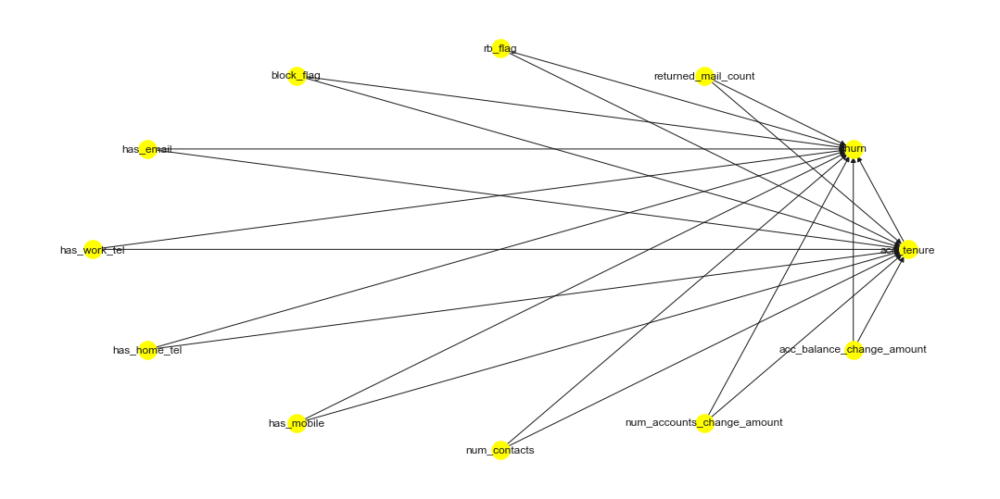

In [71]:
plt.figure(figsize=(17,9))
model= CausalModel(
        data=df,
        treatment=["acc_tenure"],
        outcome=["churn"],
        common_causes=df.columns.tolist()[13:23])
model.view_model()
plt.show();

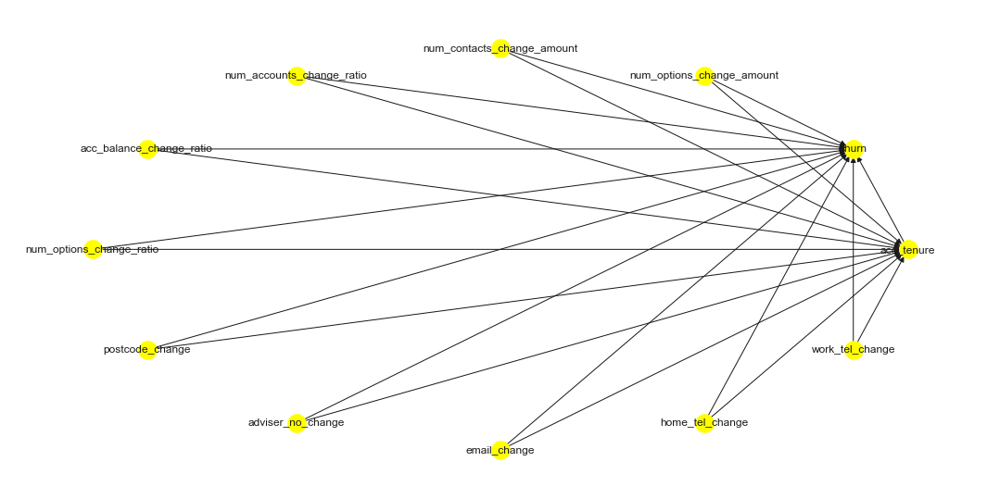

In [74]:
plt.figure(figsize=(17,9))
model= CausalModel(
        data=df,
        treatment=["acc_tenure"],
        outcome=["churn"],
        common_causes=df.columns.tolist()[23:33])
model.view_model()
plt.show();

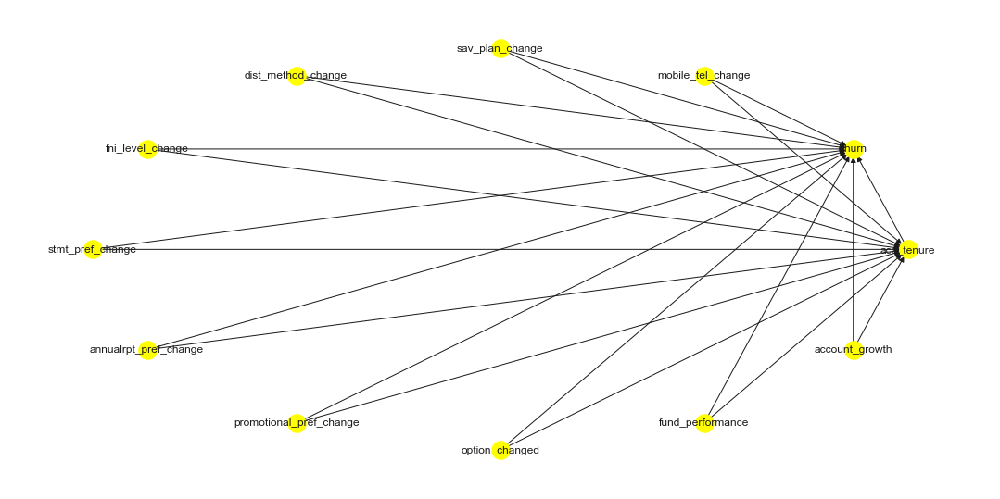

In [76]:
plt.figure(figsize=(17,9))
model= CausalModel(
        data=df,
        treatment=["acc_tenure"],
        outcome=["churn"],
        common_causes=df.columns.tolist()[33:43])
model.view_model()
plt.show();

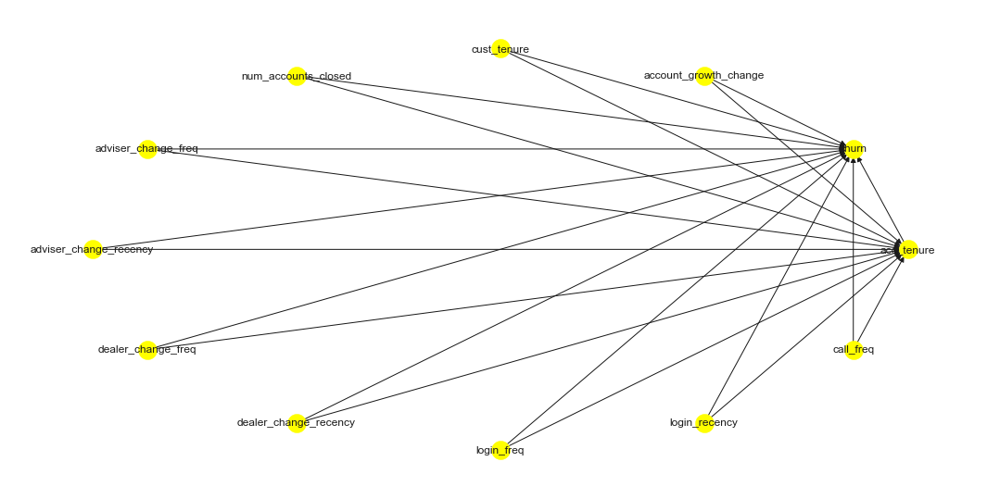

In [77]:
plt.figure(figsize=(17,9))
model= CausalModel(
        data=df,
        treatment=["acc_tenure"],
        outcome=["churn"],
        common_causes=df.columns.tolist()[43:53])
model.view_model()
plt.show();

<Figure size 1224x648 with 0 Axes>

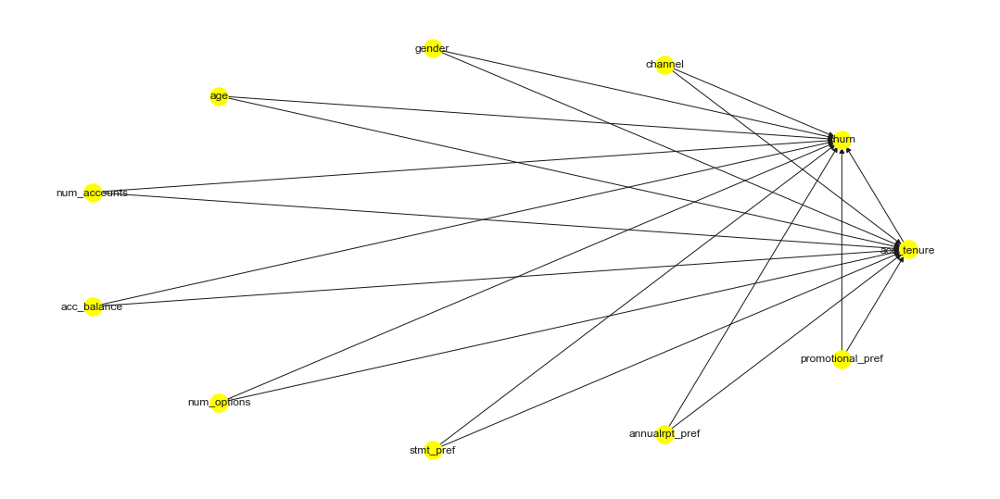

Estimand type: nonparametric-ate

### Estimand : 1
Estimand name: backdoor
Estimand expression:
     d                                                                        
────────────(Expectation(churn|gender,annualrpt_pref,num_options,age,stmt_pref
d[accₜₑₙᵤᵣₑ]                                                                  

                                                    
,channel,acc_balance,promotional_pref,num_accounts))
                                                    
Estimand assumption 1, Unconfoundedness: If U→{acc_tenure} and U→churn then P(churn|acc_tenure,gender,annualrpt_pref,num_options,age,stmt_pref,channel,acc_balance,promotional_pref,num_accounts,U) = P(churn|acc_tenure,gender,annualrpt_pref,num_options,age,stmt_pref,channel,acc_balance,promotional_pref,num_accounts)

### Estimand : 2
Estimand name: iv
No such variable found!

### Estimand : 3
Estimand name: frontdoor
No such variable found!



In [84]:
### Does the account tenure does make churn 
plt.figure(figsize=(17,9))
model= CausalModel(
        data=df,
        treatment=["acc_tenure"],
        outcome=["churn"],
        common_causes=df.columns.tolist()[3:13])
model.view_model()
plt.show();

identified_estimand = model.identify_effect(proceed_when_unidentifiable=True,
                                 method_name="exhaustive-search")
print(identified_estimand)

In [103]:
from sklearn.preprocessing import PolynomialFeatures
from sklearn.ensemble import GradientBoostingClassifier
cml_estimate = model.estimate_effect(identified_estimand,method_name="backdoor.linear_regression",
                                     control_value = 0,
                                     treatment_value = 1,
                                 confidence_intervals=False,
                                method_params={"init_params":{'model_y':GradientBoostingClassifier(),
                                                              'model_t': GradientBoostingClassifier(),
                                                              "model_final":GradientBoostingClassifier()},
                                               "fit_params":{}})
print(cml_estimate)

*** Causal Estimate ***

## Identified estimand
Estimand type: nonparametric-ate

### Estimand : 1
Estimand name: backdoor
Estimand expression:
     d                                                                        
────────────(Expectation(churn|gender,annualrpt_pref,num_options,age,stmt_pref
d[accₜₑₙᵤᵣₑ]                                                                  

                                                    
,channel,acc_balance,promotional_pref,num_accounts))
                                                    
Estimand assumption 1, Unconfoundedness: If U→{acc_tenure} and U→churn then P(churn|acc_tenure,gender,annualrpt_pref,num_options,age,stmt_pref,channel,acc_balance,promotional_pref,num_accounts,U) = P(churn|acc_tenure,gender,annualrpt_pref,num_options,age,stmt_pref,channel,acc_balance,promotional_pref,num_accounts)

## Realized estimand
b: churn~acc_tenure+gender+annualrpt_pref+num_options+age+stmt_pref+channel+acc_balance+promotional_pref+num_accounts
Tar

In [105]:
res_random = model.refute_estimate(identified_estimand, cml_estimate, method_name="random_common_cause")
print(res_random)

Refute: Add a Random Common Cause
Estimated effect:-0.026298998239808746
New effect:-0.02629920820988374



## Model Interpretations

In [51]:
# Training and fitting a Random Forest Model
final_model = XGBClassifier(n_estimators=100,
                                  random_state=0).fit(X_train, y_train)

[13:34:42] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


In [52]:
# Calculating and Displaying importance using the eli5 library
import eli5
from eli5.sklearn import PermutationImportance

perm = PermutationImportance(final_model, random_state=1).fit(X_test,y_test)
eli5.show_weights(perm, feature_names = X_test.columns.tolist())

Using TensorFlow backend.


Weight,Feature
0.0500 ± 0.0020,acc_tenure
0.0282 ± 0.0024,cust_tenure
0.0181 ± 0.0015,acc_balance_change_amount
0.0105 ± 0.0010,fund_performance
0.0102 ± 0.0021,acc_balance_change_ratio
0.0072 ± 0.0027,insurance_recency
0.0046 ± 0.0023,account_growth
0.0037 ± 0.0007,has_mobile_0
0.0034 ± 0.0006,num_contacts_0
0.0023 ± 0.0006,returned_mail_count_0


In [56]:
eli5.show_weights(perm, top=100, feature_names = X_test.columns.tolist())

Weight,Feature
0.0500 ± 0.0020,acc_tenure
0.0282 ± 0.0024,cust_tenure
0.0181 ± 0.0015,acc_balance_change_amount
0.0105 ± 0.0010,fund_performance
0.0102 ± 0.0021,acc_balance_change_ratio
0.0072 ± 0.0027,insurance_recency
0.0046 ± 0.0023,account_growth
0.0037 ± 0.0007,has_mobile_0
0.0034 ± 0.0006,num_contacts_0
0.0023 ± 0.0006,returned_mail_count_0


Interpretation

- The features at the top are most important and at the bottom, the least. For this example, 'Glucose level' is the most important feature which decides whether a person will have diabetes, which also makes sense.
- The number after the ± measures how performance varied from one-reshuffling to the next.
- Some weights are negative. This is because in those cases predictions on the shuffled data were found to be more accurate than the real data.

#### Partial Dependence Plots
The partial dependence plot (short PDP or PD plot) shows the marginal effect one or two features have on the predicted outcome of a machine learning model( J. H. Friedman 2001). PDPs show how a feature affects predictions. PDP can show the relationship between the target and the selected features via 1D or 2D plots.

In [53]:
# training and fitting a Decision Tree
from sklearn.tree import DecisionTreeClassifier
feature_names = [i for i in df.columns]
tree_model = DecisionTreeClassifier(random_state=0).fit(X_train, y_train)

In [68]:
# Let's plot a decision tree source : #https://www.kaggle.com/willkoehrsen/visualize-a-decision-tree-w-python-scikit-learn
# Since there are a lot of attributes, it is difficult to actually make sense of the decision tree graph in this notebook. 
# It is advised to export it as png and view it.

from sklearn import tree
import graphviz

tree_graph = tree.export_graphviz(tree_model, feature_names=X_train.columns.tolist(),filled = True)
graphviz.Source(tree_graph)
from IPython.display import SVG
graph = graphviz.Source(tree_graph)

SVG(graph.pipe(format='svg'))

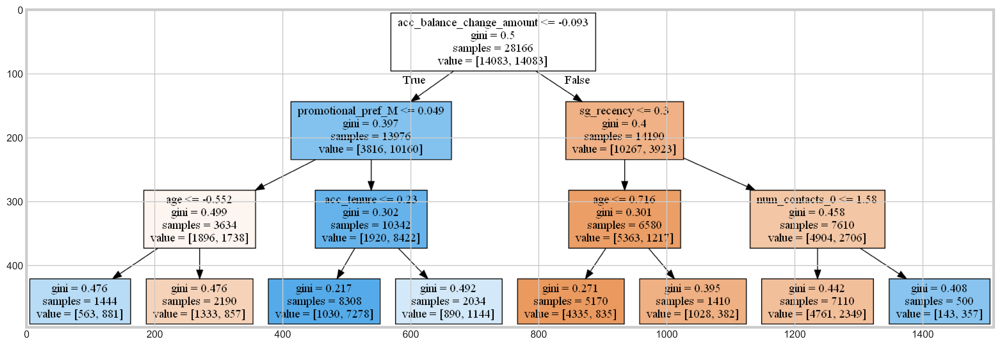

In [86]:
plt.rcParams['figure.dpi'] = 500

# Visualising the decision tree
dt = DecisionTreeClassifier(max_depth = 3, random_state=10)

# fitting the decision tree model on the training set
dt.fit(X_train, y_train)

decision_tree = tree.export_graphviz(dt, out_file='tree.dot', feature_names=X_train.columns, filled=True, max_depth=3)

# converting the dot image to png format
!dot -Tpng tree.dot -o tree.png

#plotting the decision tree
image = plt.imread('tree.png')
plt.figure(figsize=(17,8))
plt.imshow(image);

### PDP plots

In [72]:
features = ['acc_tenure','cust_tenure', 'acc_balance_change_amount','fund_performance', 'acc_balance_change_ratio',
'insurance_recency','account_growth','has_mobile_0','num_contacts_0','returned_mail_count_0','login_recency','num_accounts_1.0','promotional_pref_M',
'postcode_change_changed','has_email_0','stmt_pref_M','account_growth_change','home_tel_change_changed','email_change_same', 'stmt_pref_change_same']

(<Figure size 1080x684 with 2 Axes>,
 {'title_ax': <matplotlib.axes._subplots.AxesSubplot at 0x20f990476d8>,
  'pdp_ax': <matplotlib.axes._subplots.AxesSubplot at 0x210084f6cf8>})

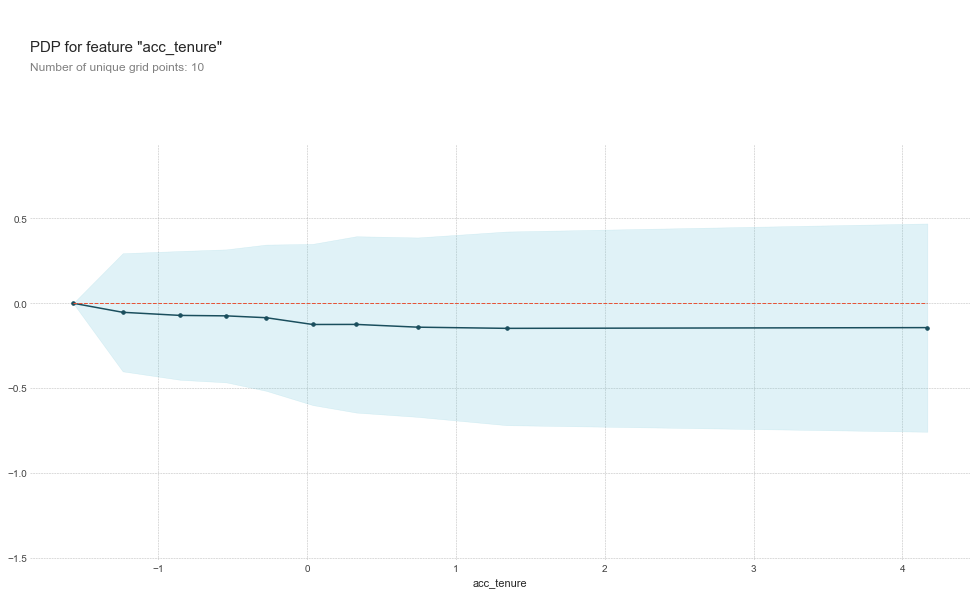

(<Figure size 1080x684 with 2 Axes>,
 {'title_ax': <matplotlib.axes._subplots.AxesSubplot at 0x20f991069b0>,
  'pdp_ax': <matplotlib.axes._subplots.AxesSubplot at 0x20f99040198>})

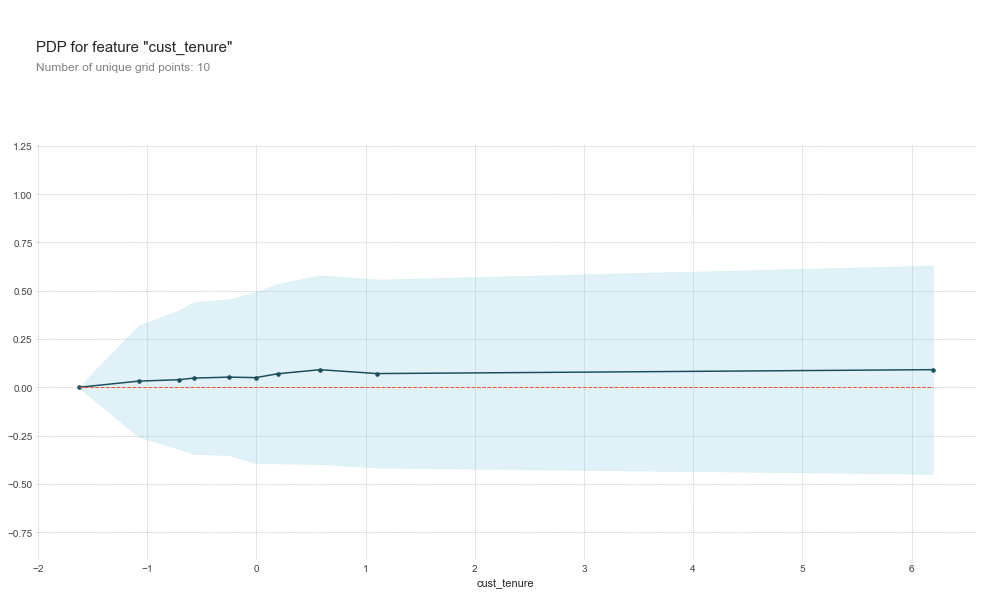

(<Figure size 1080x684 with 2 Axes>,
 {'title_ax': <matplotlib.axes._subplots.AxesSubplot at 0x20f991656d8>,
  'pdp_ax': <matplotlib.axes._subplots.AxesSubplot at 0x20f99106128>})

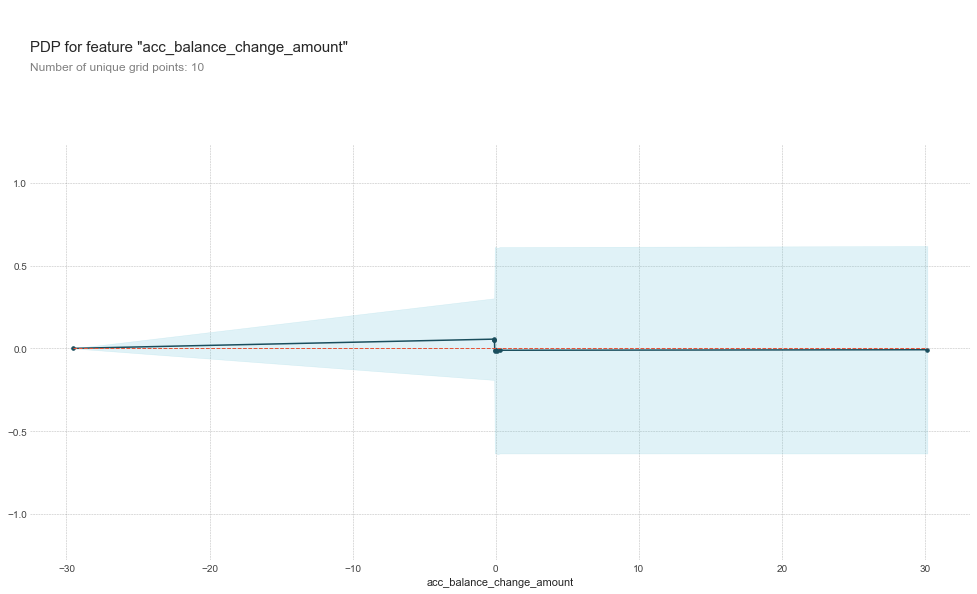

(<Figure size 1080x684 with 2 Axes>,
 {'title_ax': <matplotlib.axes._subplots.AxesSubplot at 0x20fc9023470>,
  'pdp_ax': <matplotlib.axes._subplots.AxesSubplot at 0x20f9915e518>})

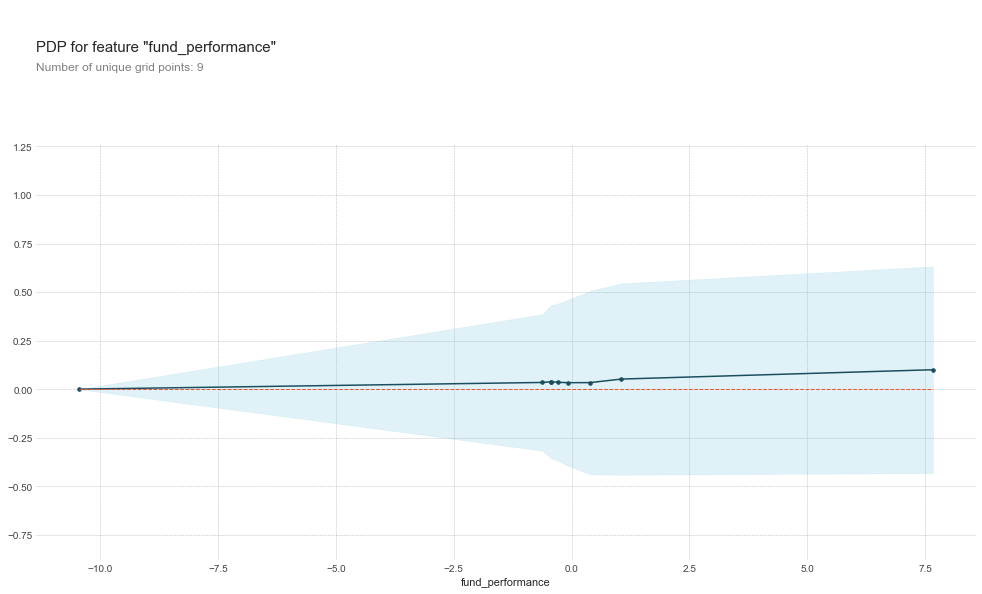

(<Figure size 1080x684 with 2 Axes>,
 {'title_ax': <matplotlib.axes._subplots.AxesSubplot at 0x20fc90d89b0>,
  'pdp_ax': <matplotlib.axes._subplots.AxesSubplot at 0x20f991997f0>})

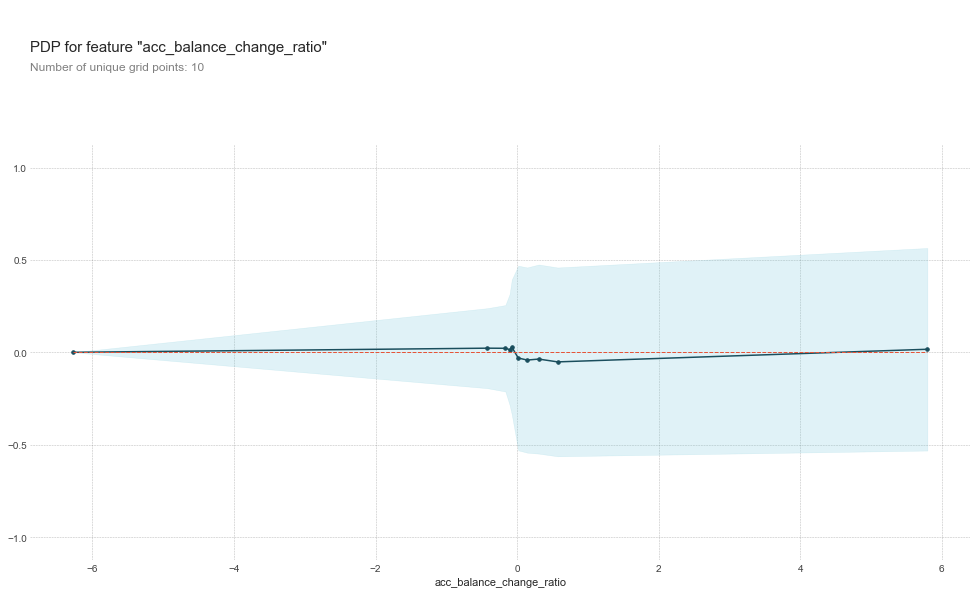

(<Figure size 1080x684 with 2 Axes>,
 {'title_ax': <matplotlib.axes._subplots.AxesSubplot at 0x20fc91cb278>,
  'pdp_ax': <matplotlib.axes._subplots.AxesSubplot at 0x20fc91abb38>})

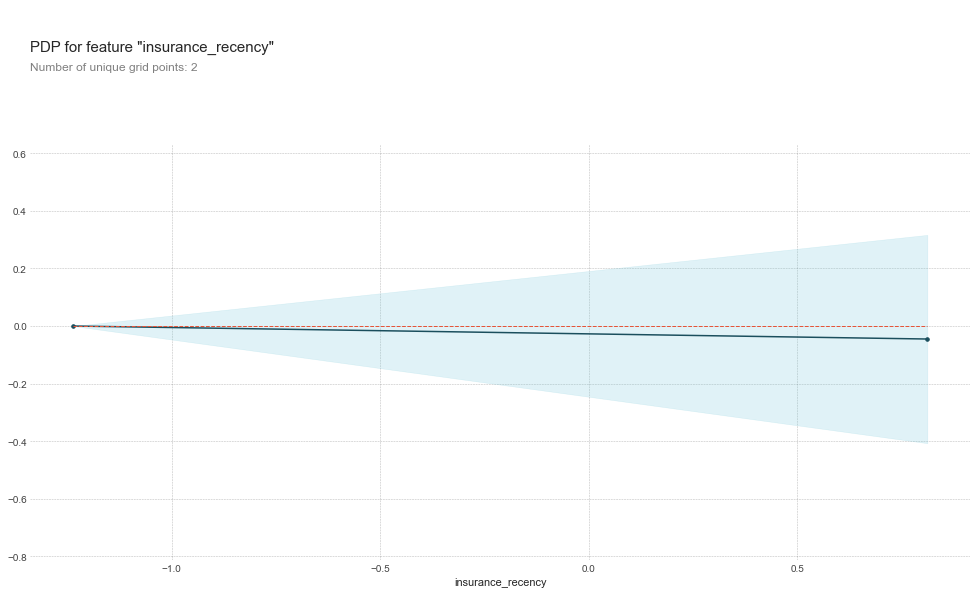

(<Figure size 1080x684 with 2 Axes>,
 {'title_ax': <matplotlib.axes._subplots.AxesSubplot at 0x20fc94a39e8>,
  'pdp_ax': <matplotlib.axes._subplots.AxesSubplot at 0x20fc94fa860>})

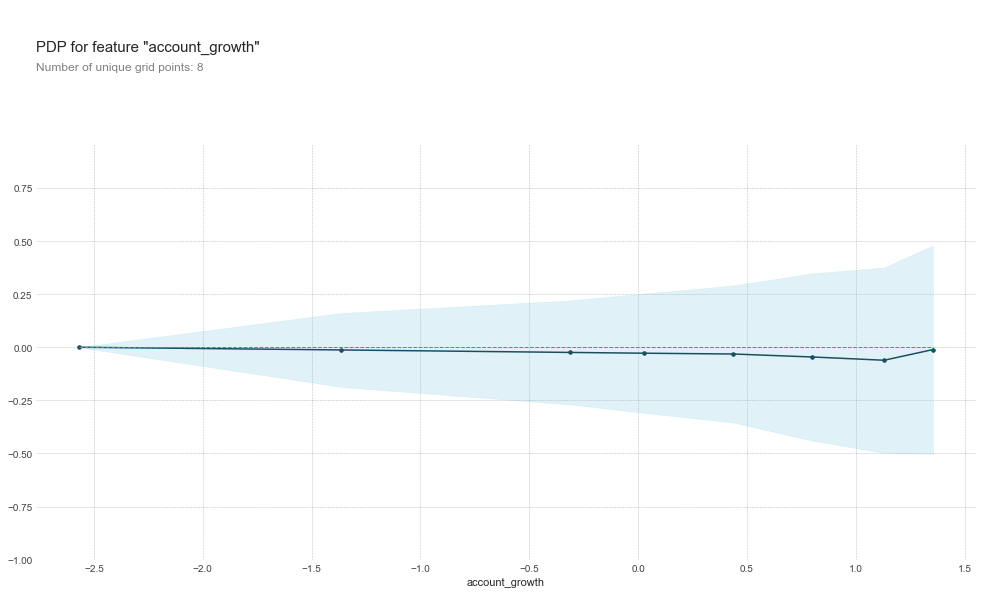

(<Figure size 1080x684 with 2 Axes>,
 {'title_ax': <matplotlib.axes._subplots.AxesSubplot at 0x20fc97851d0>,
  'pdp_ax': <matplotlib.axes._subplots.AxesSubplot at 0x20f85b06e80>})

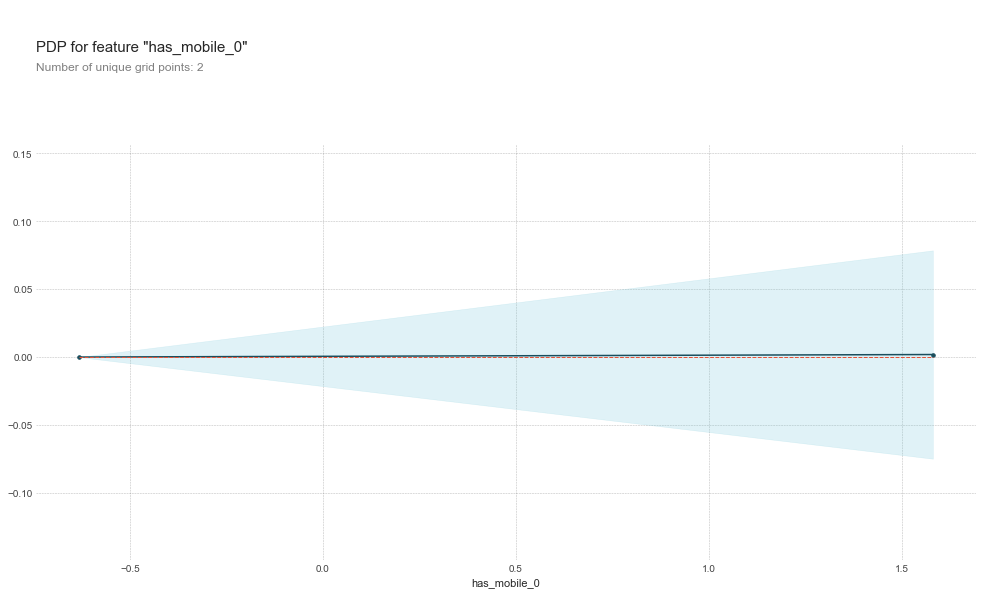

(<Figure size 1080x684 with 2 Axes>,
 {'title_ax': <matplotlib.axes._subplots.AxesSubplot at 0x20fc9f2d898>,
  'pdp_ax': <matplotlib.axes._subplots.AxesSubplot at 0x20f85803588>})

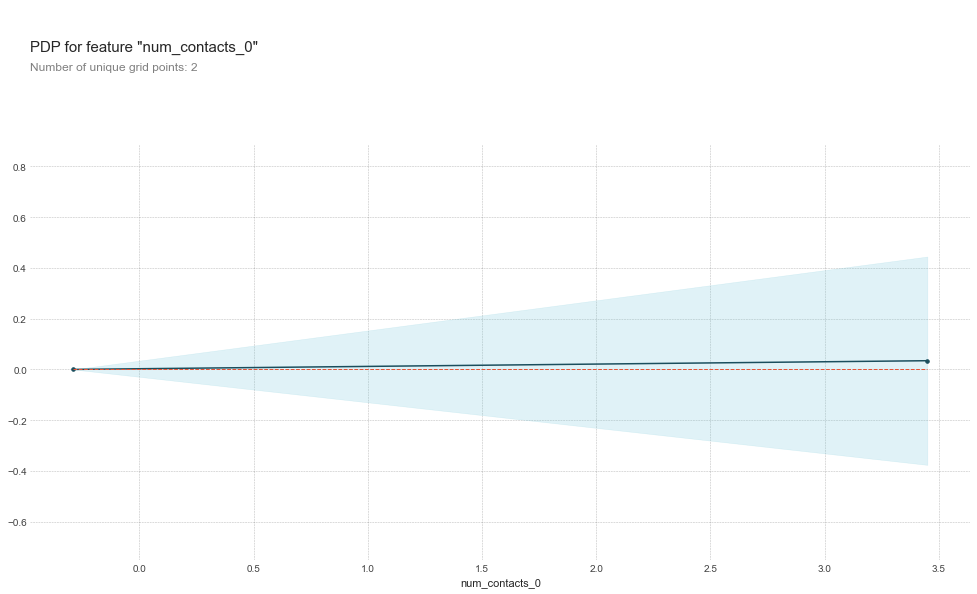

(<Figure size 1080x684 with 2 Axes>,
 {'title_ax': <matplotlib.axes._subplots.AxesSubplot at 0x2100cfbb940>,
  'pdp_ax': <matplotlib.axes._subplots.AxesSubplot at 0x20f86cf1400>})

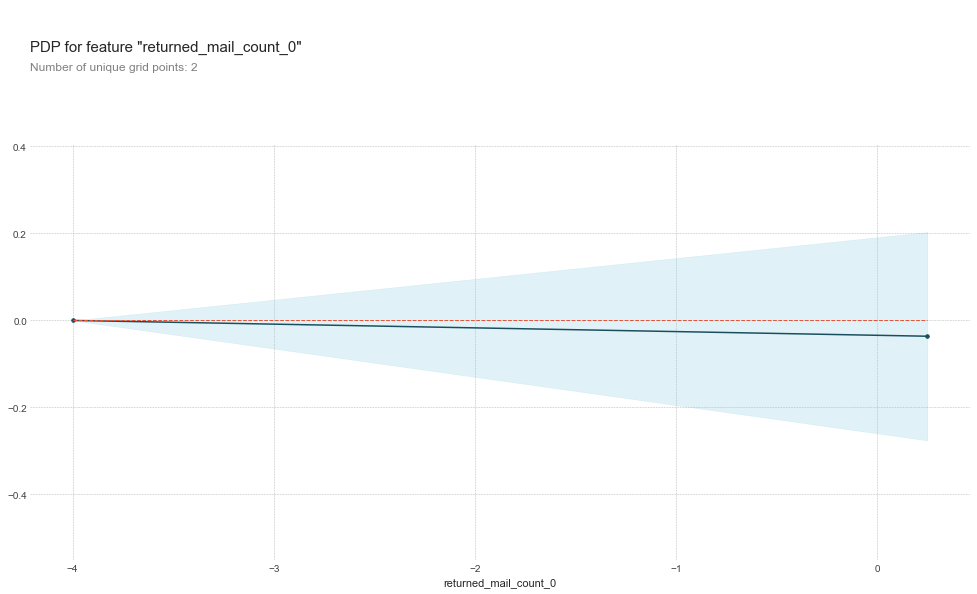

(<Figure size 1080x684 with 2 Axes>,
 {'title_ax': <matplotlib.axes._subplots.AxesSubplot at 0x2100d5408d0>,
  'pdp_ax': <matplotlib.axes._subplots.AxesSubplot at 0x20fc9f46d68>})

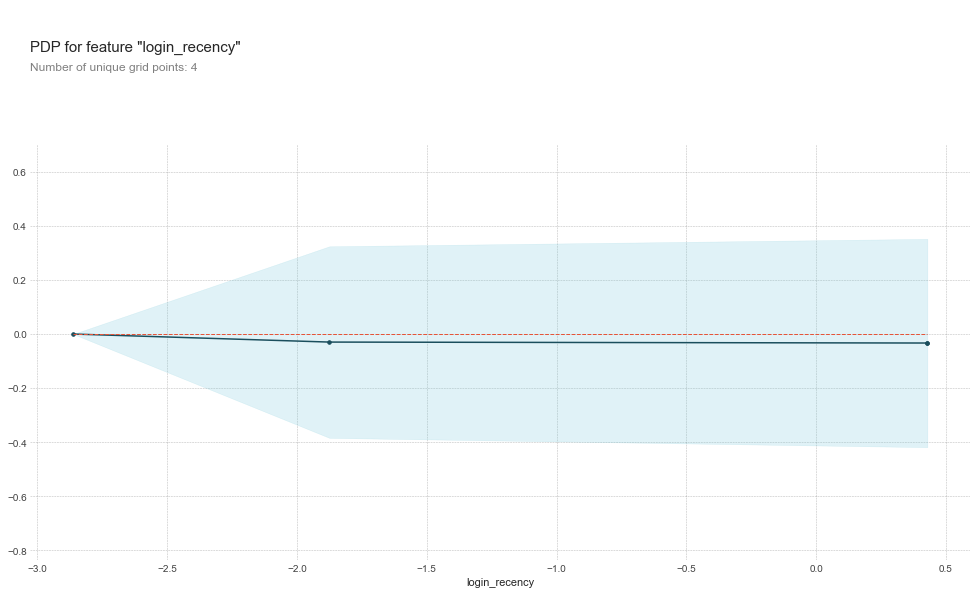

(<Figure size 1080x684 with 2 Axes>,
 {'title_ax': <matplotlib.axes._subplots.AxesSubplot at 0x2100d594da0>,
  'pdp_ax': <matplotlib.axes._subplots.AxesSubplot at 0x2100d5b1160>})

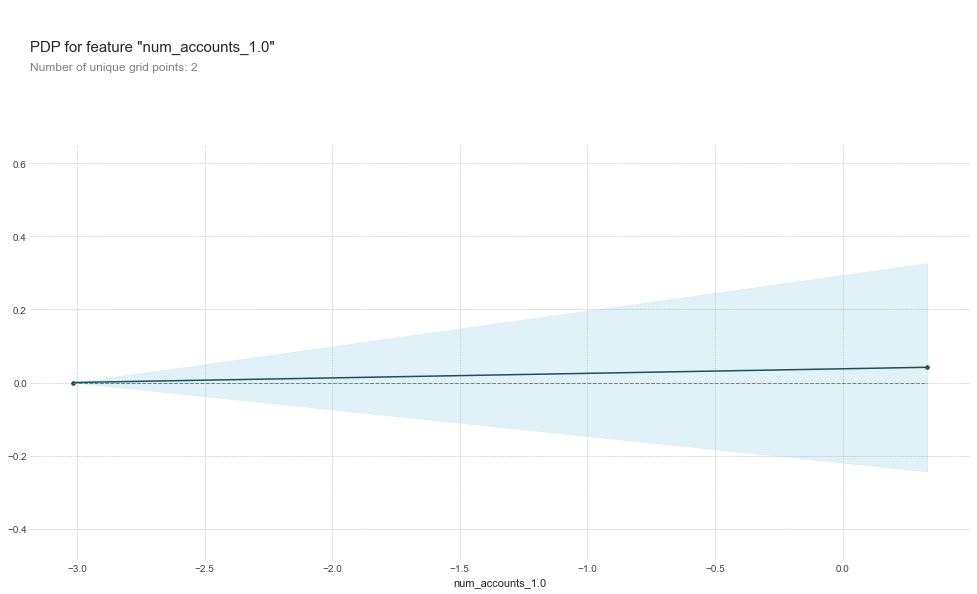

(<Figure size 1080x684 with 2 Axes>,
 {'title_ax': <matplotlib.axes._subplots.AxesSubplot at 0x2100d674518>,
  'pdp_ax': <matplotlib.axes._subplots.AxesSubplot at 0x2100d5b1a20>})

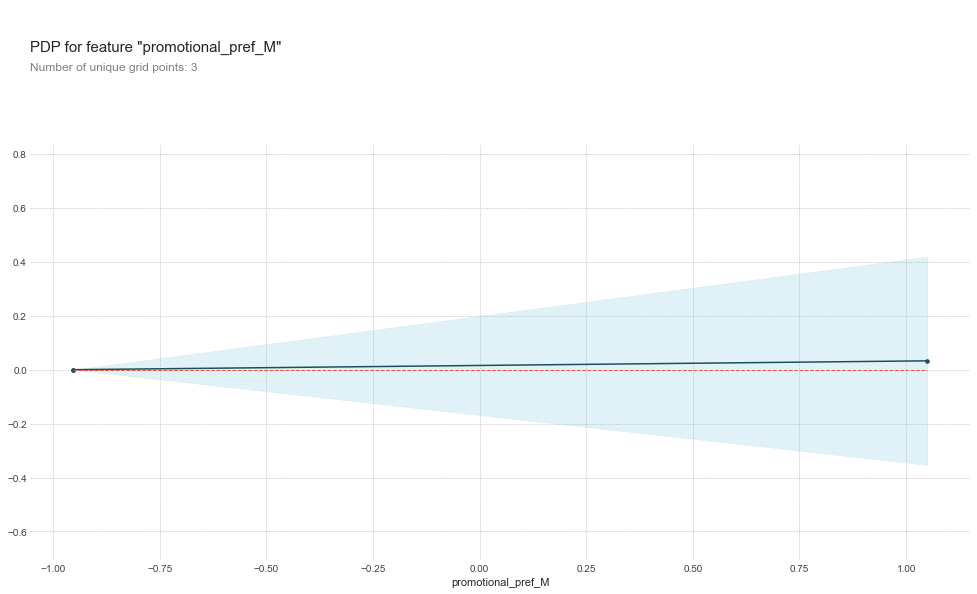

(<Figure size 1080x684 with 2 Axes>,
 {'title_ax': <matplotlib.axes._subplots.AxesSubplot at 0x2100d71eac8>,
  'pdp_ax': <matplotlib.axes._subplots.AxesSubplot at 0x2100d594198>})

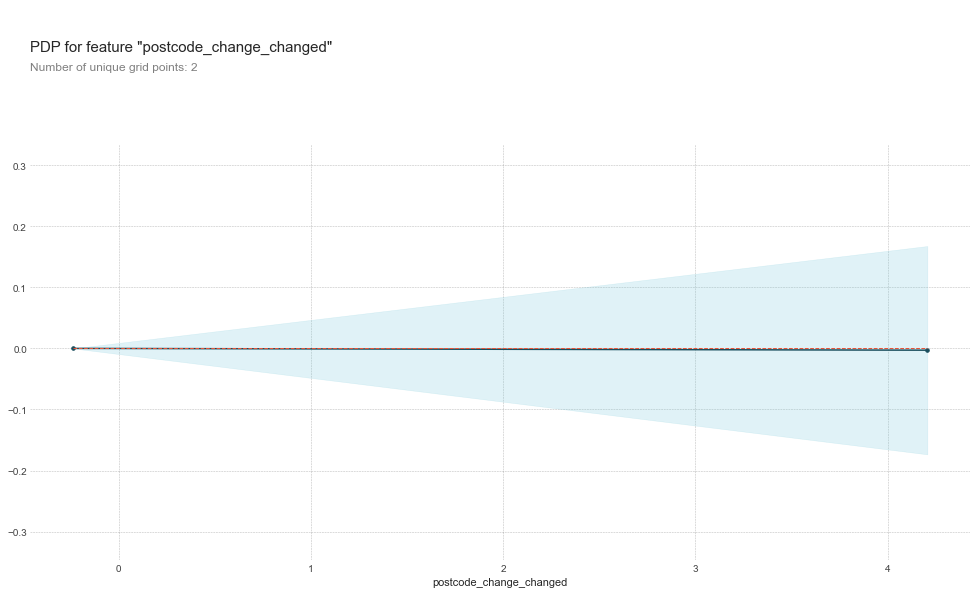

(<Figure size 1080x684 with 2 Axes>,
 {'title_ax': <matplotlib.axes._subplots.AxesSubplot at 0x2100e183630>,
  'pdp_ax': <matplotlib.axes._subplots.AxesSubplot at 0x2100d78bcc0>})

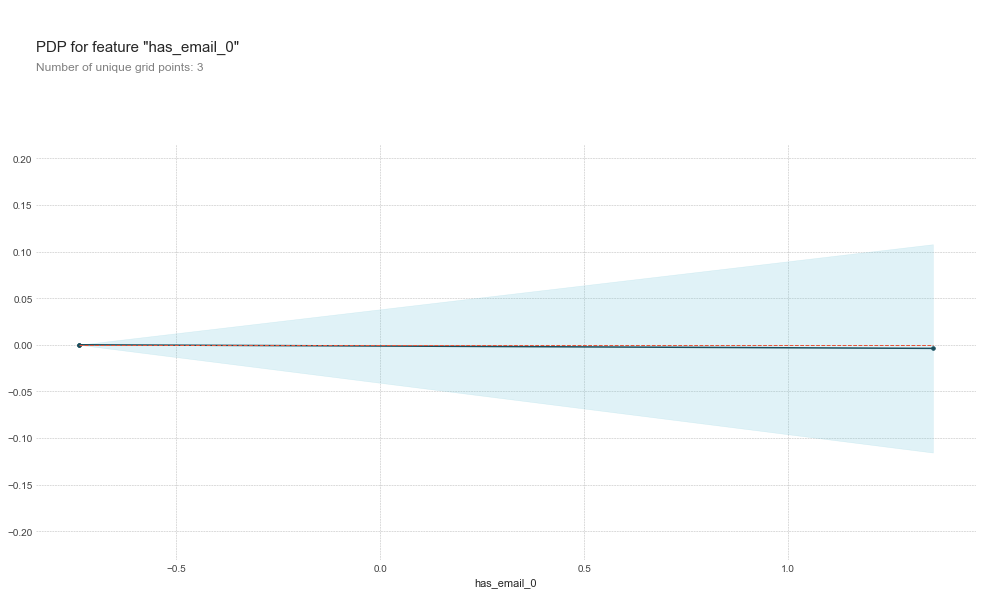

(<Figure size 1080x684 with 2 Axes>,
 {'title_ax': <matplotlib.axes._subplots.AxesSubplot at 0x2100e1c2c18>,
  'pdp_ax': <matplotlib.axes._subplots.AxesSubplot at 0x2100d6c3b38>})

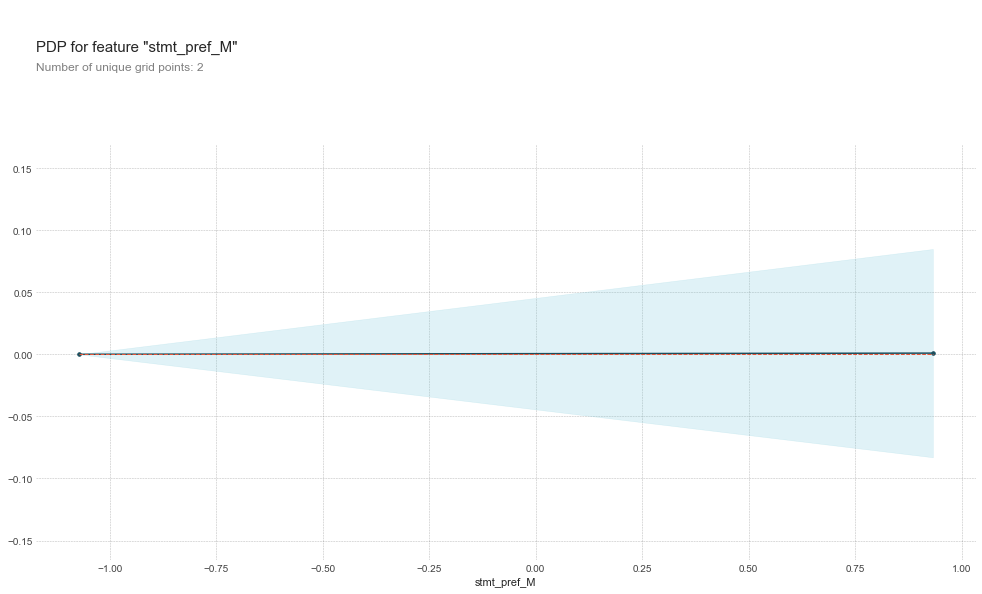

(<Figure size 1080x684 with 2 Axes>,
 {'title_ax': <matplotlib.axes._subplots.AxesSubplot at 0x2100d6e0160>,
  'pdp_ax': <matplotlib.axes._subplots.AxesSubplot at 0x2100d754eb8>})

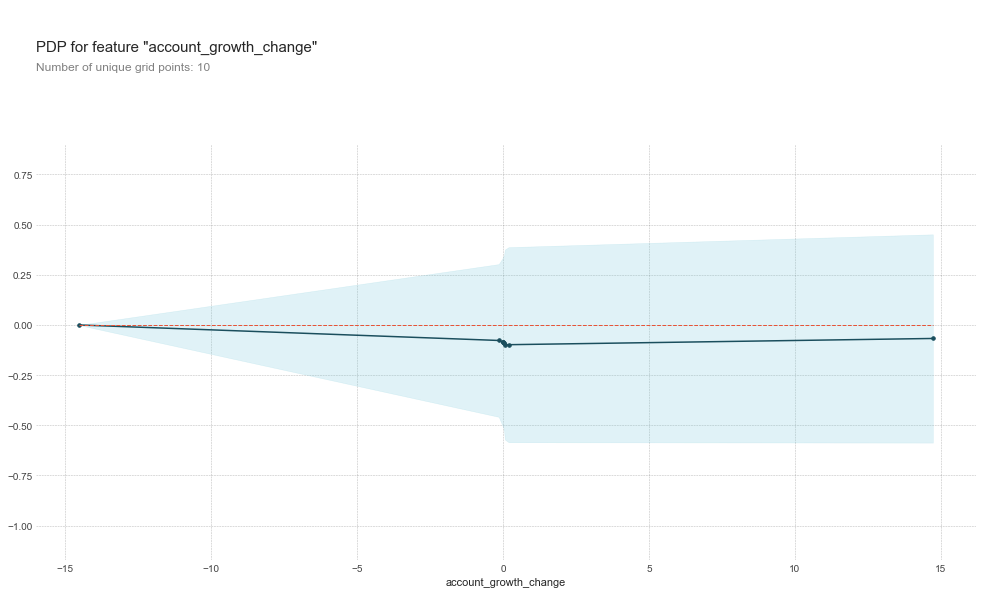

(<Figure size 1080x684 with 2 Axes>,
 {'title_ax': <matplotlib.axes._subplots.AxesSubplot at 0x2100d540eb8>,
  'pdp_ax': <matplotlib.axes._subplots.AxesSubplot at 0x2100d587f28>})

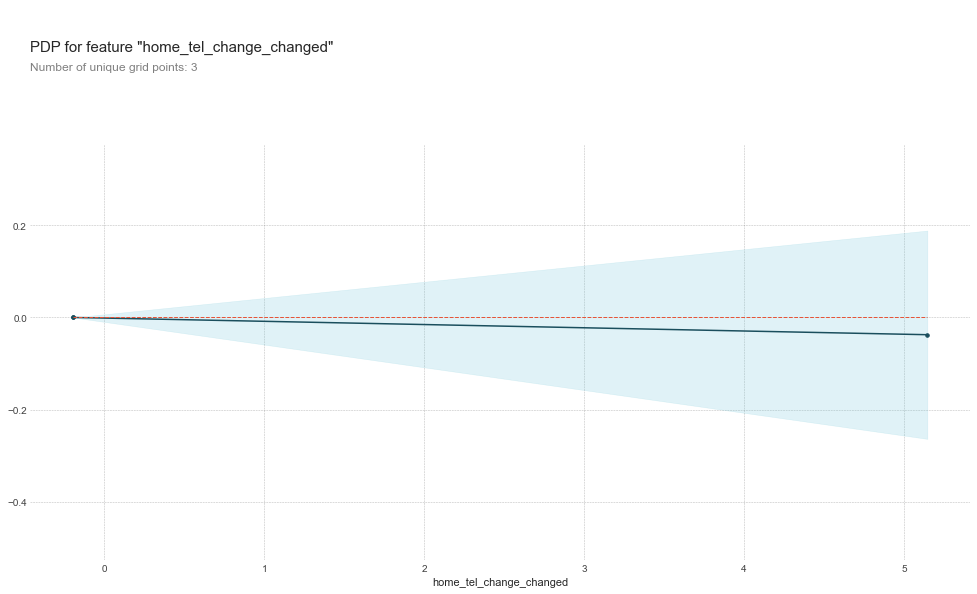

(<Figure size 1080x684 with 2 Axes>,
 {'title_ax': <matplotlib.axes._subplots.AxesSubplot at 0x20f98b4d9e8>,
  'pdp_ax': <matplotlib.axes._subplots.AxesSubplot at 0x20f98b01780>})

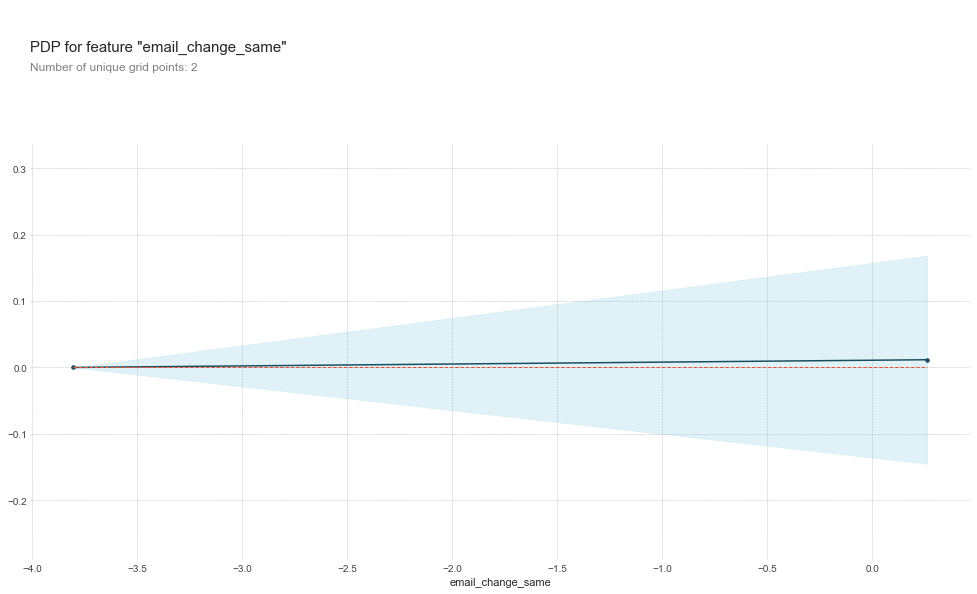

(<Figure size 1080x684 with 2 Axes>,
 {'title_ax': <matplotlib.axes._subplots.AxesSubplot at 0x20f97fac320>,
  'pdp_ax': <matplotlib.axes._subplots.AxesSubplot at 0x20f97e38978>})

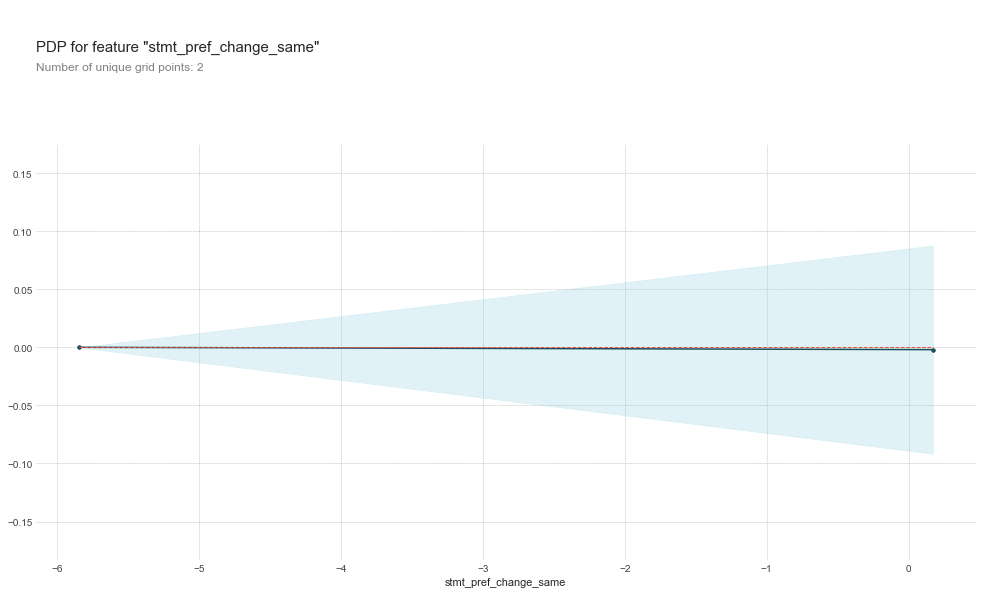

In [76]:
from pdpbox import pdp, get_dataset, info_plots


for feature_name in features:
    # Create the data that we will plot
    pdp_goals = pdp.pdp_isolate(model=tree_model, dataset=X_test, model_features=X_train.columns.tolist(), feature=feature_name);

    # plot it
    pdp.pdp_plot(pdp_goals, feature_name);
    plt.show();

Interpretation

The Y-axis represents the change in prediction from what it would be predicted at the baseline or leftmost value.
Blue area denotes the confidence interval


### SHAP Values
SHAP which stands for SHapley Additive exPlanation, helps to break down a prediction to show the impact of each feature. It is based on Shapley values, a technique used in game theory to determine how much each player in a collaborative game has contributed to its success¹. Normally, getting the trade-off between accuracy and interpretability just right can be a difficult balancing act but SHAP values can deliver both.

SHAP values interpret the impact of having a certain value for a given feature in comparison to the prediction we’d make if that feature took some baseline value.

Shap values show how much a given feature changed our prediction (compared to if we made that prediction at some baseline value of that feature). Let’s say we wanted to know what was the prediction when the insulin level was 150 instead of some fixed baseline no. If we are able to answer this, we could perform the same steps for other features as follows:

In [78]:
import shap  # package used to calculate Shap values
row_to_show = 10
data_for_prediction = X_test.iloc[row_to_show]  # use 1 row of data here. Could use multiple rows if desired
data_for_prediction_array = data_for_prediction.values.reshape(1, -1)

tree_model.predict_proba(data_for_prediction_array)



# Create object that can calculate shap values
explainer = shap.TreeExplainer(tree_model)

# Calculate Shap values
shap_values = explainer.shap_values(data_for_prediction)
shap.initjs()
shap.force_plot(explainer.expected_value[1], shap_values[1], data_for_prediction)

array([[1., 0.]])

###  Interpretation

The above explanation shows features each contributing to push the model output from the base value (the average model output over the training dataset we passed) to the model output. Features pushing the prediction higher are shown in red, those pushing the prediction lower are in blue


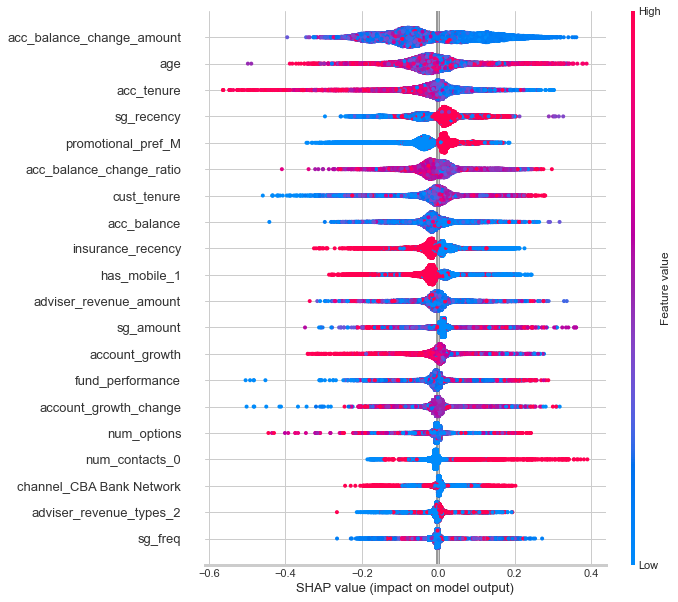

In [79]:

# Create object that can calculate shap values
explainer = shap.TreeExplainer(tree_model)

# calculate shap values. This is what we will plot.
# Calculate shap_values for all of val_X rather than a single row, to have more data for plot.
shap_values = explainer.shap_values(X_test)

# Make plot. Index of [1] is explained in text below.
shap.summary_plot(shap_values[1],X_test)

For every dot:

- Vertical location shows what feature it is depicting
- Color shows whether that feature was high or low for that row of the dataset
- Horizontal location shows whether the effect of that value caused a higher or lower prediction.


In [ ]:
import time
trained_models = [] #  keep track of all details for models we train

def train_model(model, X_train, X_test, y_train, y_test): 

    pipe = Pipeline([('scaler', StandardScaler()),('clf', model["clf"])])
    start_time = time.time()
    pipe.fit(X_train, y_train)
    train_time = time.time() - start_time

    train_accuracy =  pipe.score(X_train, y_train)
    test_accuracy = pipe.score(X_test, y_test) 
    model_details = {"name": model["name"], "train_accuracy":train_accuracy, "test_accuracy":test_accuracy, "train_time": train_time, "model": pipe}
    return model_details
     
        
models = [
          {"name": "Naive Bayes", "clf": GaussianNB()},
          {"name": "logistic regression", "clf": LogisticRegression()}, 
          {"name": "Decision Tree", "clf": DecisionTreeClassifier()},
    
    
          {"name": "Random Forest", "clf": RandomForestClassifier(n_estimators=100)},
          {"name": "Adaboost", "clf": AdaBoostClassifier(n_estimators=100)},
          {"name": "Extra Trees", "clf": ExtraTreesClassifier(n_estimators=100)},
          {"name": "Gradient Boosting", "clf": GradientBoostingClassifier(n_estimators=100)}, 
          {"name": "Xgboost", "clf": XGBClassifier()},
          {"name": "Stack Ensemble (Hard Voting)", "clf": VotingClassifier(estimators=[('Logistic Regression', LogisticRegression(random_state = random_state)),
                                              ('Naive Bayes', GaussianNB()),
                                              ('RF', RandomForestClassifier(random_state=random_state)),
                                              ('KNN', KNeighborsClassifier()),
                                              ('Decision Tree', DecisionTreeClassifier(random_state=random_state))], 
                                               voting='hard')},
          {"name": "Stack Ensemble (Soft Voting)", "clf": VotingClassifier(estimators=[('Logistic Regression', LogisticRegression(random_state = random_state)),
                                              ('Naive Bayes', GaussianNB()),
                                              ('RF', RandomForestClassifier(random_state=random_state)),
                                              ('KNN', KNeighborsClassifier()),
                                              ('Decision Tree', DecisionTreeClassifier(random_state=random_state))], 
                                               voting='soft')}
    
    

]

for model in models:
    model_details = train_model(model, X_train, X_test, y_train, y_test) 
    trained_models.append(model_details)



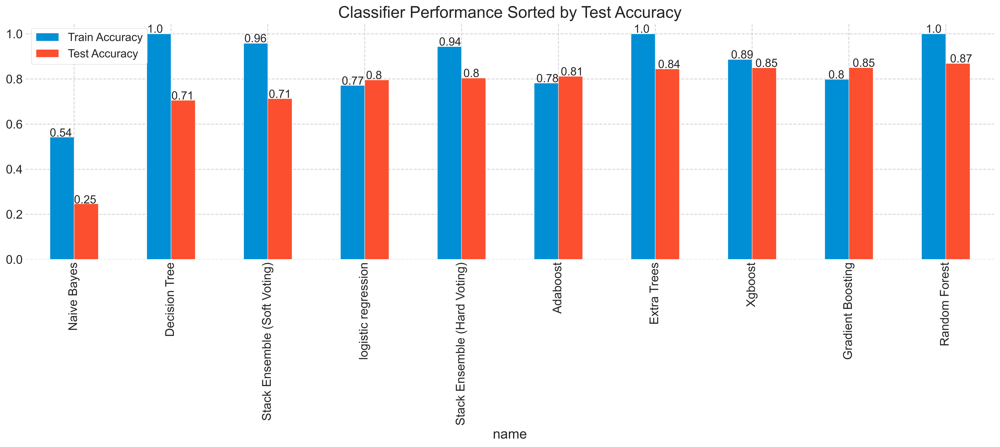

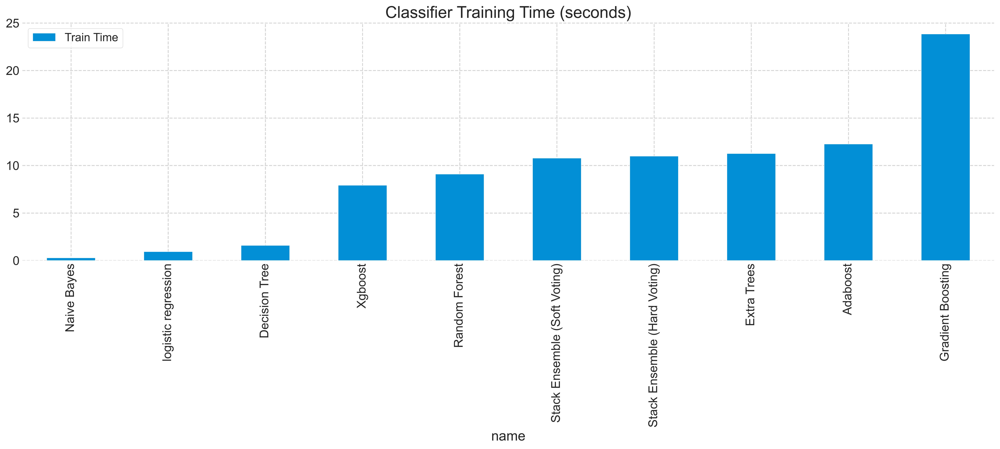

In [94]:
def setup_plot():
    plt.rcParams["axes.grid.axis"] = "y"
    plt.rcParams["axes.grid"] = True
    plt.rcParams["legend.fontsize"] = 14
    plt.rc("grid", linestyle="dashed", color="lightgrey", linewidth=1)
    plt.rcParams["xtick.labelsize"] = 15
    plt.rcParams["ytick.labelsize"] = 15
# visualize accuracy and run time
setup_plot()
model_df = pd.DataFrame(trained_models)
model_df.sort_values("test_accuracy", inplace=True) 
ax = model_df[["train_accuracy","test_accuracy", "name"]].plot(kind="bar", x="name", figsize=(19,5), title="Classifier Performance Sorted by Test Accuracy")
ax.legend(["Train Accuracy", "Test Accuracy"])
for p in ax.patches:
    ax.annotate( str( round(p.get_height(),2) ), (p.get_x() * 1.005, p.get_height() * 1.005))

ax.title.set_size(20)
plt.box(False);

model_df.sort_values("train_time", inplace=True)
ax= model_df[["train_time","name"]].plot(kind="bar", x="name", figsize=(19,5), grid=True, title="Classifier Training Time (seconds)")
ax.title.set_size(20)
ax.legend(["Train Time"])
plt.box(False);

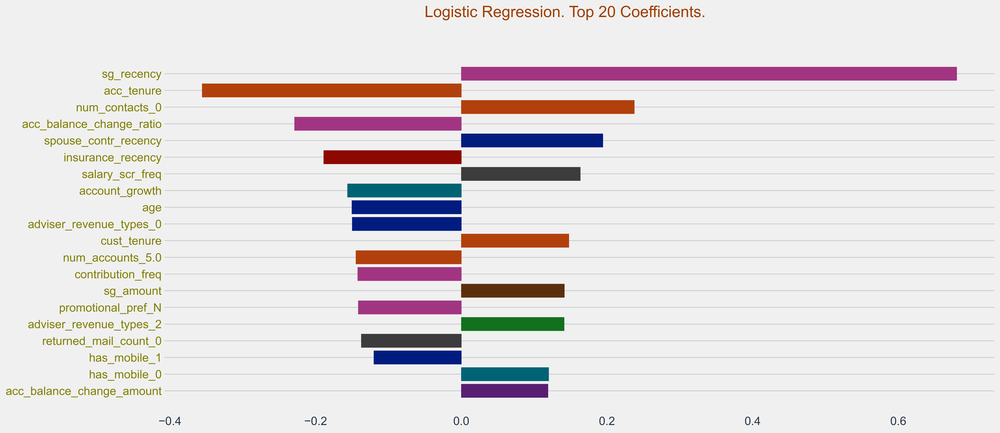

In [101]:
plt.style.context('seaborn-talk')
plt.style.use('fivethirtyeight')
params = {'legend.fontsize': '16',
          'figure.figsize': (17, 8),
         'axes.labelsize': '16',
         'axes.titlesize':'24',
         'xtick.labelsize':'15',
         'ytick.labelsize':'15'}
plt.rcParams.update(params)

plt.rcParams['text.color'] = '#A04000'
plt.rcParams['xtick.color'] = '#283747'
plt.rcParams['ytick.color'] = '#808000'
plt.rcParams['axes.labelcolor'] = '#283747'


logistic_reg_coeff = trained_models[1]["model"]["clf"].coef_
color_list =  sns.color_palette("dark", len(X_train.columns)) 
top_x = 20
logistic_reg_coeff = trained_models[1]["model"]["clf"].coef_[0]
idx = np.argsort(np.abs(logistic_reg_coeff))[::-1] 
lreg_ax = plt.barh(X_train.columns[idx[:top_x]][::-1], logistic_reg_coeff[idx[:top_x]][::-1])

for i,bar in enumerate(lreg_ax):
    bar.set_color(color_list[idx[:top_x][::-1][i]])
    plt.box(False)

lr_title = plt.suptitle("Logistic Regression. Top " + str(top_x) + " Coefficients.", fontsize=20, fontweight="normal")

In [113]:
# Create array of tree based models and plot feature importance scores
tree_models = []
setup_plot()
color_list = sns.color_palette("dark", len(X_train.columns))
top_x = 20  # number of x most important features to show
for model in trained_models:
    if hasattr(model["model"]["clf"], "feature_importances_"):
        tree_models.append(
            {"name": model["name"], "fi": model["model"]["clf"].feature_importances_}
        )


fig, axs = plt.subplots(2, 3, figsize=(17, 15), facecolor="w", edgecolor="k")
fig.subplots_adjust(hspace=0.5, wspace=0.8)
axs = axs.ravel()
for i in range(len(tree_models)):
    feature_importance = tree_models[i]["fi"]
    indices = np.argsort(feature_importance)
    indices = indices[-top_x:]

    bars = axs[i].barh(
        range(len(indices)), feature_importance[indices], color="b", align="center"
    )
    axs[i].set_title(tree_models[i]["name"], fontweight="normal", fontsize=16)

    plt.sca(axs[i])
    plt.yticks(
        range(len(indices)),
        [X_train.columns[j] for j in indices],
        fontweight="normal",
        fontsize=16,
    )

    # print(len(plt.gca().get_yticklabels()), len(indices))
    for i, ticklabel in enumerate(plt.gca().get_yticklabels()):
        ticklabel.set_color(color_list[indices[i]])

    for i, bar in enumerate(bars):
        bar.set_color(color_list[indices[i]])
    plt.box(False);
plt.tight_layout()
plt.show()

Text(0.5, 1.0, 'Decision Tree')

([<matplotlib.axis.YTick at 0x20f99c956a0>,
 [Text(0, 0, 'login_recency'),
  Text(0, 0, 'channel_CBA Bank Network'),
  Text(0, 0, 'adviser_revenue_types_2'),
  Text(0, 0, 'call_recency'),
  Text(0, 0, 'has_mobile_0'),
  Text(0, 0, 'num_contacts_0'),
  Text(0, 0, 'num_options'),
  Text(0, 0, 'insurance_recency'),
  Text(0, 0, 'sg_amount'),
  Text(0, 0, 'fund_performance'),
  Text(0, 0, 'account_growth_change'),
  Text(0, 0, 'acc_balance_change_ratio'),
  Text(0, 0, 'account_growth'),
  Text(0, 0, 'adviser_revenue_amount'),
  Text(0, 0, 'promotional_pref_M'),
  Text(0, 0, 'acc_balance'),
  Text(0, 0, 'cust_tenure'),
  Text(0, 0, 'age'),
  Text(0, 0, 'acc_tenure'),
  Text(0, 0, 'acc_balance_change_amount')])

Text(0.5, 1.0, 'Random Forest')

([<matplotlib.axis.YTick at 0x20f99c86cc0>,
 [Text(0, 0, 'num_contacts_0'),
  Text(0, 0, 'has_mobile_0'),
  Text(0, 0, 'has_email_1'),
  Text(0, 0, 'promotional_pref_M'),
  Text(0, 0, 'adviser_revenue_types_2'),
  Text(0, 0, 'num_options'),
  Text(0, 0, 'sg_freq'),
  Text(0, 0, 'sg_recency'),
  Text(0, 0, 'insurance_recency'),
  Text(0, 0, 'sg_amount'),
  Text(0, 0, 'account_growth_change'),
  Text(0, 0, 'fund_performance'),
  Text(0, 0, 'account_growth'),
  Text(0, 0, 'cust_tenure'),
  Text(0, 0, 'adviser_revenue_amount'),
  Text(0, 0, 'acc_tenure'),
  Text(0, 0, 'age'),
  Text(0, 0, 'acc_balance'),
  Text(0, 0, 'acc_balance_change_ratio'),
  Text(0, 0, 'acc_balance_change_amount')])

Text(0.5, 1.0, 'Adaboost')

([<matplotlib.axis.YTick at 0x20f99ce8208>,
 [Text(0, 0, 'returned_mail_count_0'),
  Text(0, 0, 'has_work_tel_0'),
  Text(0, 0, 'has_home_tel_1'),
  Text(0, 0, 'has_mobile_1'),
  Text(0, 0, 'rollover_amount'),
  Text(0, 0, 'adviser_revenue_types_2'),
  Text(0, 0, 'num_options'),
  Text(0, 0, 'num_contacts_0'),
  Text(0, 0, 'adviser_revenue_amount'),
  Text(0, 0, 'account_growth_change'),
  Text(0, 0, 'account_growth'),
  Text(0, 0, 'outflow_ratio'),
  Text(0, 0, 'sg_amount'),
  Text(0, 0, 'acc_balance'),
  Text(0, 0, 'fund_performance'),
  Text(0, 0, 'acc_balance_change_ratio'),
  Text(0, 0, 'acc_tenure'),
  Text(0, 0, 'age'),
  Text(0, 0, 'cust_tenure'),
  Text(0, 0, 'acc_balance_change_amount')])

Text(0.5, 1.0, 'Extra Trees')

([<matplotlib.axis.YTick at 0x20fb9739128>,
 [Text(0, 0, 'has_mobile_0'),
  Text(0, 0, 'promotional_pref_M'),
  Text(0, 0, 'has_email_1'),
  Text(0, 0, 'has_mobile_1'),
  Text(0, 0, 'adviser_revenue_types_2'),
  Text(0, 0, 'num_options'),
  Text(0, 0, 'account_growth_change'),
  Text(0, 0, 'sg_freq'),
  Text(0, 0, 'fund_performance'),
  Text(0, 0, 'account_growth'),
  Text(0, 0, 'num_contacts_0'),
  Text(0, 0, 'acc_balance_change_ratio'),
  Text(0, 0, 'cust_tenure'),
  Text(0, 0, 'adviser_revenue_amount'),
  Text(0, 0, 'acc_balance_change_amount'),
  Text(0, 0, 'acc_balance'),
  Text(0, 0, 'insurance_recency'),
  Text(0, 0, 'age'),
  Text(0, 0, 'acc_tenure'),
  Text(0, 0, 'sg_recency')])

Text(0.5, 1.0, 'Gradient Boosting')

([<matplotlib.axis.YTick at 0x20fb96e7898>,
 [Text(0, 0, 'sg_freq'),
  Text(0, 0, 'adviser_revenue_types_2'),
  Text(0, 0, 'sg_recency'),
  Text(0, 0, 'has_mobile_0'),
  Text(0, 0, 'has_email_0'),
  Text(0, 0, 'adviser_revenue_amount'),
  Text(0, 0, 'has_mobile_1'),
  Text(0, 0, 'has_email_1'),
  Text(0, 0, 'account_growth'),
  Text(0, 0, 'promotional_pref_M'),
  Text(0, 0, 'returned_mail_count_0'),
  Text(0, 0, 'sg_amount'),
  Text(0, 0, 'cust_tenure'),
  Text(0, 0, 'acc_tenure'),
  Text(0, 0, 'acc_balance_change_ratio'),
  Text(0, 0, 'insurance_recency'),
  Text(0, 0, 'age'),
  Text(0, 0, 'num_contacts_0'),
  Text(0, 0, 'acc_balance'),
  Text(0, 0, 'acc_balance_change_amount')])

Text(0.5, 1.0, 'Xgboost')

([<matplotlib.axis.YTick at 0x20fb90f8048>,
 [Text(0, 0, 'home_tel_change_same'),
  Text(0, 0, 'postcode_change_changed'),
  Text(0, 0, 'age'),
  Text(0, 0, 'promotional_pref_N'),
  Text(0, 0, 'promotional_pref_change_up'),
  Text(0, 0, 'sg_amount'),
  Text(0, 0, 'acc_tenure'),
  Text(0, 0, 'num_accounts_1.0'),
  Text(0, 0, 'acc_balance'),
  Text(0, 0, 'sg_freq'),
  Text(0, 0, 'email_change_same'),
  Text(0, 0, 'adviser_revenue_types_3'),
  Text(0, 0, 'adviser_revenue_types_2'),
  Text(0, 0, 'has_mobile_0'),
  Text(0, 0, 'returned_mail_count_0'),
  Text(0, 0, 'insurance_recency'),
  Text(0, 0, 'has_email_0'),
  Text(0, 0, 'acc_balance_change_amount'),
  Text(0, 0, 'promotional_pref_M'),
  Text(0, 0, 'num_contacts_0')])

## LIME Explainations

In [128]:
trained_models = [] #  keep track of all details for models we train

models = [
          {"name": "Naive Bayes", "clf": GaussianNB()},
          {"name": "logistic regression", "clf": LogisticRegression()}, 
          {"name": "Decision Tree", "clf": DecisionTreeClassifier()},
    
    
          {"name": "Random Forest", "clf": RandomForestClassifier(n_estimators=100)},
          {"name": "Adaboost", "clf": AdaBoostClassifier(n_estimators=100)},
          {"name": "Extra Trees", "clf": ExtraTreesClassifier(n_estimators=100)},
          {"name": "Gradient Boosting", "clf": GradientBoostingClassifier(n_estimators=100)}, 
          {"name": "Xgboost", "clf": XGBClassifier()},
          {"name": "Stack Ensemble (Soft Voting)", "clf": VotingClassifier(estimators=[('Logistic Regression', LogisticRegression(random_state = random_state)),
                                              ('Naive Bayes', GaussianNB()),
                                              ('RF', RandomForestClassifier(random_state=random_state)),
                                              ('KNN', KNeighborsClassifier()),
                                              ('Decision Tree', DecisionTreeClassifier(random_state=random_state))], 
                                               voting='soft')}
    
    

]

for model in models:
    model_details = train_model(model, X_train, X_test, y_train, y_test) 
    trained_models.append(model_details)



[17:43:53] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


In [129]:
from lime.lime_tabular import LimeTabularExplainer
def get_lime_explainer(model, data, labels):
    cat_feat_ix = [
        i
        for i, c in enumerate(data.columns)
        if pd.api.types.is_categorical_dtype(data[c])
    ]
    feat_names = list(data.columns)
    class_names = list(labels.unique())
    scaler = model["model"]["scaler"]
    data = scaler.transform(data)  # scale data to reflect train time scaling
    lime_explainer = LimeTabularExplainer(
        data,
        feature_names=feat_names,
        class_names=class_names,
        categorical_features=cat_feat_ix,
        mode="classification",
    )
    return lime_explainer


def lime_explain(explainer, data, predict_method, num_features):
    explanation = explainer.explain_instance(
        data, predict_method, num_features=num_features
    )
    return explanation


lime_data_explainations = []
lime_metrics = []
lime_explanation_time = []
feat_names = list(X_train.columns)
test_data_index = 6
for current_model in trained_models:
    scaler = current_model["model"]["scaler"]
    scaled_test_data = scaler.transform(X_test)
    predict_method = current_model["model"]["clf"].predict_proba

    start_time = time.time()
    # explain first sample from test data
    lime_explainer = get_lime_explainer(current_model, X_train, y_train)
    explanation = lime_explain(
        lime_explainer, scaled_test_data[test_data_index], predict_method, top_x
    )
    elapsed_time = time.time() - start_time

    ex_holder = {}
    for feat_index, ex in explanation.as_map()[1]:
        ex_holder[feat_names[feat_index]] = ex

    lime_data_explainations.append(ex_holder)
    actual_pred = predict_method(scaled_test_data[test_data_index].reshape(1, -1))
    perc_pred_diff = abs(actual_pred[0][1] - explanation.local_pred[0])
    lime_explanation_time.append({"time": elapsed_time, "model": current_model["name"]})
    lime_metrics.append(
        {
            "lime class1": explanation.local_pred[0],
            "actual class1": actual_pred[0][1],
            "class_diff": round(perc_pred_diff, 3),
            "model": current_model["name"],
        }
    )

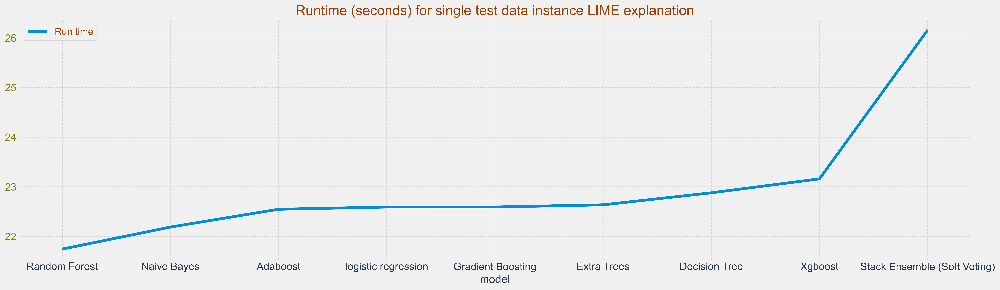

In [133]:
def plot_lime_exp(fig, fig_index, exp_data, title):
    features = list(exp_data.keys())[::-1]
    explanations = list(exp_data.values())[::-1]
    ax = fig.add_subplot(fig_index)
    lime_bar = ax.barh(features, explanations)
    ax.set_title(title, fontsize=20)
    for i, bar in enumerate(lime_bar):
        bar.set_color(color_list[list(X_train.columns).index(features[i])])
        plt.box(False)


fig = plt.figure(figsize=(19, 30))

# Plot lime explanations for trained models
for i, dex in enumerate(lime_data_explainations):
    fig_index = "33" + str(i + 1)
    plot_lime_exp(fig, fig_index, lime_data_explainations[i], trained_models[i]["name"])

plt.suptitle(
    " LIME Explanation for single test data instance.  Top " + str(top_x) + " Features",
    fontsize=20,
    fontweight="normal",
)
fig.tight_layout(rect=[0, 0.03, 1, 0.95])

# Plot run time for explanations
lx_df = pd.DataFrame(lime_explanation_time)
lx_df.sort_values("time", inplace=True)
setup_plot()
lx_ax = lx_df.plot(
    kind="line",
    x="model",
    title="Runtime (seconds) for single test data instance LIME explanation",
    figsize=(22, 6),
)
lx_ax.title.set_size(20)
lx_ax.legend(["Run time"])
plt.box(False)
plt.show();

## Feature Weights

In [159]:
fi_models = []
for i in range(len(tree_models)):
    fi_models.append(tree_models[i]['name'])
    


In [160]:
fi_models

['Decision Tree',
 'Random Forest',
 'Adaboost',
 'Extra Trees',
 'Gradient Boosting',
 'Xgboost']

In [161]:
fi_values = []
for i in range(len(tree_models)):
    fi_values.append(tree_models[i]['fi'])
 

In [ ]:
fi_dataframe = pd.DataFrame(fi_values, columns=X_train.columns)
fi_dataframe['Model'] = fi_models
fi_dataframe = fi_dataframe[['Model', 'age', 'acc_tenure', 'acc_balance', 'num_options',
       'acc_balance_change_amount', 'num_options_change_amount',
       'acc_balance_change_ratio', 'num_options_change_ratio',
       'fund_performance', 'account_growth']]
fi_dataframe = fi_dataframe.T
fi_dataframe.columns = fi_dataframe.iloc[0]
fi_dataframe = fi_dataframe.drop(fi_dataframe.index[0])
fi_dataframe
fi_dataframe.index.name = None

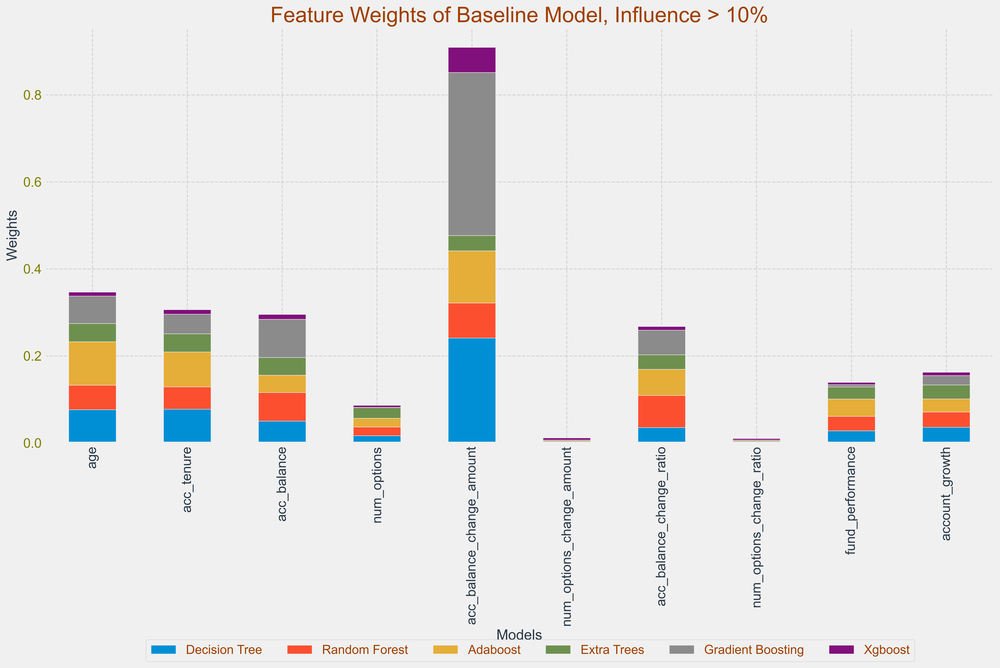

In [190]:
fi_dataframe.plot(kind='bar', stacked=True)
plt.title("Feature Weights of Baseline Model, Influence > 10%")
plt.xlabel("Models")
plt.ylabel("Weights")
plt.legend(loc='center left', bbox_to_anchor=(.1, -0.5), ncol = 6)

plt.show();